In [1]:
import pandas as pd
import numpy as np
import os
import pickle
import json
import torch
from torch import nn
from torch.nn import functional as F
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import glob
import significantdigits as sig
import matplotlib.image as mpimg
import glob
from IPython.display import display
from IPython.display import Image as Im
from PIL import Image
from matplotlib.colors import LogNorm, Normalize
from matplotlib.ticker import MaxNLocator
from matplotlib.colors import TwoSlopeNorm
import random
import nibabel as nib
from nilearn import plotting
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from scipy.stats import ttest_rel
from typing import Tuple
import matplotlib

### Utility Functions

#### Defunct Functions

In [68]:
class ManualBatchNorm2d(torch.nn.Module):
    def __init__(self, num_features, epsilon=1e-5, momentum=0.1, affine=True):
        super(ManualBatchNorm2d, self).__init__()
        self.num_features = num_features
        self.epsilon = epsilon
        self.momentum = momentum
        self.affine = affine
        
        if self.affine:
            # Learnable parameters for scaling (gamma) and bias (beta)
            self.gamma = torch.nn.Parameter(torch.ones(num_features))
            self.beta = torch.nn.Parameter(torch.zeros(num_features))
        else:
            self.register_parameter('gamma', None)
            self.register_parameter('beta', None)
        
        # Running mean and variance for inference
        self.register_buffer('running_mean', torch.zeros(num_features))
        self.register_buffer('running_var', torch.ones(num_features))

    def forward(self, x):

        x = torch.nan_to_num(x)
        # print(x)

        if self.training:
            batch_mean = x.mean([0, 2, 3], keepdim=True)
            batch_var = x.var([0, 2, 3], unbiased=False, keepdim=True)

            # Update running mean and variance
            self.running_mean = self.momentum * self.running_mean + (1 - self.momentum) * batch_mean.squeeze()
            self.running_var = self.momentum * self.running_var + (1 - self.momentum) * batch_var.squeeze()

            mean = batch_mean
            var = batch_var
        else:
            # Use running mean and variance during inference
            mean = self.running_mean.view(1, -1, 1, 1)
            var = self.running_var.view(1, -1, 1, 1)

        # Normalize the input
        x_norm = (x - mean) / torch.sqrt(var + self.epsilon)

        if self.affine:
            # Apply learnable scaling and bias
            x_norm = x_norm * self.gamma.view(1, -1, 1, 1) + self.beta.view(1, -1, 1, 1)
        
        return x_norm

#### Functions In Use

In [208]:
def analyze_embeddings(block_layers, embed_dir, colormap, dict_type=True, v2=False, std_vmin=None, std_vmax=None, mean_vmin=None, mean_vmax=None):
    layers = {}

    for embed in block_layers:
        # print(embed)
        layers[embed] = []
        if v2: 
            embedv2 = f"{embed}_?.pkl"
        else:
            embedv2 = f"{embed}_*"
        # print(embedv2)
        for file in glob.glob(f'{embed_dir}/*{embedv2}'):
            if dict_type: 
                if embed == 'unpool':
                    layers[embed].append(pickle.load(open(file, 'rb'))[embed].squeeze())
                else:
                    layers[embed].append(pickle.load(open(file, 'rb'))[embed].numpy().squeeze())
            else:
                if embed == 'unpool':
                    layers[embed].append(pickle.load(open(file, 'rb')).squeeze())
                else:
                    layers[embed].append(pickle.load(open(file, 'rb')).numpy().squeeze())

        layers[embed] = np.array(layers[embed], dtype=np.float64)

        # print(layers[embed].shape)

    for embed in block_layers:
        fig, axes = plt.subplots(1, 3, figsize=(20,5))
        # print(embed)

        layer_sig = sig.significant_digits(layers[embed], reference=np.mean(layers[embed], axis=0, dtype=np.float64), method=sig.Method.CNH, basis=10, dtype=np.float64)
        # print(layer_sig.shape)
        gc = sns.heatmap(np.mean(layer_sig, axis=0, dtype=np.float64), ax=axes[0], vmin=0, vmax=7, cmap='RdYlGn', cbar=True)
        # gc.axes.get_yaxis().set_visible(False), gc.axes.get_xaxis().set_visible(False)
        gc.set_title(f"Significant Digits\nMax: {np.max(layer_sig):.2f} and Min: {np.min(layer_sig):.2f}")

        layer_std = np.std(layers[embed], axis=0,dtype=np.float64)
        layer_std = np.mean(layer_std, axis=0,dtype=np.float64)
        # layer_std = np.where(layer_std ==0, 0, np.log10(layer_std))
        if std_vmax:
            gc = sns.heatmap(layer_std, ax=axes[1], vmin=std_vmin, vmax=std_vmax, cmap=colormap, norm=LogNorm(vmin=std_vmin, vmax=std_vmax), cbar=True)
        else:
            gc = sns.heatmap(layer_std, ax=axes[1], cmap=colormap, cbar=True)

        # gc.axes.get_yaxis().set_visible(False), gc.axes.get_xaxis().set_visible(False)
        gc.set_title(f"Standard deviation\nMax: {np.max(layer_std,):.2f} and Min: {np.min(layer_std):.2f}");

        layer_mean = np.mean(layers[embed], axis=0,dtype=np.float64)
        norm = TwoSlopeNorm(vmin=layer_mean.min()/2, vcenter=0, vmax=layer_mean.max()/2)

        if mean_vmin:
            norm = TwoSlopeNorm(vmin=mean_vmin, vcenter=0, vmax=mean_vmax)
            gc = sns.heatmap(np.mean(layer_mean, axis=0,dtype=np.float64), ax=axes[2], vmin=mean_vmin, vmax=mean_vmax, norm=norm, cmap='twilight', cbar=True)
        else:
            gc = sns.heatmap(np.mean(layer_mean, axis=0,dtype=np.float64), ax=axes[2], norm=norm, cmap='twilight', cbar=True)

        
        # gc.axes.get_yaxis().set_visible(False), gc.axes.get_xaxis().set_visible(False)
        gc.set_title(f"Mean\nMax: {np.max(layer_mean):.2f} and Min: {np.min(layer_mean):.2f}");
        plt.suptitle(f"{embed}\n", y=1.02, fontsize=15);
        # break

## Brain Unstable Spot Analysis

### Identify What Causes Spot Instability

(10, 71, 32, 32)
(10, 71, 32, 32)


<Figure size 640x480 with 0 Axes>

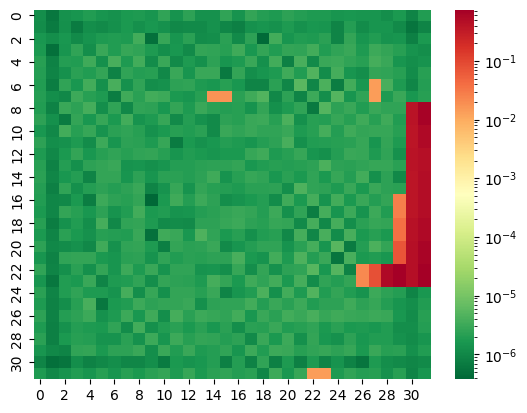

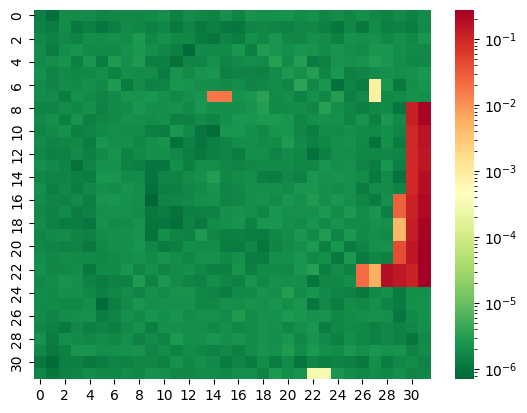

<Figure size 640x480 with 0 Axes>

In [ ]:
# '/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_sagittal2/',


perturbed_idx=[]
for i in range(10):
    for file in glob.glob(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_decode4_v2/outp_unpool_{i}*'):
        perturbed_idx.append(pickle.load(open(file, 'rb')).numpy().squeeze())

perturbed_idx = np.array(perturbed_idx)

print(perturbed_idx.shape)

layer_sig = np.std(perturbed_idx, axis=0)
# layer_sig = sig.significant_digits(perturbed_idx, reference=np.mean(perturbed_idx, axis=0, dtype=np.float64), method=sig.Method.CNH, basis=10, dtype=np.float64)
# # layer_sig = sig.significant_digits(indices, reference=np.mean(indices, axis=0), basis=10)
# norm = TwoSlopeNorm(vmin=layer_sig.min(),  vmax=layer_sig.max())

gc = sns.heatmap(np.mean(layer_sig, axis=0), norm=LogNorm(), cmap='RdYlGn_r', cbar=True)
# gc = sns.heatmap(np.mean(layer_sig, axis=0), vmin=0, vmax=7, cmap='RdYlGn', cbar=True)
plt.figure()

perturbed_idx=[]
for i in range(10):
    for file in glob.glob(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_decode4_v2/outp_prelu0_{i}*'):
        perturbed_idx.append(pickle.load(open(file, 'rb')).numpy().squeeze())

perturbed_idx = np.array(perturbed_idx)

print(perturbed_idx.shape)

layer_sig = np.std(perturbed_idx, axis=0)
# layer_sig = sig.significant_digits(perturbed_idx, reference=np.mean(perturbed_idx, axis=0, dtype=np.float64), method=sig.Method.CNH, basis=10, dtype=np.float64)

gc = sns.heatmap(np.mean(layer_sig, axis=0), vmax=1e-1, norm=LogNorm(), cmap='RdYlGn_r', cbar=True)
# gc = sns.heatmap(np.mean(layer_sig, axis=0), vmin=0, vmax=7, cmap='RdYlGn', cbar=True)

plt.figure()


**Below we see the changing values of the indices across iterations**

(10, 71, 128, 128)
(10, 71, 64, 64)
(10, 71, 32, 32)
(11, 71, 16, 16)


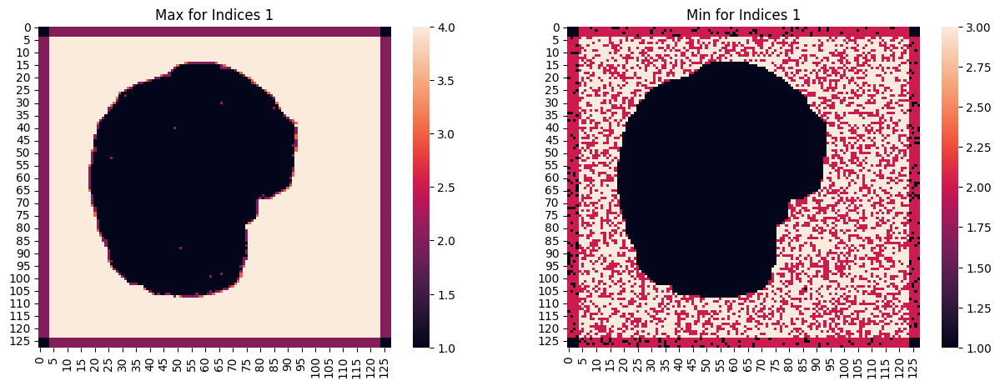

<Figure size 640x480 with 0 Axes>

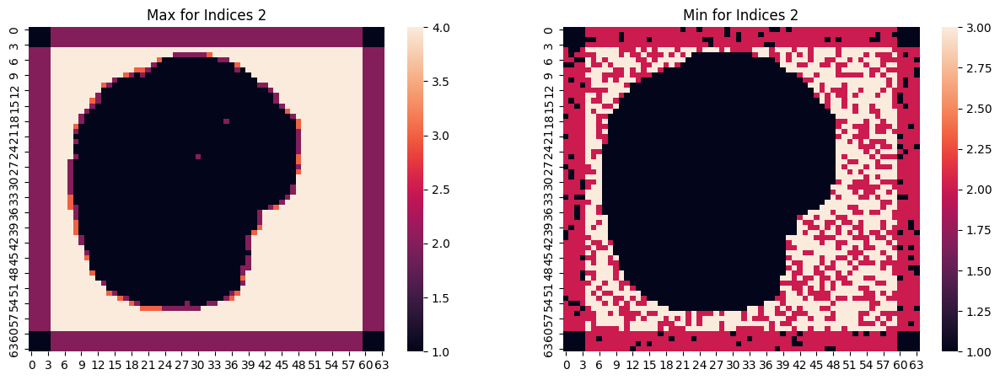

<Figure size 640x480 with 0 Axes>

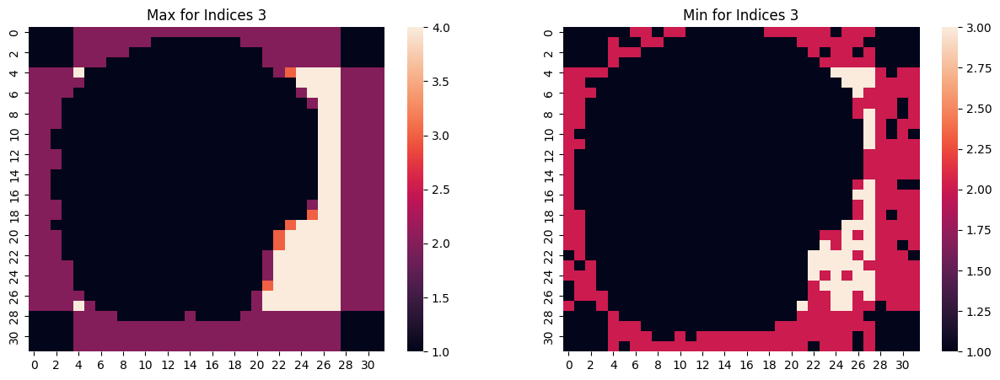

<Figure size 640x480 with 0 Axes>

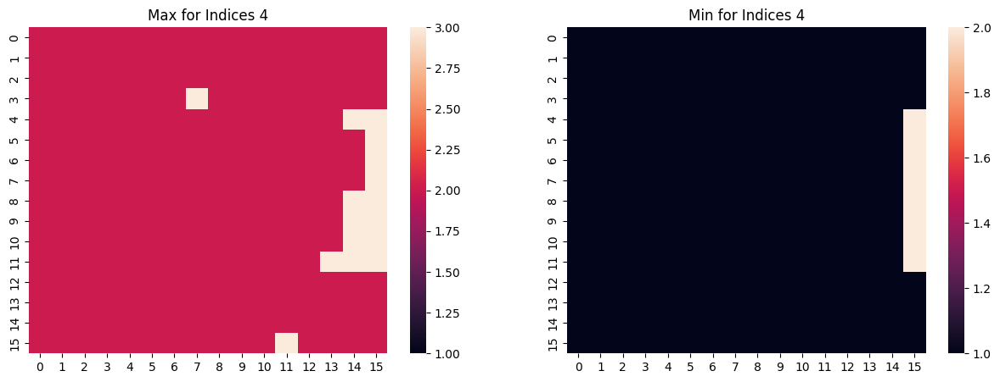

<Figure size 640x480 with 0 Axes>

In [ ]:
### REAL PERTURBED INDICES

def count_uniq_idx(perturbed_idx):
    uniq_val = np.zeros_like(perturbed_idx[0,:,:,:])
    # print(uniq_val.shape)

    for c in range(perturbed_idx.shape[-3]):
        for h in range(perturbed_idx.shape[-2]):
            for w in range(perturbed_idx.shape[-1]):
                # print(np.unique(perturbed_idx[:, c, h, w]))
                uniq_val[c,h,w] = len(np.unique(perturbed_idx[:, c, h, w]))

    return uniq_val

for i in range(1,5):
# for i in range(4,5):
    perturbed_idx=[]
    for file in glob.glob(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_indices/*indices{i}*'):
        perturbed_idx.append(pickle.load(open(file, 'rb')).numpy().squeeze())

    perturbed_idx = np.array(perturbed_idx)

    print(perturbed_idx.shape)
    
    # layer_sig = np.std(perturbed_idx, axis=0)
    # # layer_sig = sig.significant_digits(perturbed_idx, reference=np.mean(perturbed_idx, axis=0, dtype=np.float64), method=sig.Method.CNH, basis=10, dtype=np.float64)
    # # layer_sig = sig.significant_digits(indices, reference=np.mean(indices, axis=0), basis=10)
    # norm = TwoSlopeNorm(vmin=layer_sig.min(), vmax=layer_sig.max())

    uniq_val = count_uniq_idx(perturbed_idx)

    fig, axes = plt.subplots(1,2, figsize=(15,5))

    gc = sns.heatmap(np.max(uniq_val, axis=0), vmin=1, ax=axes[0])
    gc.set_title(f'Max for Indices {i}')
    gc = sns.heatmap(np.min(uniq_val, axis=0), vmin=1, ax=axes[1])
    gc.set_title(f'Min for Indices {i}')
    # gc = sns.heatmap(np.mean(layer_sig, axis=0), vmin=0, norm=LogNorm(), cmap='RdYlGn_r', cbar=True)
    plt.figure()


**Check how relatively similar the values are to one another**

In [ ]:
def abs_diff(input_array, pool_size, strides, rtol=1e-5):
    channels, input_height, input_width = input_array.shape
    pool_height, pool_width = pool_size
    stride_height, stride_width = strides
    
    # Calculate the output dimensions
    output_height = (input_height - pool_height) // stride_height + 1
    output_width = (input_width - pool_width) // stride_width + 1
    
    # Initialize the output array
    output_array_first = np.zeros((channels, input_height, input_height))
    output_array_second = np.zeros((channels, input_height, input_height))
    output_array_third = np.zeros((channels, input_height, input_height))
    output_array_fourth = np.zeros((channels, input_height, input_height))
    uniq_val = np.zeros((channels, output_height, output_width))
    # idx = np.zeros((channels, output_height, output_width))
    
    # Perform max pooling
    for c in range(channels):
        for i in range(output_height):
            for j in range(output_width):
                # Define the pooling window
                window = input_array[c, i * stride_height:i * stride_height + pool_height,
                                     j * stride_width:j * stride_width + pool_width]
                

                # check_multi_max = torch.sum(
                #     torch.isclose(window, maxval[:, None, None], rtol=1e-7, equal_nan=True), axis=(1, 2)
                # )
                maxval = np.max(window)

                # uniq_val[c, i, j] = len(np.unique(window.ravel()))
                uniq_val[c, i, j] = np.isclose(window.ravel(), maxval, rtol=rtol, equal_nan=True).sum()
    
                pairwise_abs_diff = np.abs(window.ravel()[:, None] - window.ravel())
                # print(pairwise_abs_diff)
                pairwise_abs_diff = pairwise_abs_diff.reshape(4,2,2)
    
                output_array_first[c, i * stride_height:i * stride_height + pool_height,
                                     j * stride_width:j * stride_width + pool_width] = pairwise_abs_diff[0]
                
                output_array_second[c, i * stride_height:i * stride_height + pool_height,
                                     j * stride_width:j * stride_width + pool_width] = pairwise_abs_diff[1]
    
                output_array_third[c, i * stride_height:i * stride_height + pool_height,
                                     j * stride_width:j * stride_width + pool_width] = pairwise_abs_diff[2]
    
                output_array_fourth[c, i * stride_height:i * stride_height + pool_height,
                                     j * stride_width:j * stride_width + pool_width] = pairwise_abs_diff[3]


    # return output_array_first, output_array_second, output_array_third, output_array_fourth, uniq_val
    return uniq_val


Single MCA Iteration

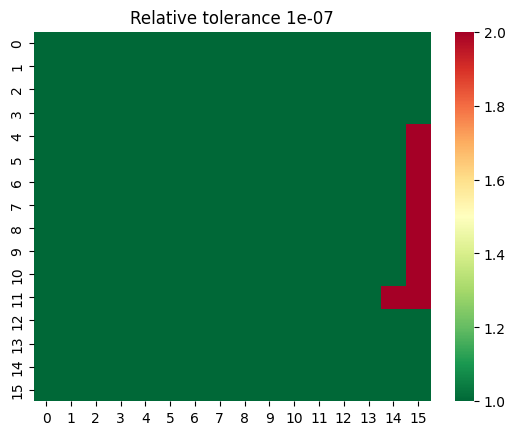

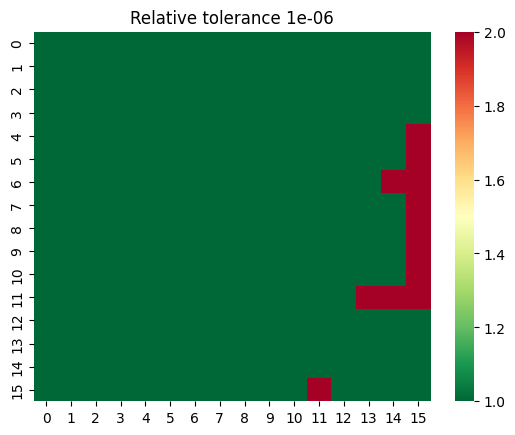

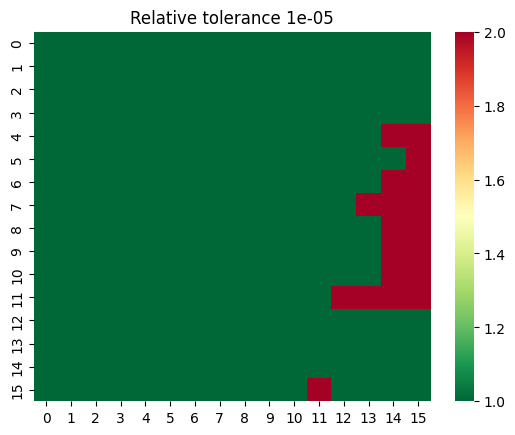

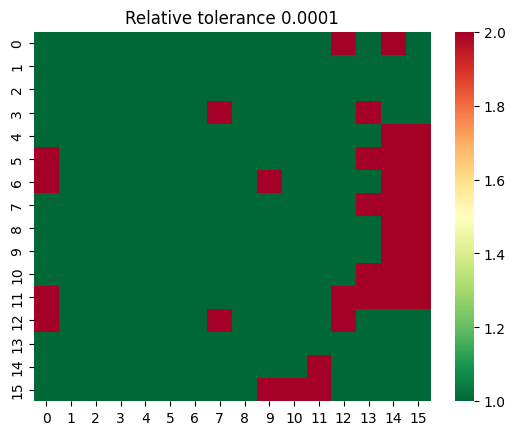

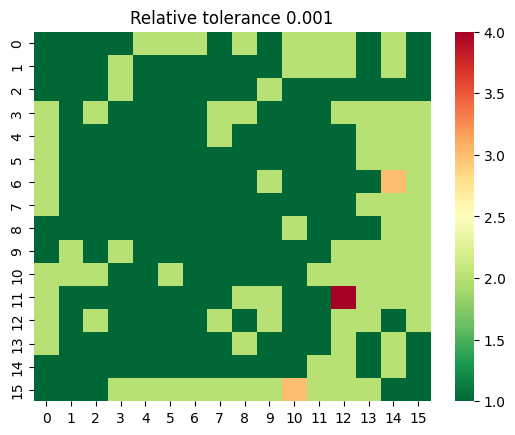

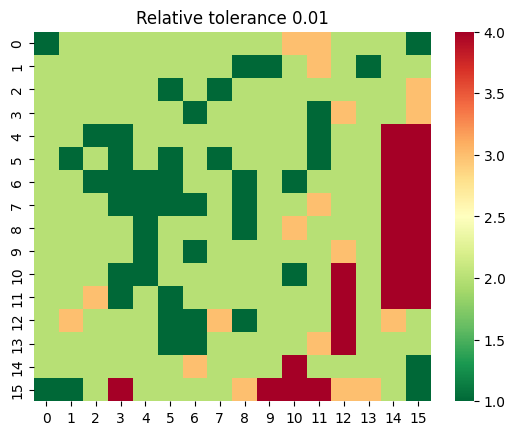

In [ ]:
for rtol in [1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2]:
    a = abs_diff(perturbed_idx[0].squeeze(), (2,2), (2,2), rtol=rtol)
    gc = sns.heatmap(np.max(a, axis=0), cmap='RdYlGn_r', cbar=True)
    gc.set_title(f'Relative tolerance {rtol}')
    plt.show()


Max Across All MCA Iterations

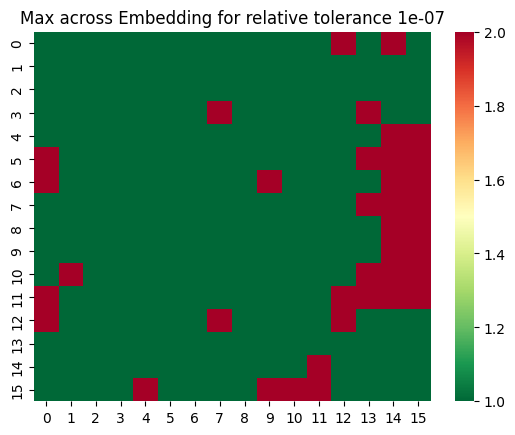

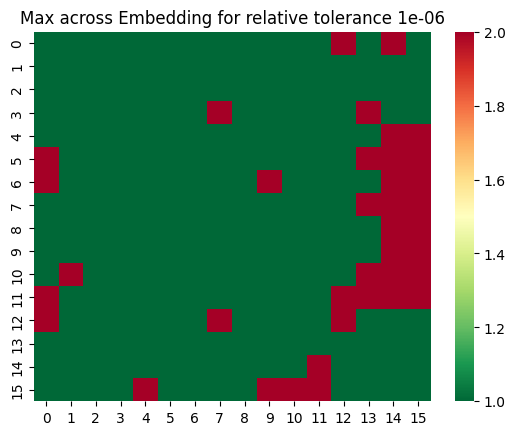

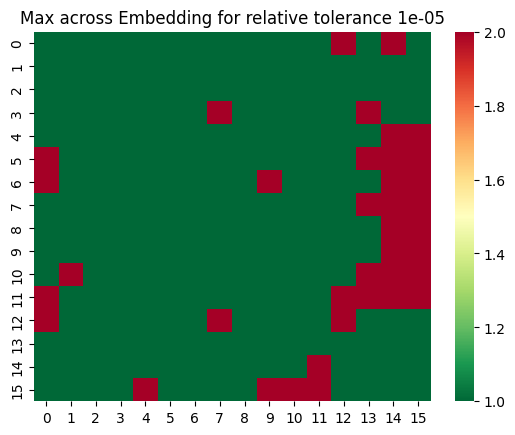

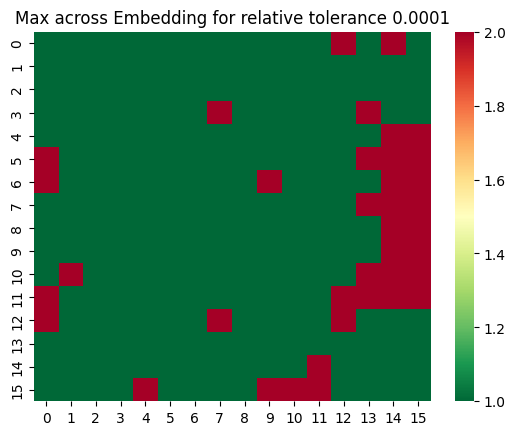

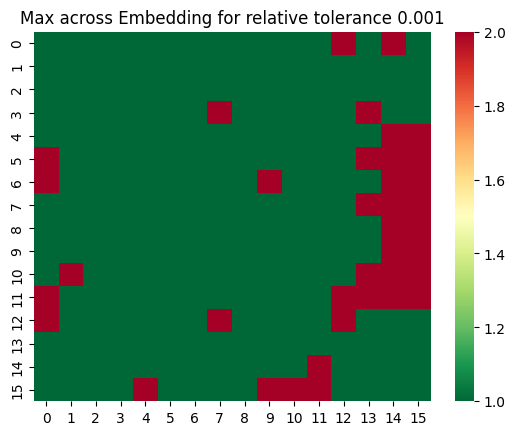

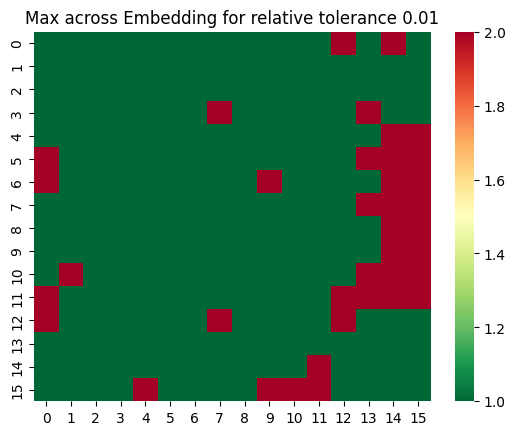

In [ ]:
for rtol in [1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2]:

    encode4_uniform = np.array([abs_diff(perturbed_idx[i].squeeze(), (2,2), (2,2), rtol=1e-4) for i in range(perturbed_idx.shape[0]) ])

    gc = sns.heatmap(np.max(np.max(encode4_uniform, axis=0), axis=0), cmap='RdYlGn_r', cbar=True)
    gc.set_title(f'Max across Embedding for relative tolerance {rtol}')
    plt.show()

## NaN Pooling Degradation without NaNConv

### NaN Pooling Across Model -- Convolution causes degradation

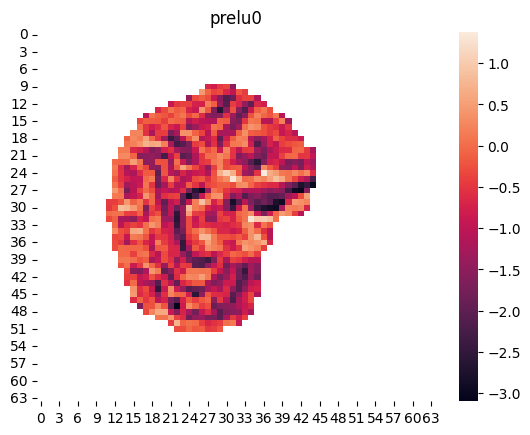

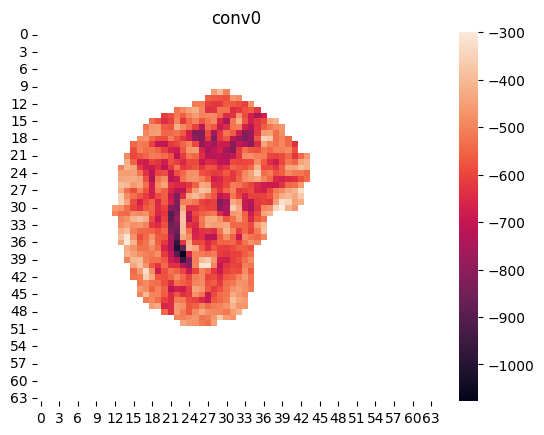

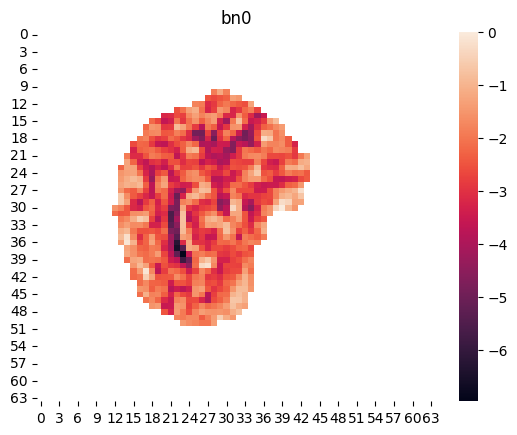

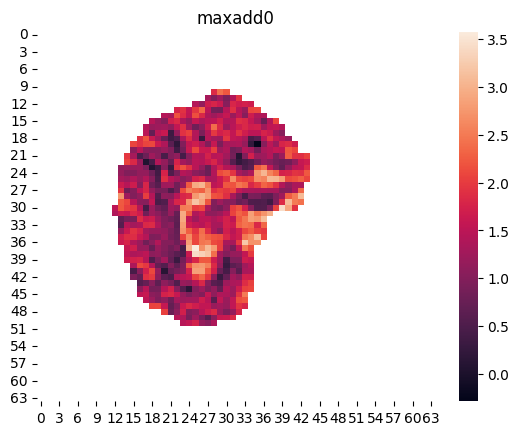

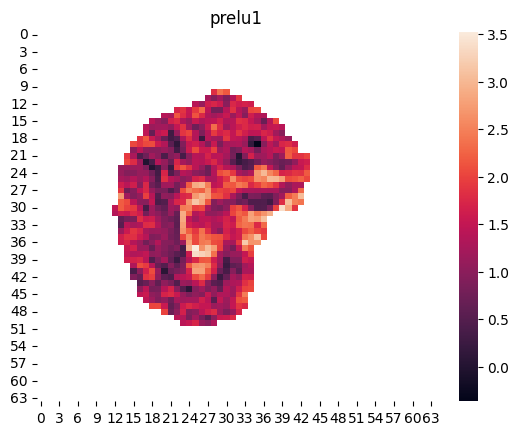

...

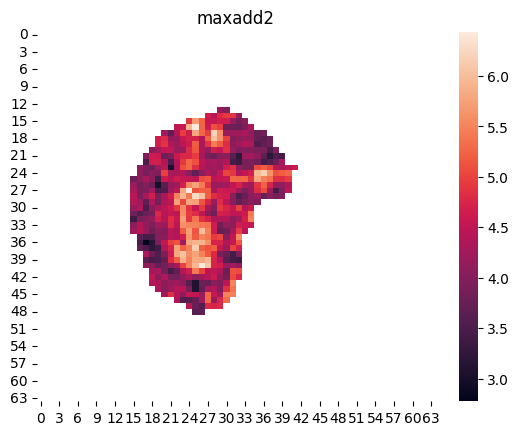

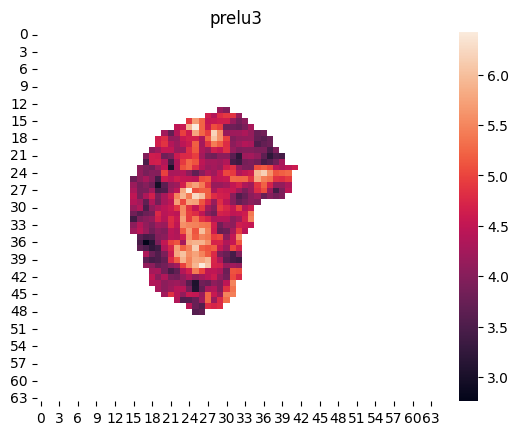

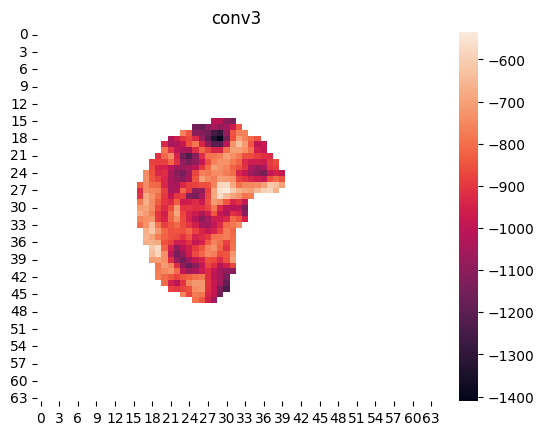

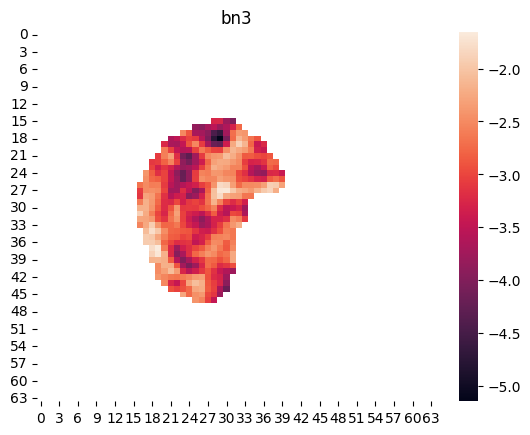

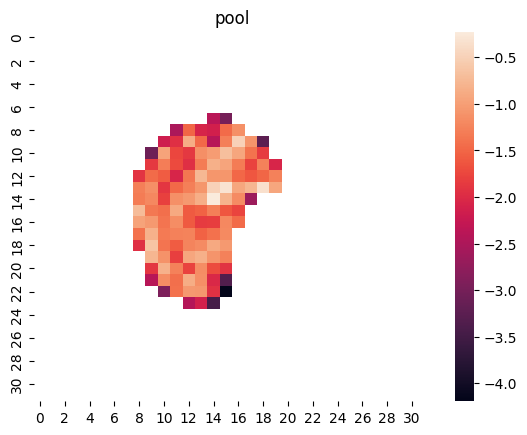

<Figure size 640x480 with 0 Axes>

In [ ]:
# for i in ['encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1']:
for i in ['prelu0', 'conv0', 'bn0', 'maxadd0', 'prelu1', 'conv1', 'bn1', 'maxadd1', 'prelu2', 'conv2', 'bn2', 'maxadd2', 'prelu3', 'conv3', 'bn3', 'pool']:
# for i in ['conv0', 'bn0', 'conv1', 'conv2', 'conv3', 'pool']:
    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanpool_ieee/outp_{i}_1.pkl', 'rb'))
    # if i == 'encode1': break

    # print(a.shape)
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0))
    gc.set_title(i)
    plt.figure()


### NaN Pooling Degradation across Model

/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin =

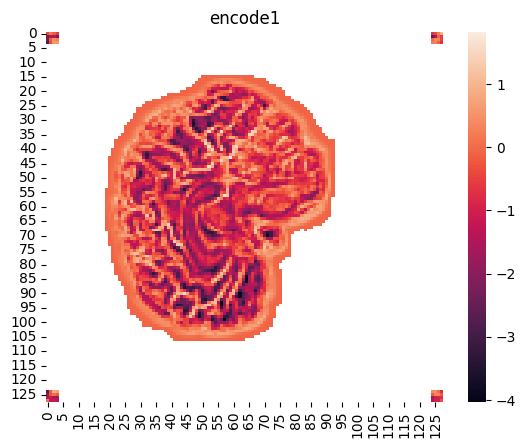

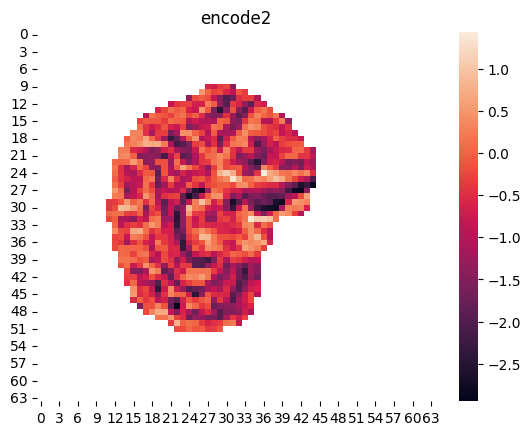

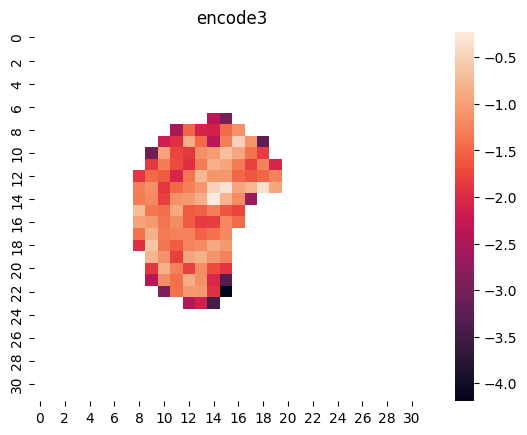

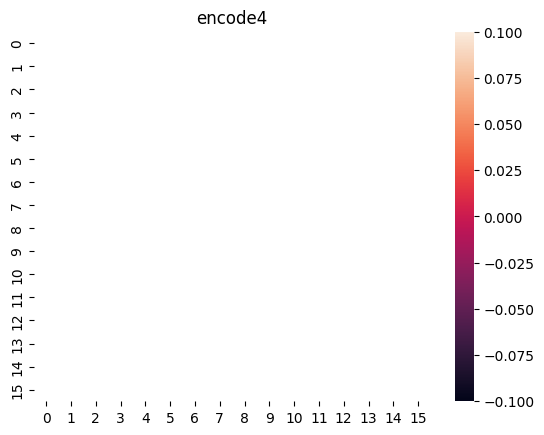

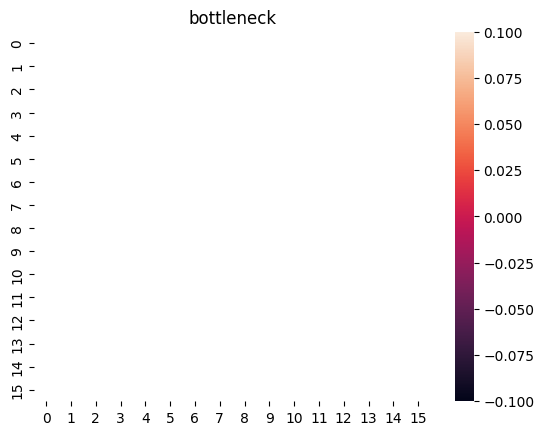

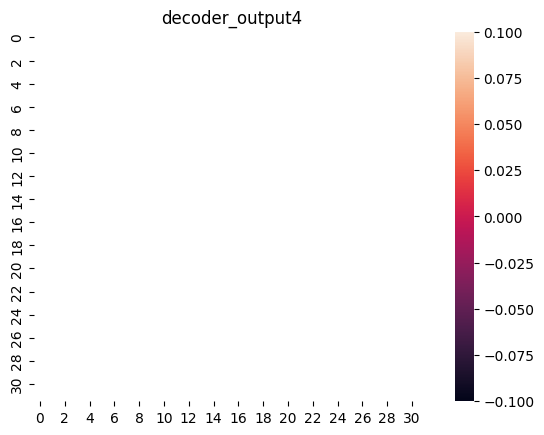

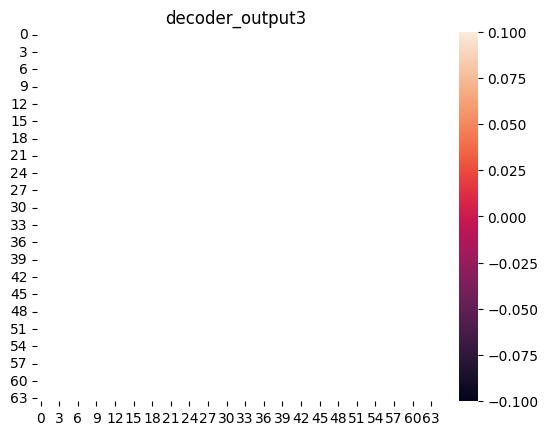

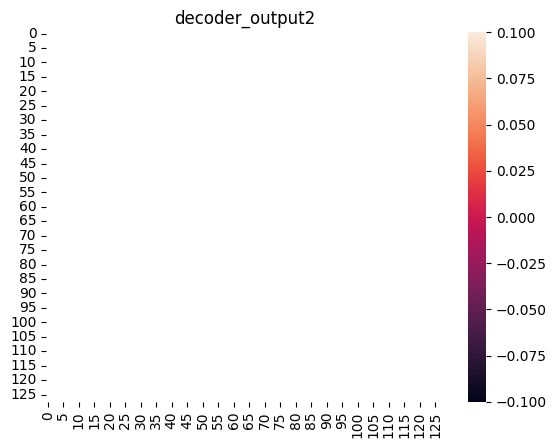

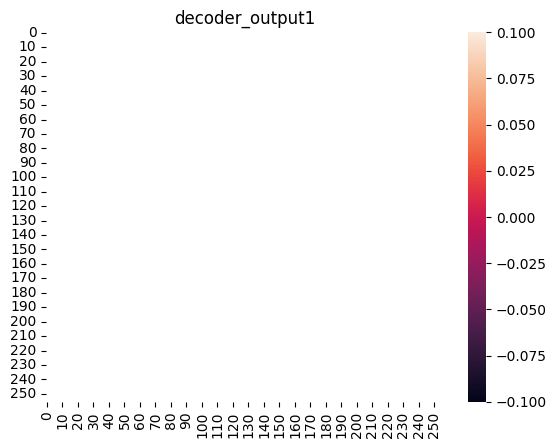

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in ['encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1']:
# for i in ['prelu0', 'conv0', 'bn0', 'maxadd0', 'prelu1', 'conv1', 'bn1', 'maxadd1', 'prelu2', 'conv2', 'bn2', 'maxadd2', 'prelu3', 'conv3', 'bn3', 'pool']:
# for i in ['conv0', 'bn0', 'conv1', 'conv2', 'conv3', 'pool']:
    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanpool_ieee/{i}_1.pkl', 'rb'))
    # if i == 'encode1': break

    # print(a.shape)
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0))
    gc.set_title(i)
    plt.figure()

## Time MaxPool and Conv
[OUT OF DATE] Consult [this notebook](https://github.com/jacobfortinmtl/TorchExtensions/blob/main/main.ipynb) for more up to date time trials 

Maxpool has a slowdown of approx ~17x while Conv has a slowdown of 5x

**Removing for loop from NanPool Impact** \
For small input \
NanPool_v2 has: \
`17.8 s ± 331 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)` \
NanPool has: \
`17.7 s ± 277 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)`

For large input \
NanPool_v2 has: \
`2min ± 5.65 s per loop (mean ± std. dev. of 7 runs, 1 loop each)` \
NanPool has: \
`2min 11s ± 10.9 s per loop (mean ± std. dev. of 7 runs, 1 loop each)`


In [75]:
# a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanpool_ieee/outp_prelu0_1.pkl', 'rb'))
a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/1_inp_block_4.pkl', 'rb'))

m = torch.nn.Conv2d(
                in_channels=32,
                out_channels=71,
                kernel_size=(3,3),
                stride=2,
                padding=(0, 0)
    )

a.shape

torch.Size([1, 32, 256, 256])

#### Torch dynamo
* Try @dynamo
* Try within FastSurfer

In [76]:
import torch._dynamo as dynamo

conv0 = NaNConv2d(train=False, kernel=m.weight, bias=m.bias, padding=1, stride=2, threshold=0.5)
dynamo_conv0 = dynamo.optimize("inductor")(conv0)

/home/ine5/dynamo_env/lib/python3.10/site-packages/torch/cuda/__init__.py:619: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


In [77]:
%%timeit
x0 = conv0(a)

3.36 s ± 242 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [78]:
%time
x0 = conv0(a)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 11.4 µs


## Sanity Checks

### Sanity Check for Conv Accuracy (with NaN modifications)

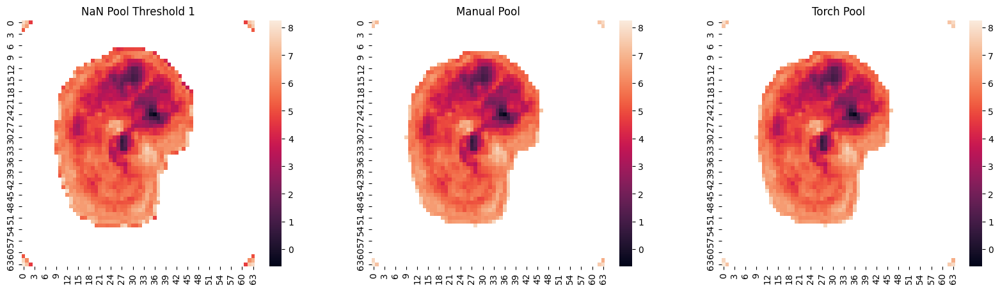

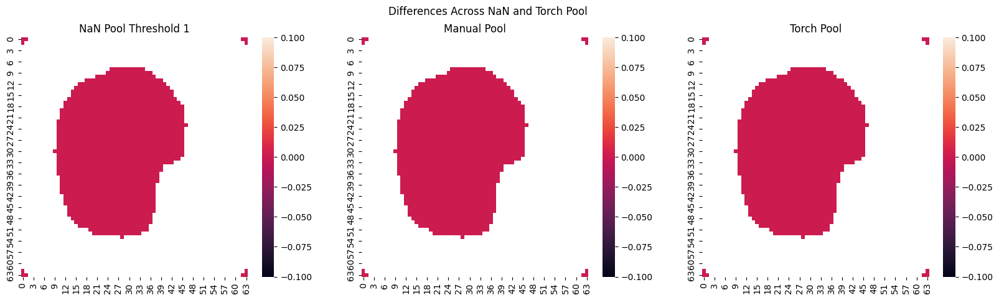

In [148]:
a = pickle.load(open('../../results/sub-0025531_encode2/outp_bn3_1.pkl', 'rb')) #(large, no nans)
b = pickle.load(open('../../results/sub-0025531_comparison/ieee_encode2_1.pkl', 'rb')) #(small no NaNs)
c = pickle.load(open('../../results/sub-0025531_comparison/0.5_decoder_output2_3.pkl', 'rb')) #(contains NaNs)


nanpool = NaNPool2d(threshold=0.25)
nanoutput, nanindices = nanpool(a, pool_size=(2,2), strides=(2,2)) ##pool_size == kernel_size
normalpool = NormalNPool2d(threshold=1)
normaloutput, normalindices = normalpool(a, pool_size=(2,2), strides=(2,2)) ##pool_size == kernel_size
pool = torch.nn.MaxPool2d(2, 2, return_indices=True)
torchoutput, torchindices = pool(a)

#Visualize output
fig, axes = plt.subplots(1, 3, figsize=(20,5))

gc = sns.heatmap(np.mean(nanoutput.detach().numpy().squeeze(), axis=0), ax=axes[0])
gc.set_title('NaN Pool Threshold 1')
gc = sns.heatmap(np.mean(normaloutput.detach().numpy().squeeze(), axis=0), ax=axes[1])
gc.set_title('Manual Pool')
gc = sns.heatmap(np.mean(torchoutput.detach().numpy().squeeze(), axis=0), ax=axes[2])
gc.set_title('Torch Pool')
plt.show()


#Visualize output differences -- should be 0
fig, axes = plt.subplots(1, 3, figsize=(20,5))

gc = sns.heatmap(np.mean((nanoutput - torchoutput).detach().numpy().squeeze(), axis=0), ax=axes[0])
gc.set_title('NaN Pool Threshold 1')
gc = sns.heatmap(np.mean((normaloutput - torchoutput).detach().numpy().squeeze(), axis=0), ax=axes[1])
gc.set_title('Manual Pool')
gc = sns.heatmap(np.mean((torchoutput - torchoutput).detach().numpy().squeeze(), axis=0), ax=axes[2])
gc.set_title('Torch Pool')
plt.suptitle('Differences Across NaN and Torch Pool')
plt.show()

##### Pool

In [107]:
a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanpool_ieee/outp_prelu0_1.pkl', 'rb'))

pool = torch.nn.MaxPool2d(2, 2, return_indices=True)
nanpool = NaNPool2d(threshold=0.25)
normalpool = NormalNPool2d(threshold=1)

In [80]:
%time
nanoutput, _ = nanpool(a, (2,2), (2,2))

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.44 µs


In [81]:
%time
normaloutput, _ = normalpool(a, (2,2), (2,2))

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 11.7 µs


In [82]:
%time 
torchoutput, _ = pool(a)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 8.11 µs


In [83]:
manual_avg_time = [18.0, 17.1, 16.9, 17.7, 17.2]
torch_avg_time = [0.0, 0.0, 0.0, 0.0, 0.0]

print(f"Manual MaxPool Time: {np.mean(manual_avg_time):.2f} seconds     Torch MaxPool Time: {np.mean(torch_avg_time):.2f} seconds")

Manual MaxPool Time: 17.38 seconds     Torch MaxPool Time: 0.00 seconds


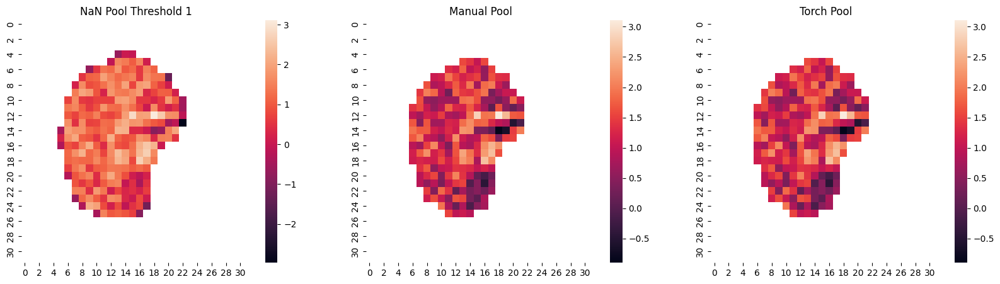

In [84]:
fig, axes = plt.subplots(1, 3, figsize=(20,5))

gc = sns.heatmap(np.mean(nanoutput.detach().numpy().squeeze(), axis=0), ax=axes[0])
gc.set_title('NaN Pool Threshold 1')
gc = sns.heatmap(np.mean(normaloutput.detach().numpy().squeeze(), axis=0), ax=axes[1])
gc.set_title('Manual Pool')
gc = sns.heatmap(np.mean(torchoutput.detach().numpy().squeeze(), axis=0), ax=axes[2])
gc.set_title('Torch Pool');

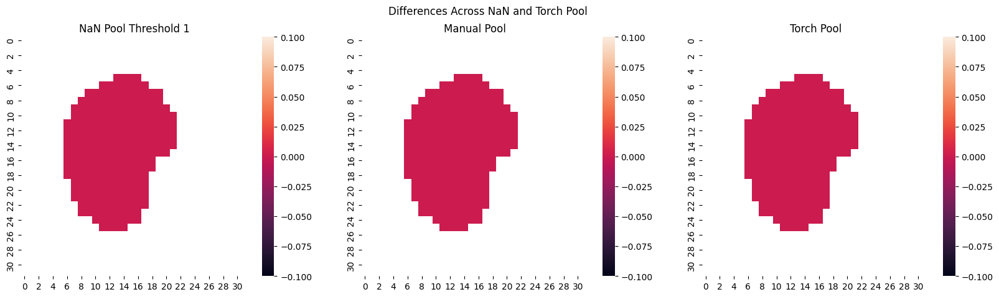

In [85]:
fig, axes = plt.subplots(1, 3, figsize=(20,5))

gc = sns.heatmap(np.mean((nanoutput - torchoutput).detach().numpy().squeeze(), axis=0), ax=axes[0])
gc.set_title('NaN Pool Threshold 1')
gc = sns.heatmap(np.mean((normaloutput - torchoutput).detach().numpy().squeeze(), axis=0), ax=axes[1])
gc.set_title('Manual Pool')
gc = sns.heatmap(np.mean((torchoutput - torchoutput).detach().numpy().squeeze(), axis=0), ax=axes[2])
gc.set_title('Torch Pool')
plt.suptitle('Differences Across NaN and Torch Pool');

##### Conv

In [86]:
a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanpool_ieee/outp_prelu0_1.pkl', 'rb'))

m = torch.nn.Conv2d(
                in_channels=71,
                out_channels=71,
                kernel_size=(3,3),
                stride=2,
                padding=(0, 0)
    )
# cc = ConvCustom(a, m.weight, m.bias, stride=2, padding=0)
nanconv = NaNConv2d(train=False, threshold=0.5, kernel=m.weight, bias=m.bias, stride=2, padding=0)
normalconv = NormalConv2d(train=False, threshold=0.5, kernel=m.weight, bias=m.bias, stride=2, padding=0)

In [87]:
%time
#1 min on average
nanoutput = nanconv(a)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.44 µs


In [88]:
%time
# 2-3 mins
normaloutput = normalconv(a)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 16.2 µs


In [89]:
%time 
# 5-10 microseconds
torchlayeroutput = m(a)

CPU times: user 0 ns, sys: 5 µs, total: 5 µs
Wall time: 9.3 µs


In [90]:
%time
# 5-10 microseconds
torchfuncoutput = F.conv2d(input=a, weight=m.weight, bias=m.bias, stride=2, padding=0)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 5.96 µs


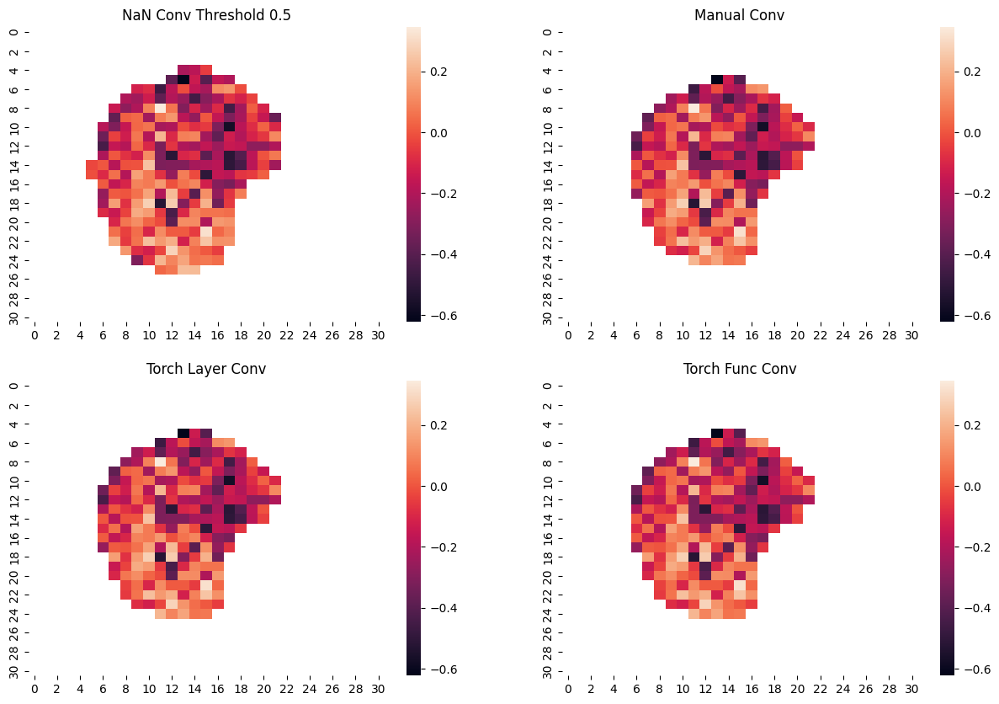

In [91]:
fig, axes = plt.subplots(2, 2, figsize=(15,10))

gc = sns.heatmap(np.mean(nanoutput.detach().numpy().squeeze(), axis=0), ax=axes[0,0])
gc.set_title('NaN Conv Threshold 0.5')
gc = sns.heatmap(np.mean(normaloutput.detach().numpy().squeeze(), axis=0), ax=axes[0,1])
gc.set_title('Manual Conv')
gc = sns.heatmap(np.mean(torchlayeroutput.detach().numpy().squeeze(), axis=0), ax=axes[1,0])
gc.set_title('Torch Layer Conv')
gc = sns.heatmap(np.mean(torchfuncoutput.detach().numpy().squeeze(), axis=0), ax=axes[1,1])
gc.set_title('Torch Func Conv');

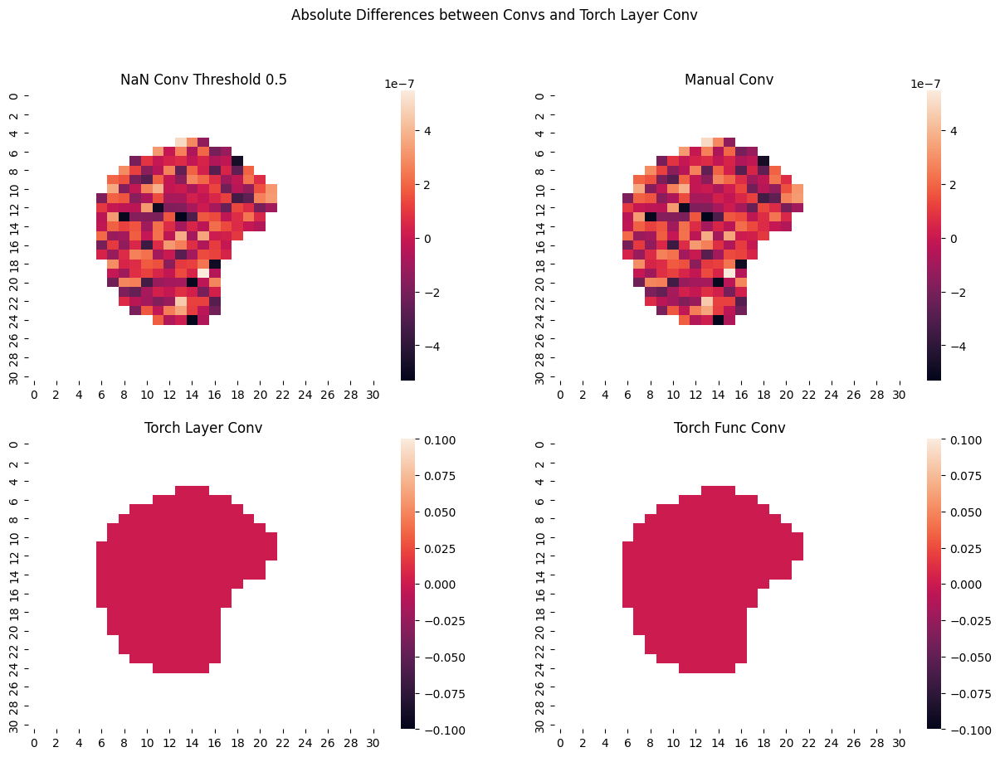

In [92]:
fig, axes = plt.subplots(2, 2, figsize=(15,10))

gc = sns.heatmap(np.mean((nanoutput - torchlayeroutput).detach().numpy().squeeze(), axis=0), ax=axes[0,0])
gc.set_title('NaN Conv Threshold 0.5')
gc = sns.heatmap(np.mean((normaloutput - torchlayeroutput).detach().numpy().squeeze(), axis=0), ax=axes[0,1])
gc.set_title('Manual Conv')
gc = sns.heatmap(np.mean((torchlayeroutput - torchlayeroutput).detach().numpy().squeeze(), axis=0), ax=axes[1,0])
gc.set_title('Torch Layer Conv')
gc = sns.heatmap(np.mean((torchfuncoutput - torchlayeroutput).detach().numpy().squeeze(), axis=0), ax=axes[1,1])
gc.set_title('Torch Func Conv')
plt.suptitle('Absolute Differences between Convs and Torch Layer Conv');

### Manual MaxPool Noise Sanity Check -- Noise still occurs regardless of Max Pooling Implementation

Therefore not Torch issue

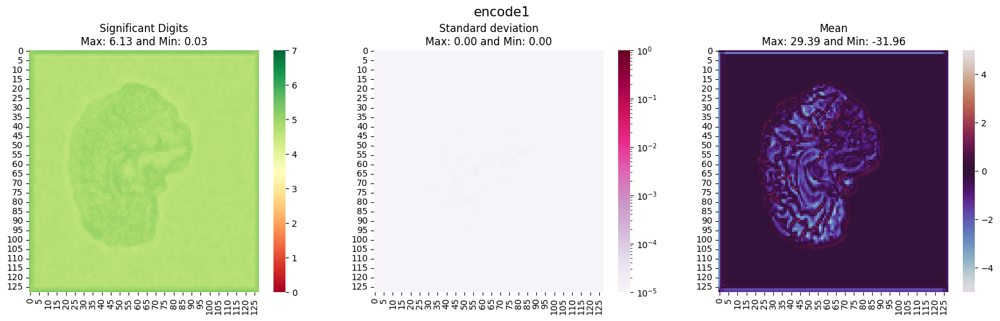

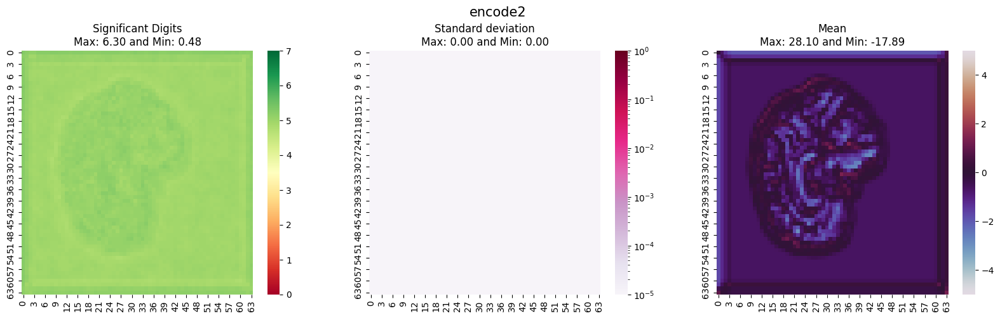

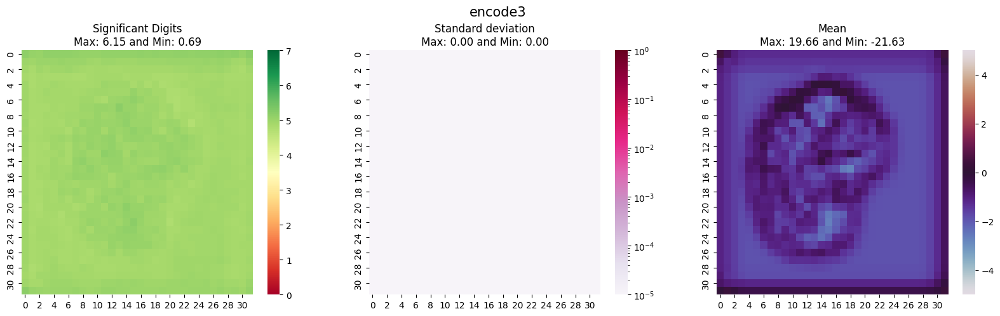

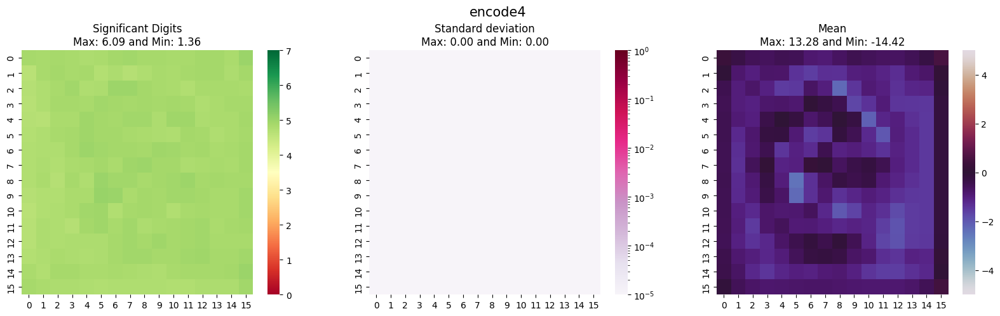

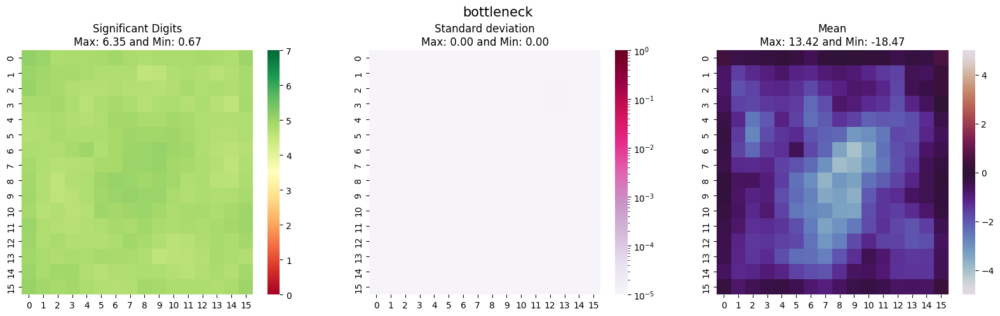

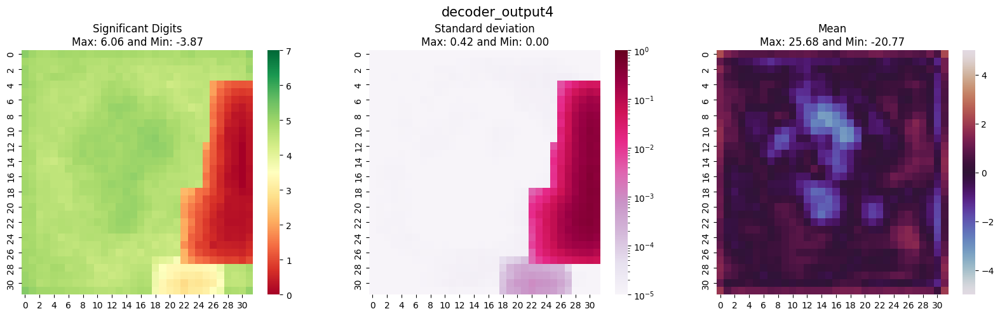

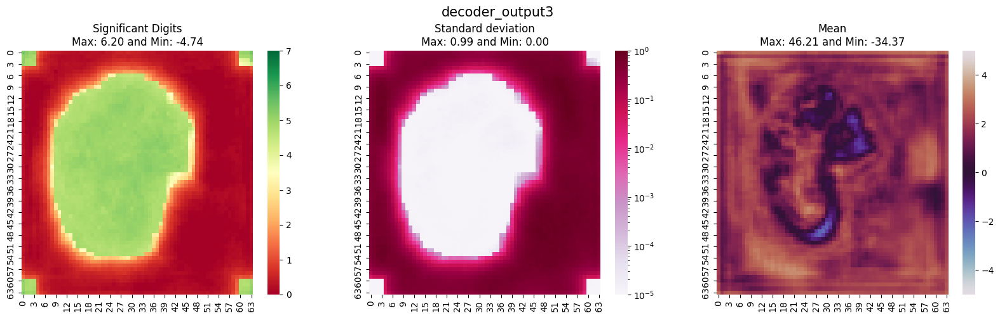

In [209]:
# analyze_embeddings(['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decode4', 'decode3', 'decode2', 'decode1', 'interpol2', 'outp_block', 'classifier'], 
analyze_embeddings(['encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3'], 
                   '/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_pool_sanitycheck/', dict_type=False, colormap='PuRd', std_vmax=1, std_vmin=10e-6, mean_vmin=-5, mean_vmax=5)

## Robustness Check for NaN [OUT OF DATE]

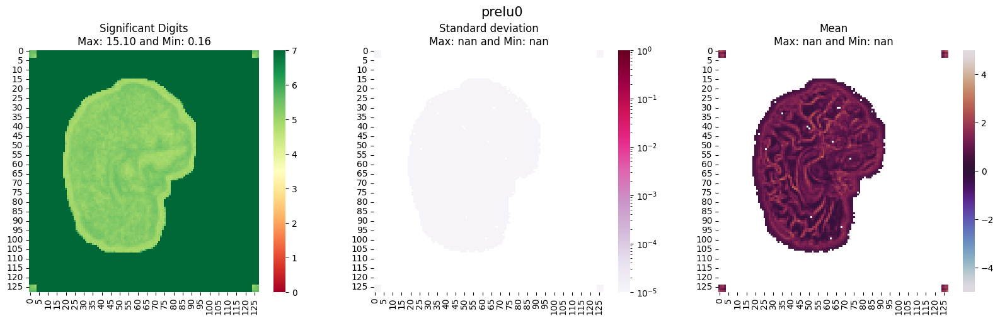

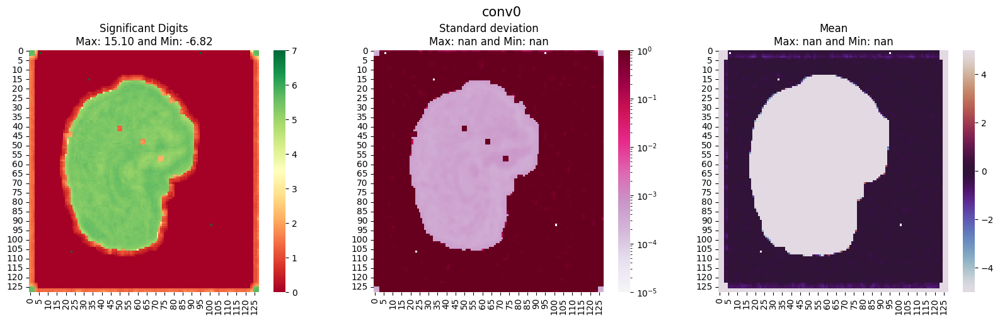

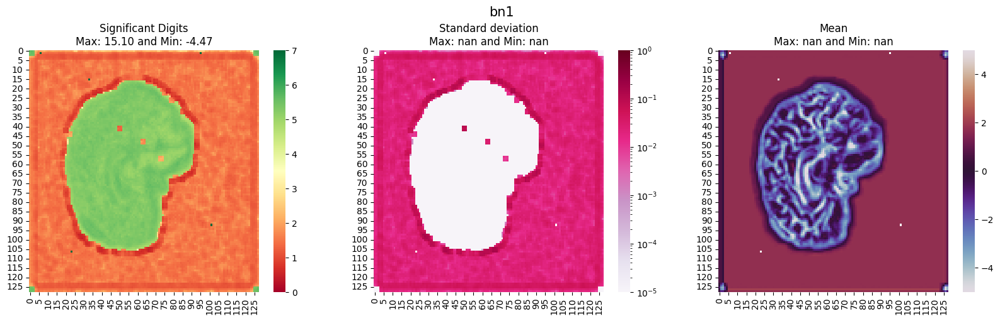

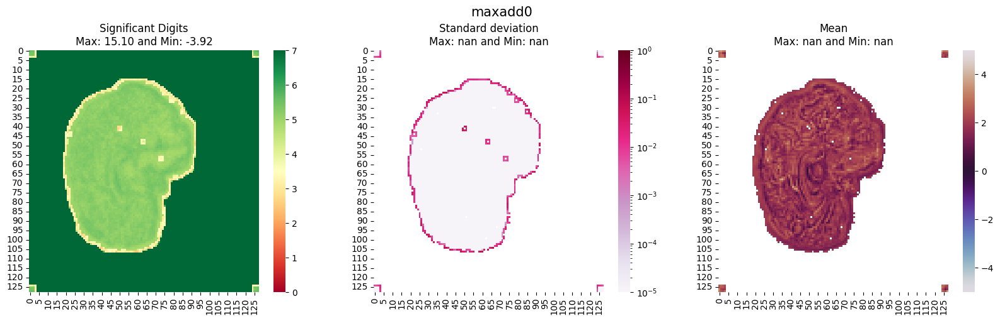

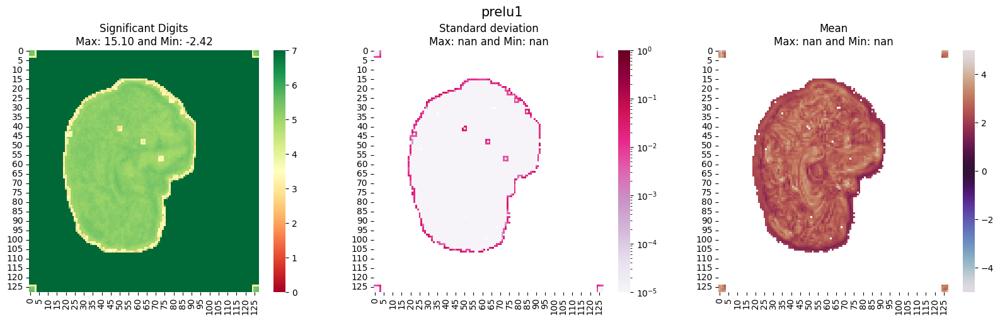

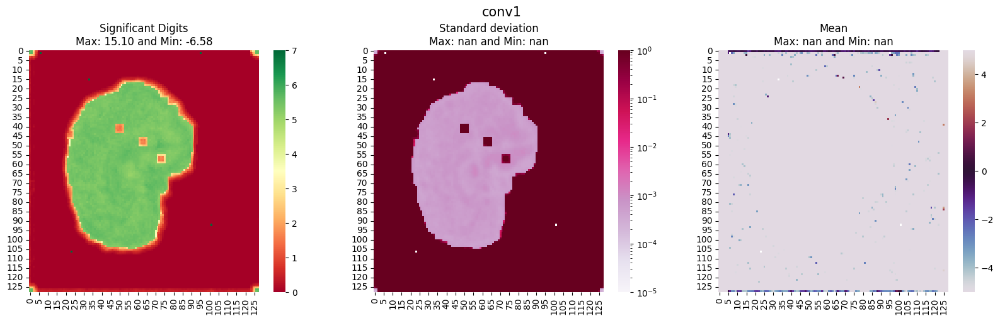

In [ ]:
# analyze_embeddings(['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decode4', 'decode3', 'decode2', 'decode1', 'interpol2', 'outp_block', 'classifier'], 
analyze_embeddings(['prelu0', 'conv0', 'bn1', 'maxadd0', 'prelu1', 'conv1'], 
                   '/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_verrou/encode2', dict_type=False, colormap='PuRd', std_vmax=1, std_vmin=10e-6, mean_vmin=-5, mean_vmax=5)

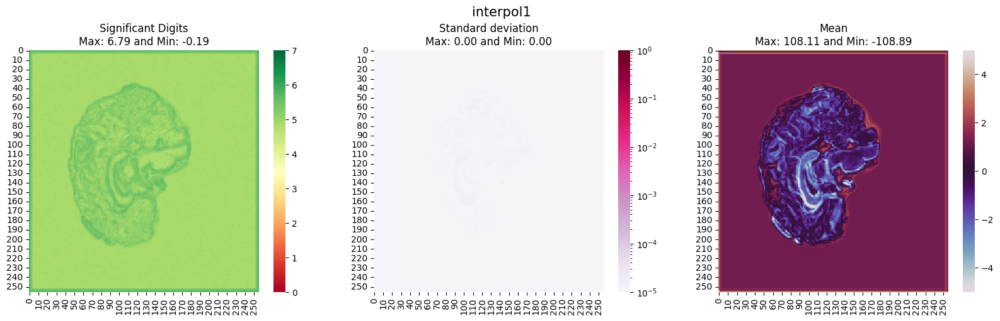

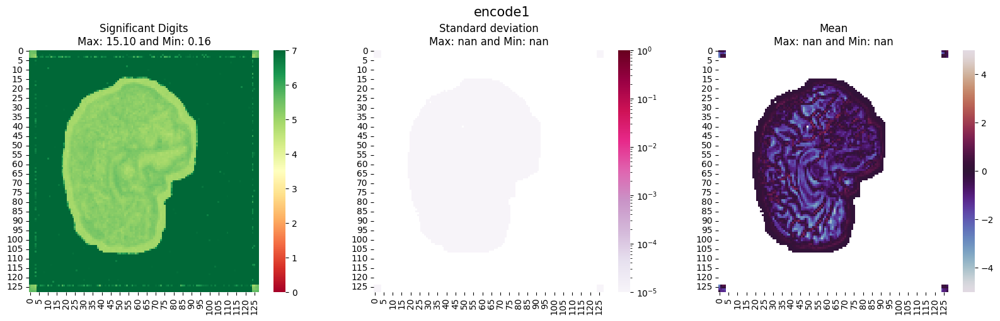

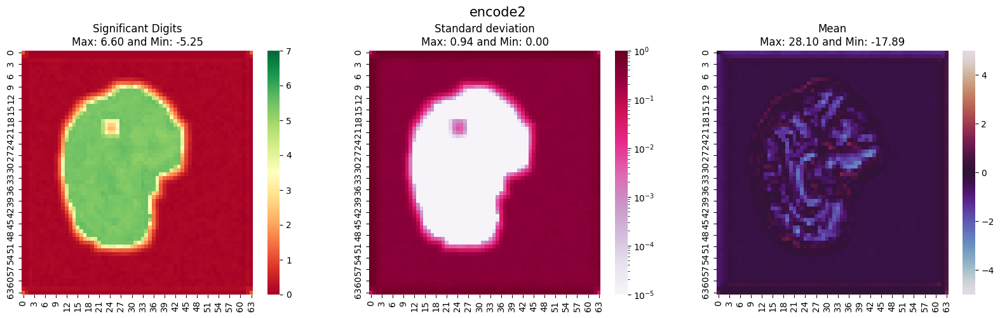

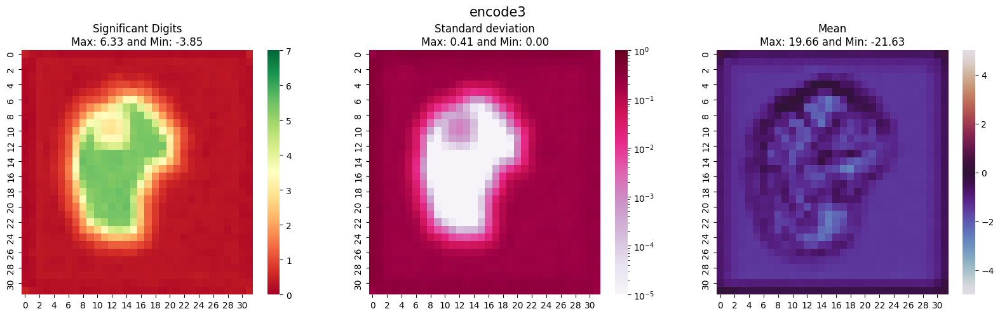

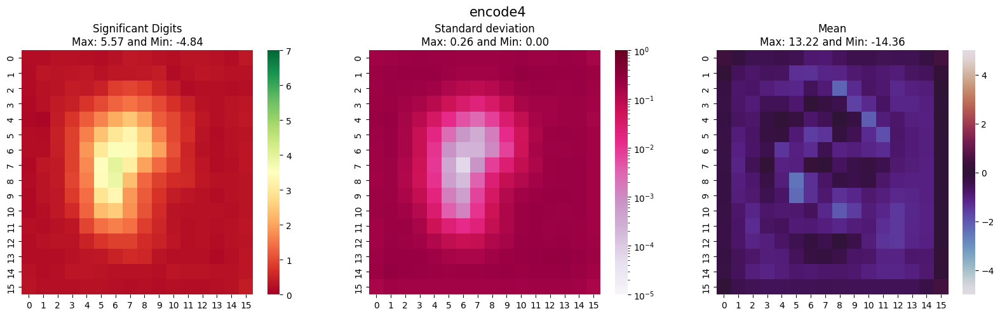

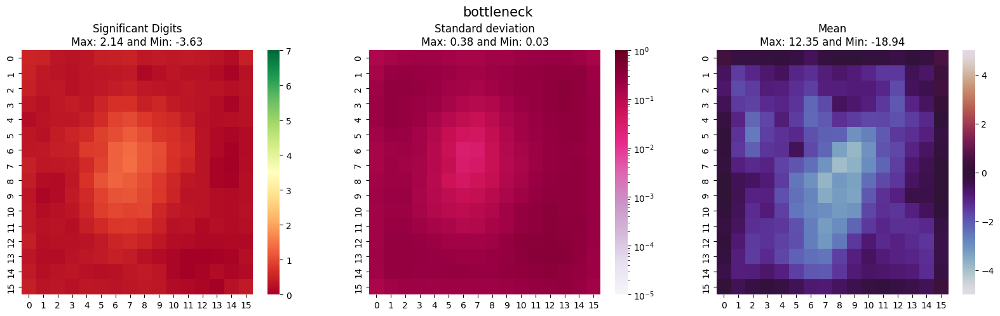

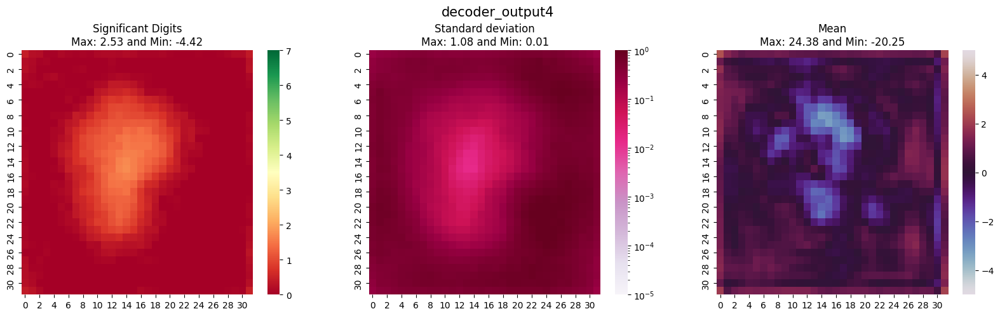

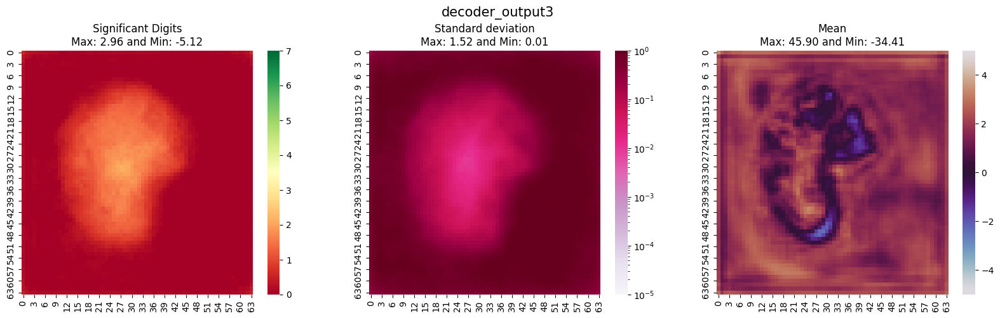

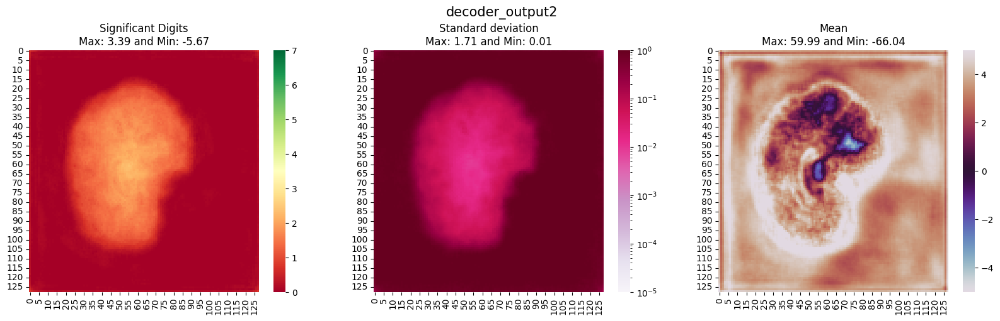

In [ ]:
# analyze_embeddings(['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decode4', 'decode3', 'decode2', 'decode1', 'interpol2', 'outp_block', 'classifier'], 
analyze_embeddings(['encode1','interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2'], 
                   '/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_verrou/', dict_type=False, colormap='PuRd', std_vmax=1, std_vmin=10e-6, mean_vmin=-5, mean_vmax=5)

## NaN vs Default FastSurfer Embeddings Comparison

### sub-0027236

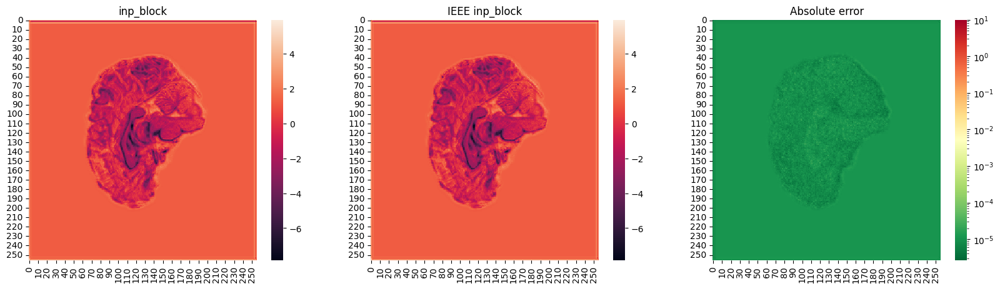

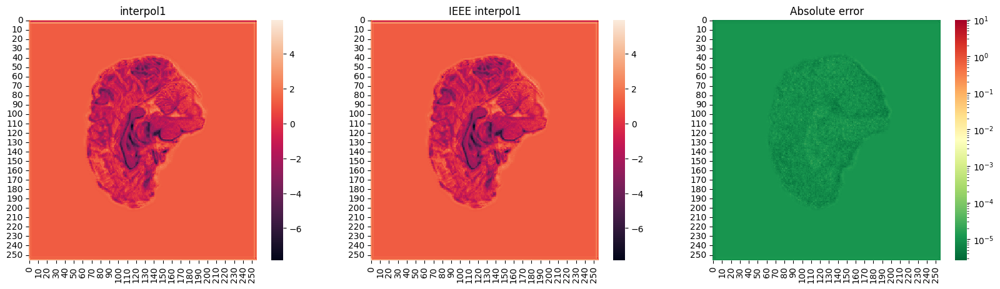

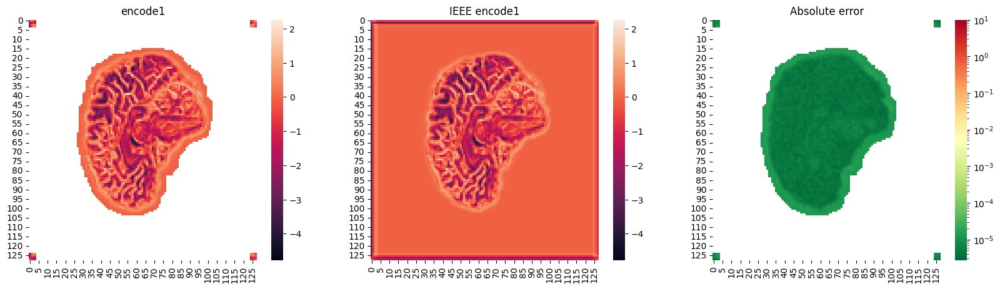

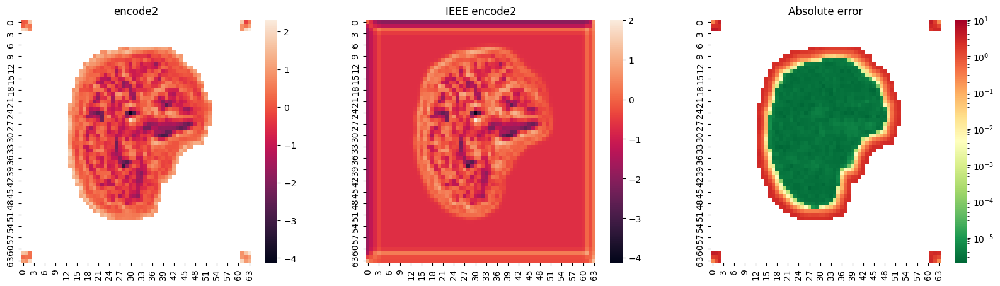

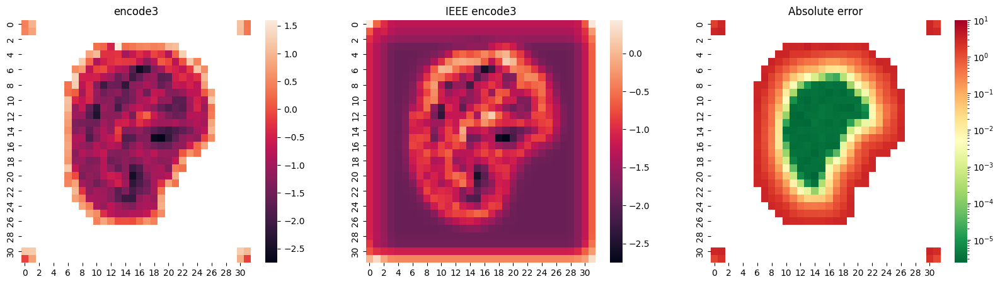

...

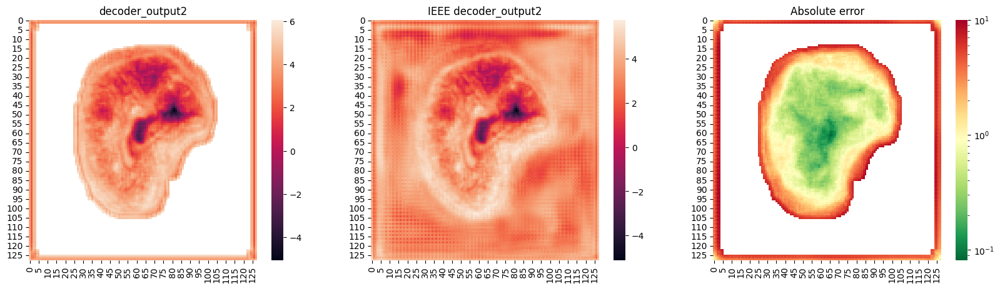

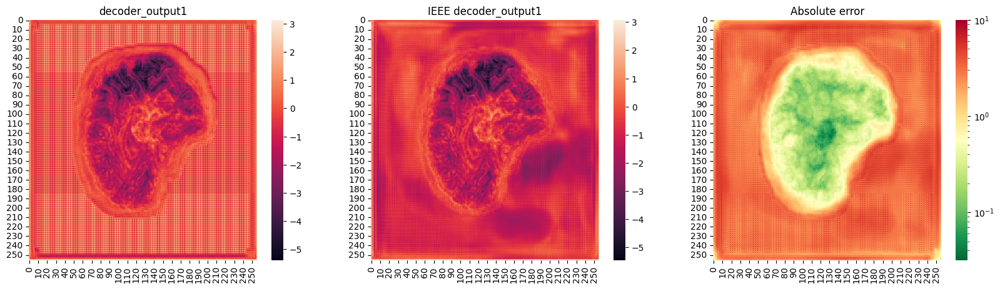

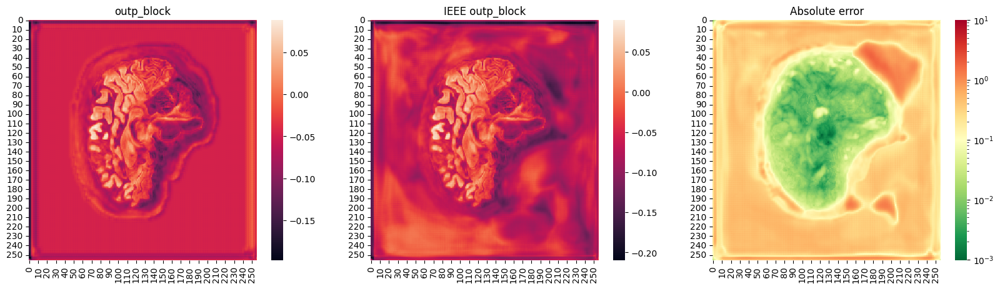

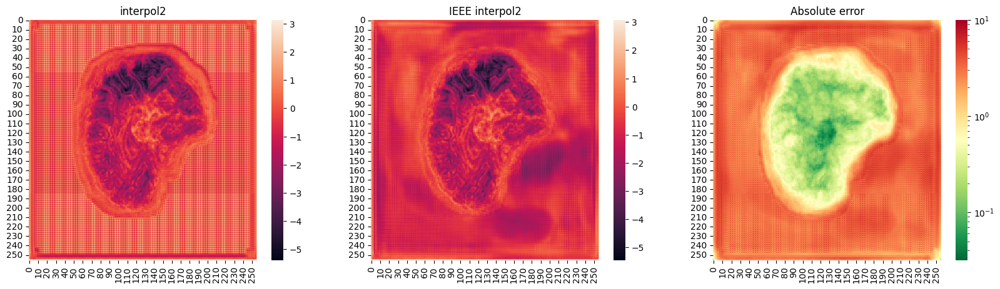

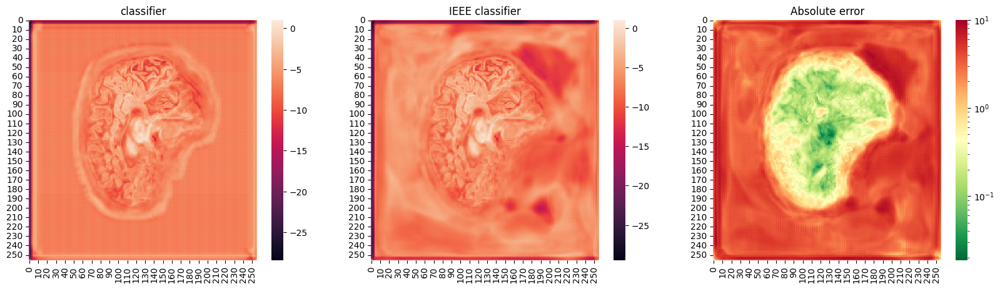

In [ ]:
for i in ['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'interpol2', 'classifier']:

    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0027236_axial/1_{i}_4.pkl', 'rb'))
    ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0027236_sagittal/ieee_{i}_6.pkl', 'rb'))
    # diff = torch.std(torch.cat((a, ieee), dim=0), dim=0)
    diff = torch.abs(a - ieee)

    if i == 'inp_block': i = 'Input Block'
    elif 'encode' in i: i = f'Encoder Block {i[-1]}'
    elif 'decoder' in i: i = f'Decoder Block {i[-1]}'
    elif i == 'outp_block': i = 'Output Block'
    else: i = i.title()

    fig, axes = plt.subplots(1, 3, figsize=(20,5))
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
    gc.set_title(f'NaN {i}')
    gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
    gc.set_title(f'Default {i}')
    gc = sns.heatmap(np.mean(diff.detach().numpy().squeeze(), axis=0), norm=LogNorm(vmin=None, vmax=10), cmap='RdYlGn_r', ax=axes[2])
    gc.set_title(f'Absolute Error')

    # break
    # plt.figure()


### sub-0025350

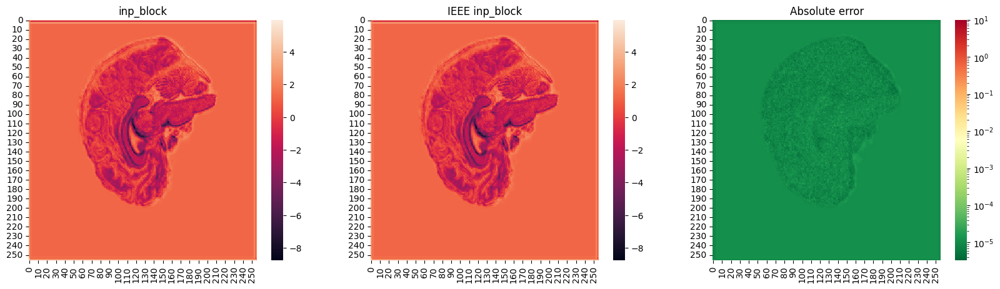

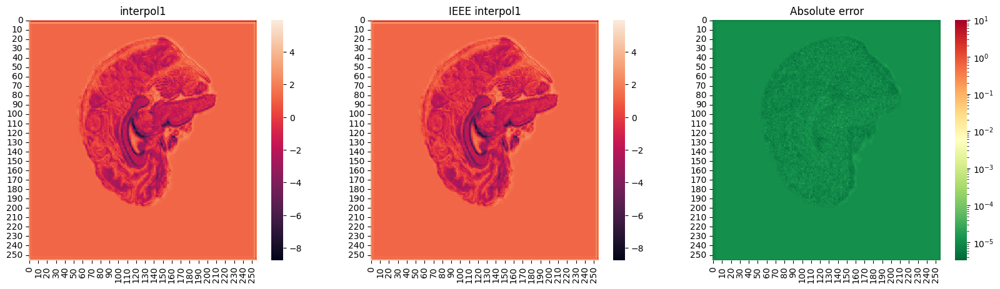

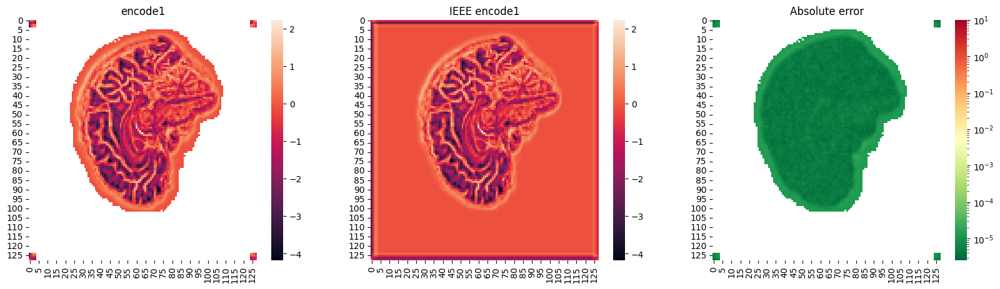

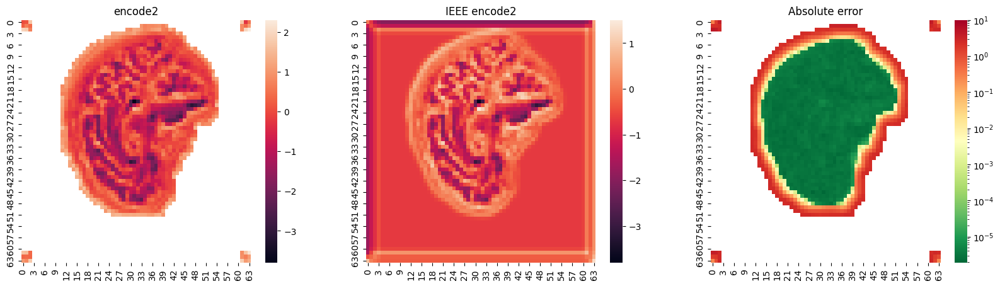

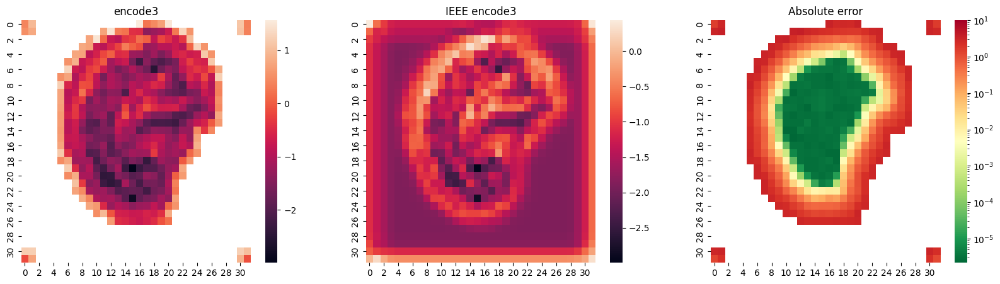

...

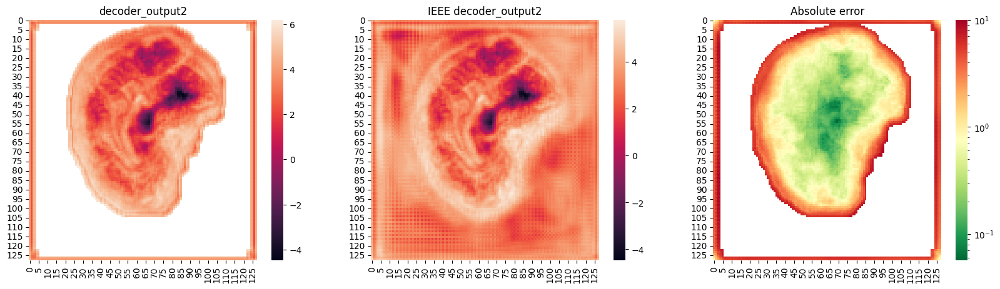

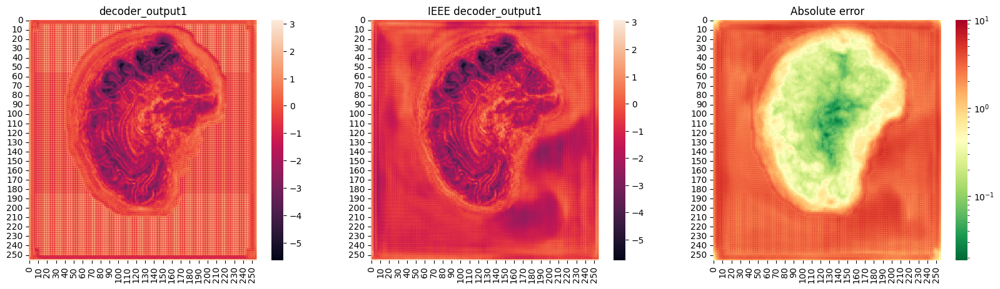

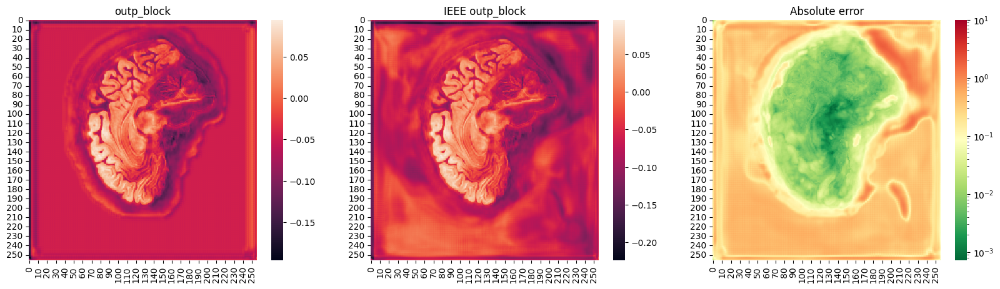

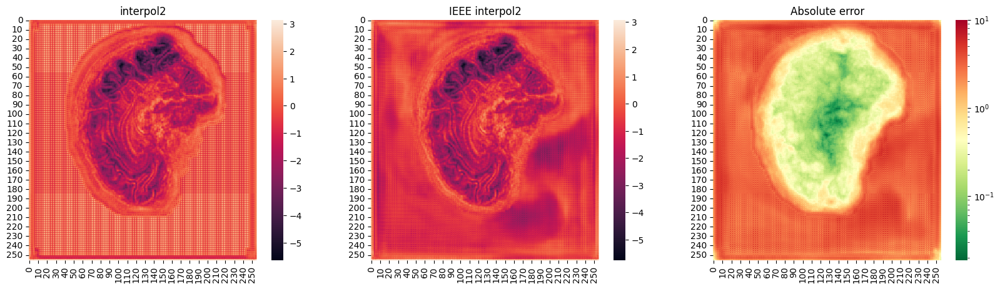

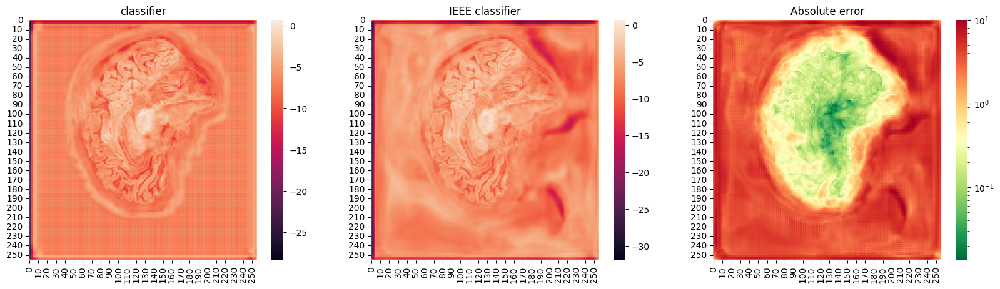

In [ ]:
for i in ['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'interpol2', 'classifier']:

    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025350_sagittal/1_{i}_4.pkl', 'rb'))
    ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025350_sagittal/ieee_{i}_6.pkl', 'rb'))
    # diff = torch.std(torch.cat((a, ieee), dim=0), dim=0)
    diff = torch.abs(a - ieee)

    fig, axes = plt.subplots(1, 3, figsize=(20,5))
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
    gc.set_title(i)
    gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
    gc.set_title(f'IEEE {i}')
    gc = sns.heatmap(np.mean(diff.detach().numpy().squeeze(), axis=0), norm=LogNorm(vmin=None, vmax=10), cmap='RdYlGn_r', ax=axes[2])
    gc.set_title(f'Absolute error')

    # break
    # plt.figure()


### sub-0025531

#### Encode 2

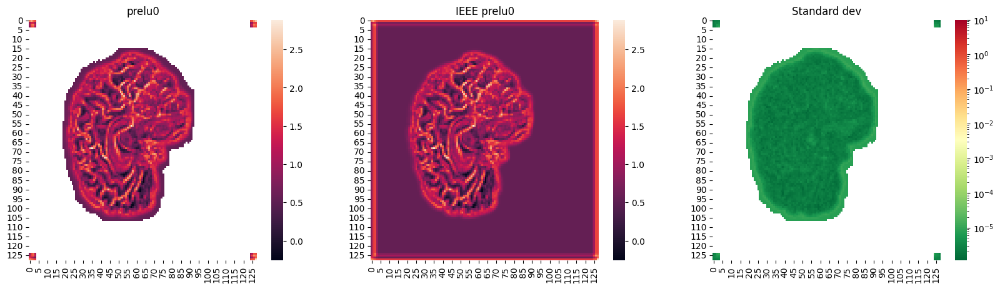

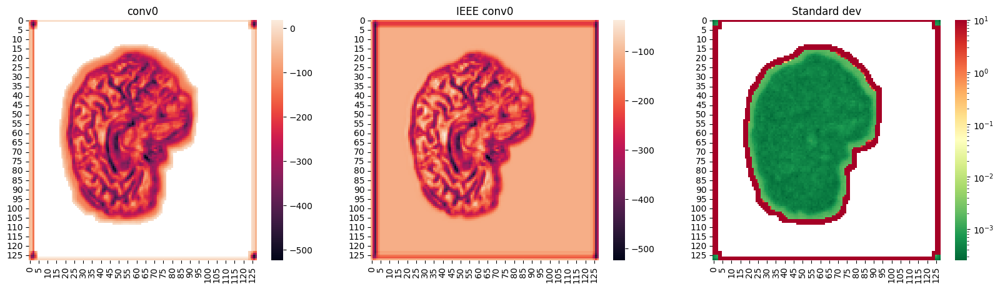

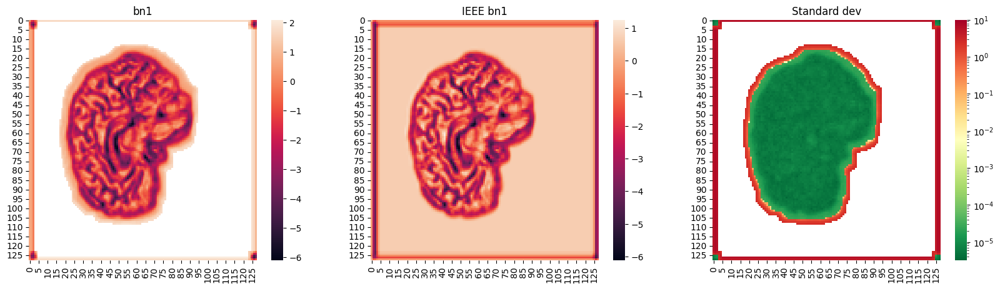

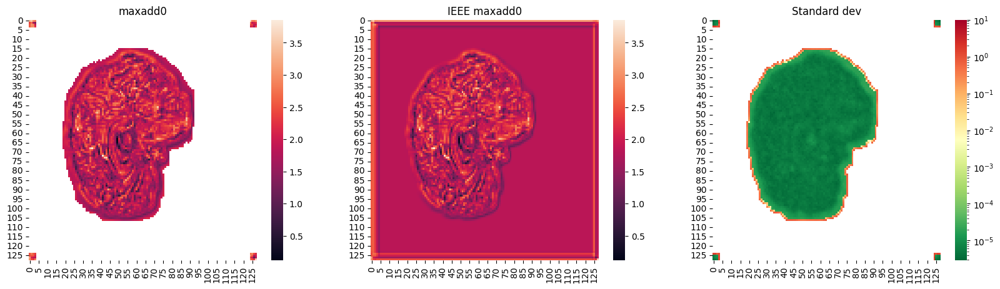

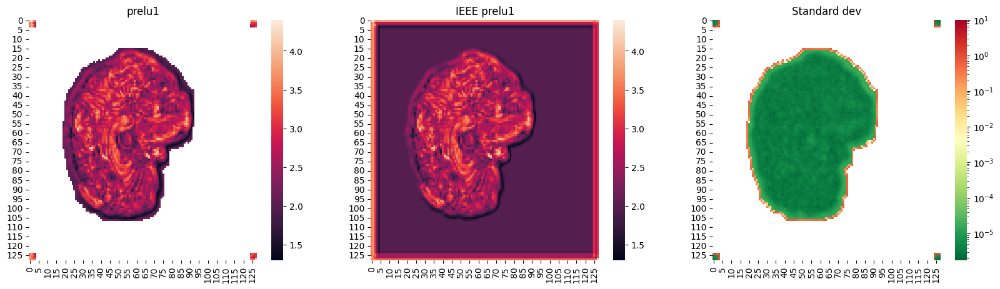

...

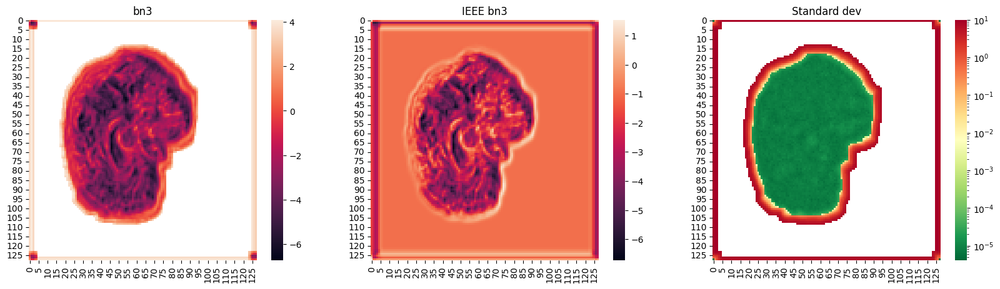

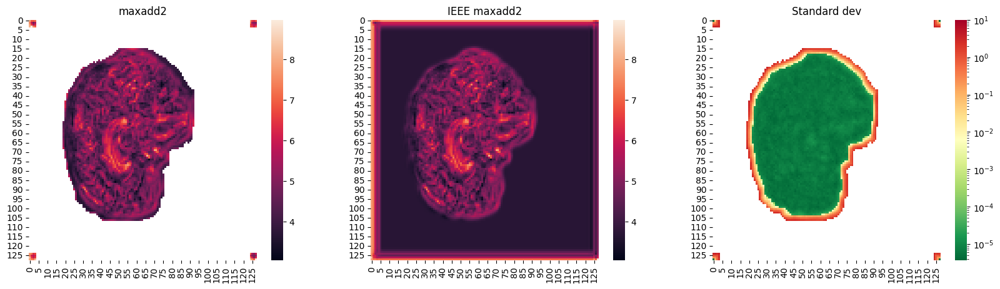

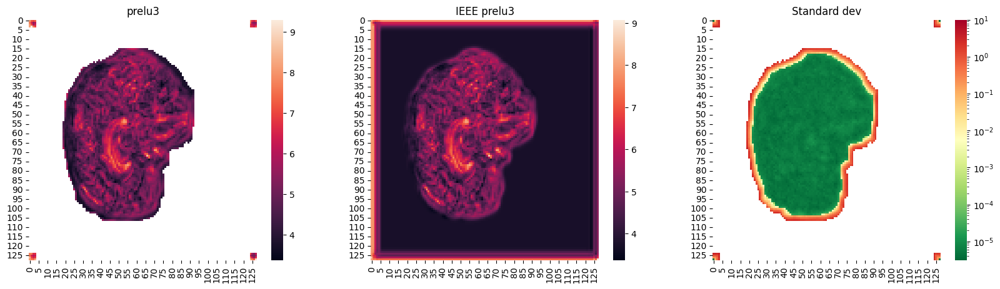

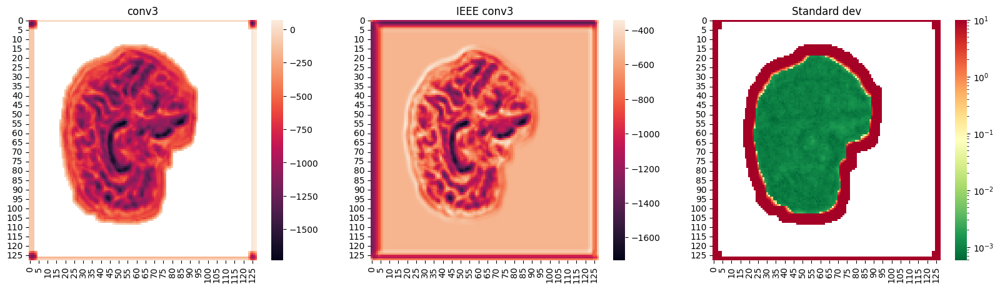

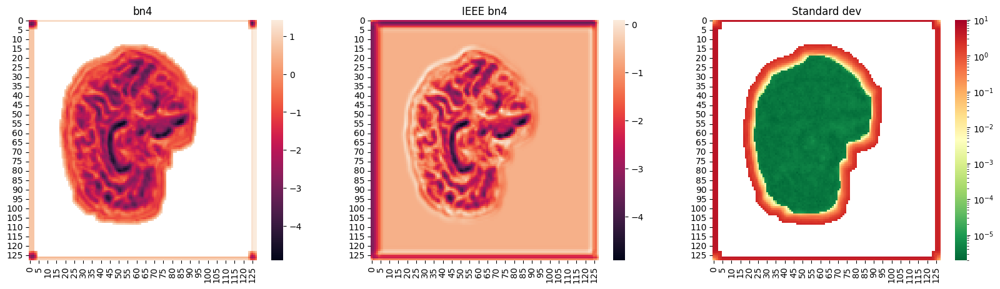

In [ ]:
# for i in ['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'interpol2', 'classifier']:
# for i in ['inp_block', 'encode1', 'encode2']:

#input block/encode1
# for i in ['bn0', 'conv0', 'bn1', 'prelu0', 'conv1', 'bn2', 'maxout0', 'prelu1', 'conv2', 'bn3', 'maxout1', 'prelu2', 'conv3', 'bn4', "pool"]:
#encode2
# for i in ['conv0', 'bn1', 'maxadd0',  'conv1', 'bn2', 'maxadd1', 'conv2', 'bn3', 'maxadd2', 'conv3', 'bn4']:

for i in ['prelu0', 'conv0', 'bn1', 'maxadd0', 'prelu1', 'conv1', 'bn2', 'maxadd1', 'prelu2', 'conv2', 'bn3', 'maxadd2', 'prelu3', 'conv3', 'bn4']:
    if "pool" == i:
         a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/1_encode2_4.pkl', 'rb'))
         ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/ieee_encode2_1.pkl', 'rb'))
    else:
        a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/encode2/1_outp_{i}_4.pkl', 'rb'))
        ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/encode2/ieee_outp_{i}_1.pkl', 'rb'))
    # diff = torch.std(torch.cat((a, ieee), dim=0), dim=0)
    diff = torch.abs(a - ieee)

    fig, axes = plt.subplots(1, 3, figsize=(20,5))
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
    gc.set_title(i)
    gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
    gc.set_title(f'IEEE {i}')
    gc = sns.heatmap(np.mean(diff.detach().numpy().squeeze(), axis=0), norm=LogNorm(vmin=None, vmax=10), cmap='RdYlGn_r', ax=axes[2])
    gc.set_title(f'Standard dev')

    # break
    # plt.figure()


#### Entire Model

##### Threshold 1

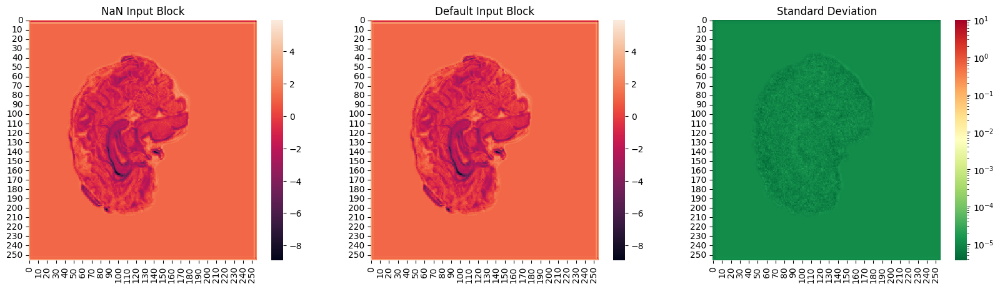

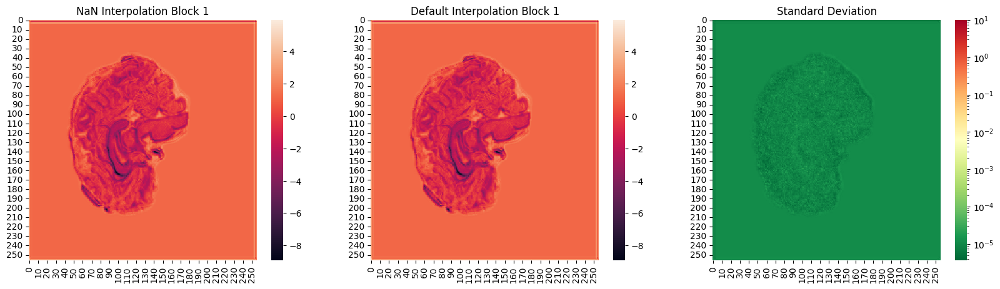

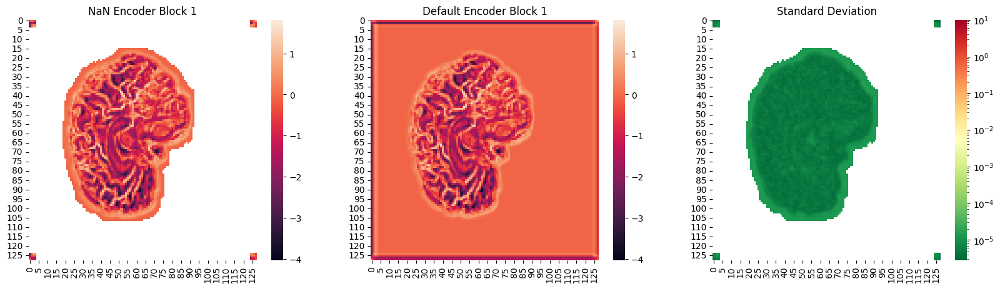

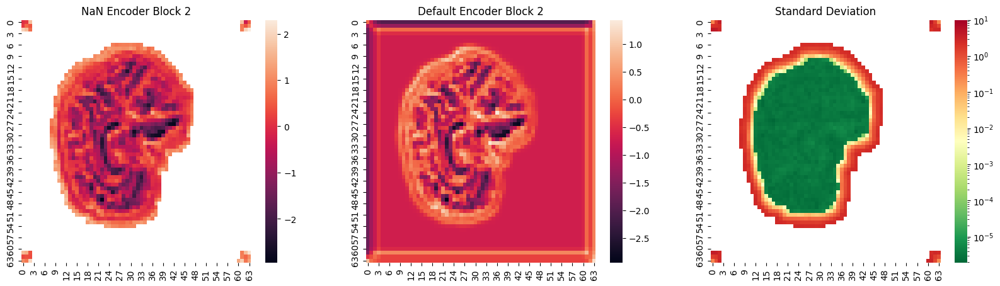

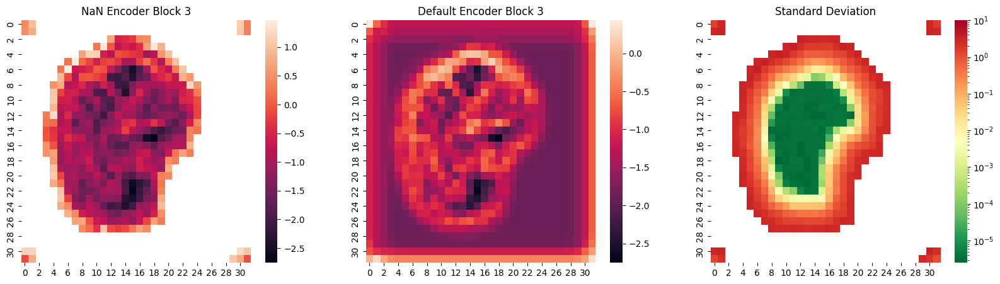

...

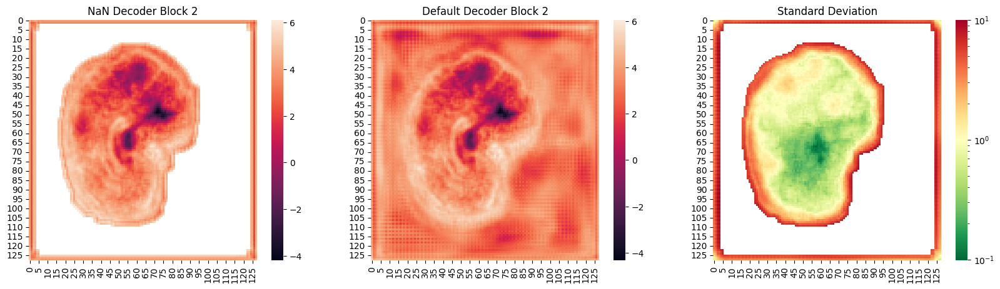

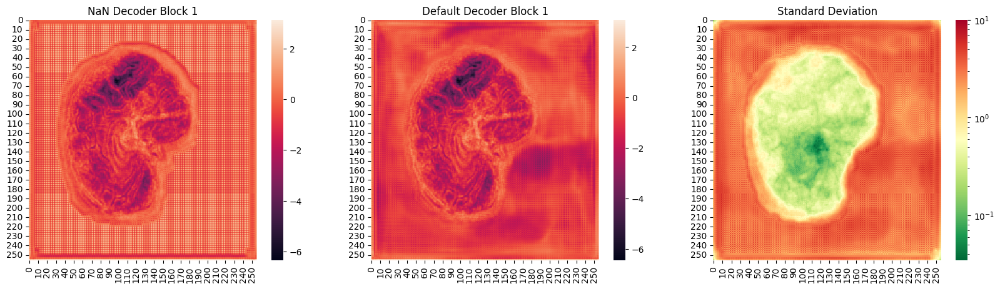

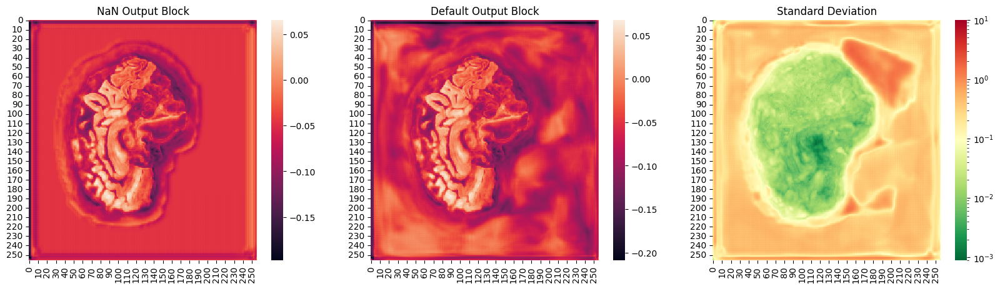

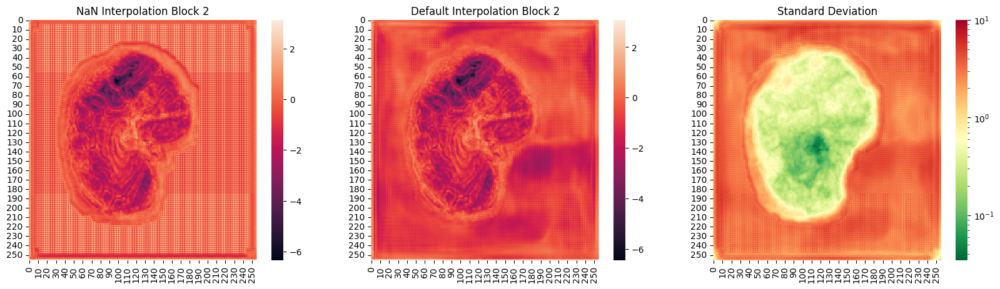

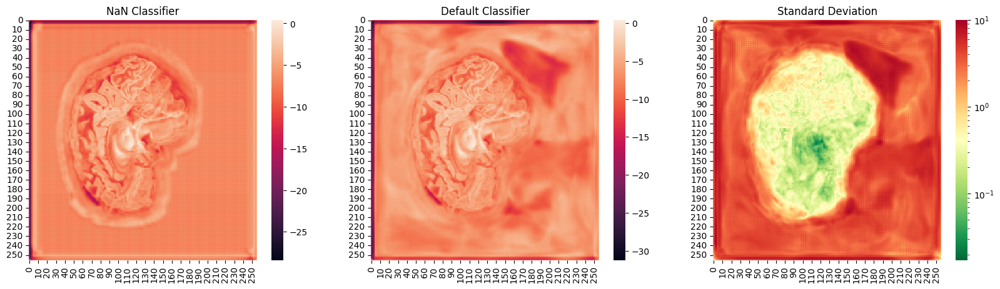

In [27]:
for i in ['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'interpol2', 'classifier']:
# for i in ['encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4']:

    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/1_{i}_4.pkl', 'rb'))
    ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/ieee_{i}_1.pkl', 'rb'))
    # diff = torch.std(torch.cat((a, ieee), dim=0), dim=0)
    diff = torch.abs(a - ieee)

    if i == 'inp_block': 
        tmp = i
        i = 'Input Block'
    elif 'encode' in i: 
        tmp = i
        i = f'Encoder Block {i[-1]}'
    elif 'decoder' in i: 
        tmp = i
        i = f'Decoder Block {i[-1]}'
    elif 'interpol' in i: 
        tmp = i
        i = f'Interpolation Block {i[-1]}'
    elif i == 'outp_block': 
        tmp = i
        i = 'Output Block'
    else: 
        tmp = i
        i = i.title()

    fig, axes = plt.subplots(1, 3, figsize=(20,5))
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
    gc.set_title(f'NaN {i}')
    gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
    gc.set_title(f'Default {i}')
    gc = sns.heatmap(np.mean(diff.detach().numpy().squeeze(), axis=0), norm=LogNorm(vmin=None, vmax=10), cmap='RdYlGn_r', ax=axes[2])
    gc.set_title(f'Standard Deviation')

    # plt.savefig(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/ohbm_postergif/{tmp}.png')
    # break

    # break
    # plt.figure()


##### Threshold 0.5

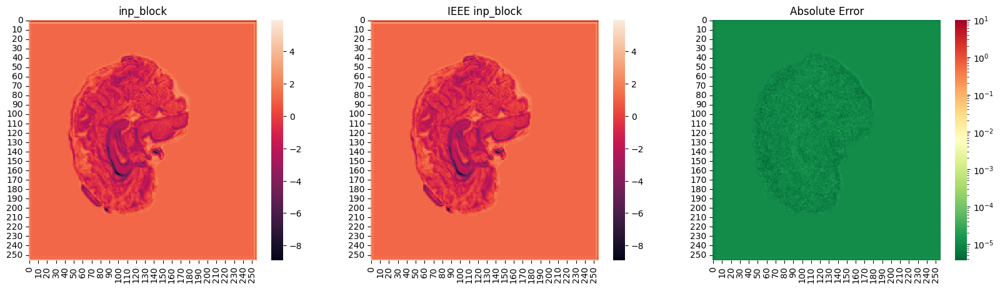

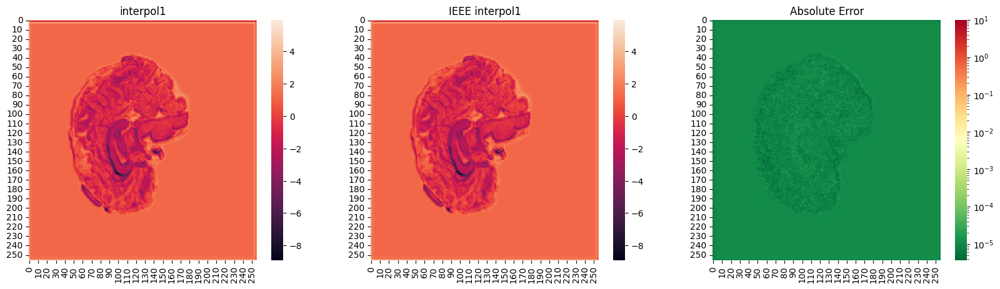

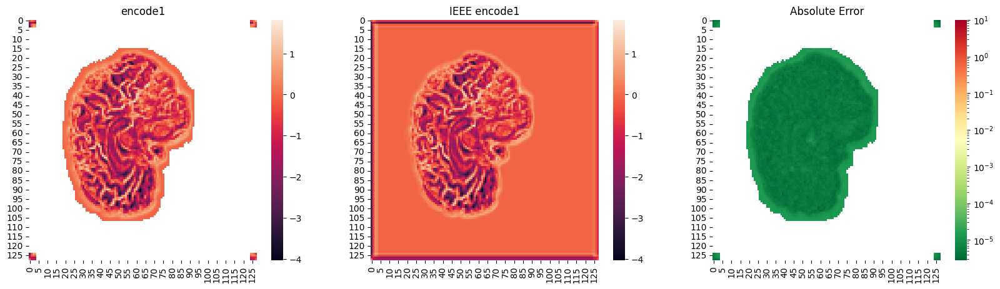

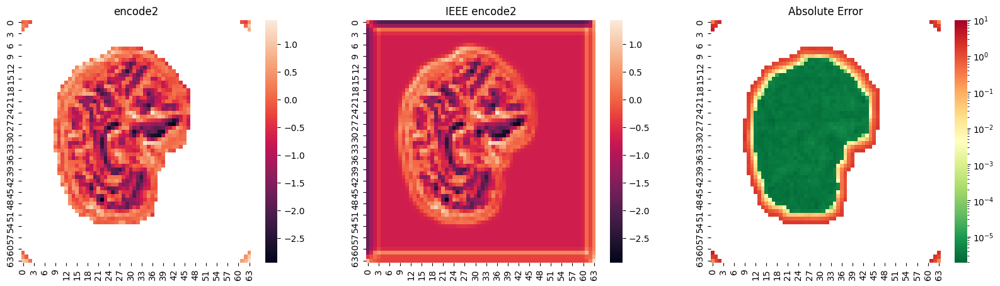

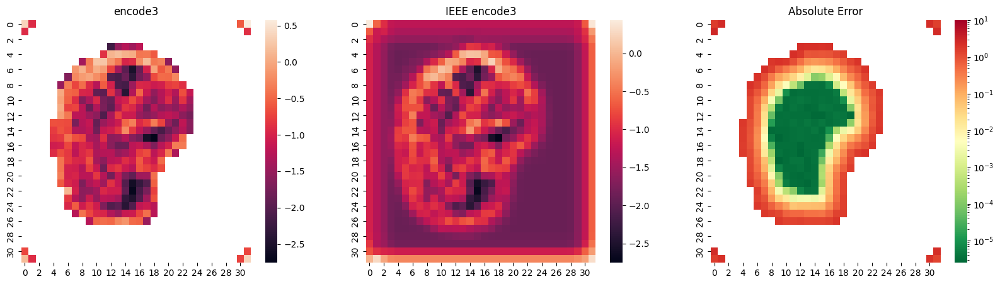

...

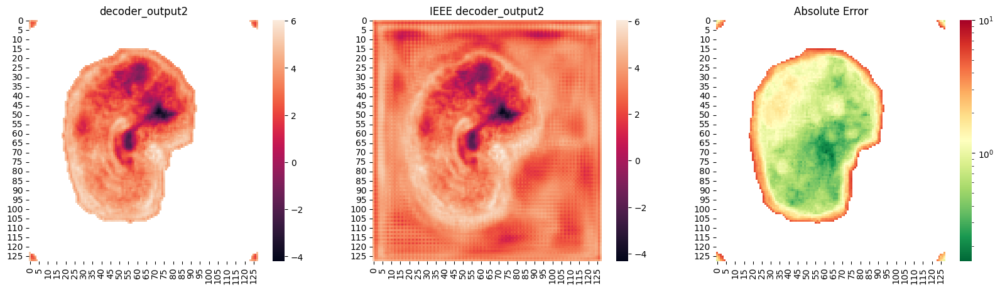

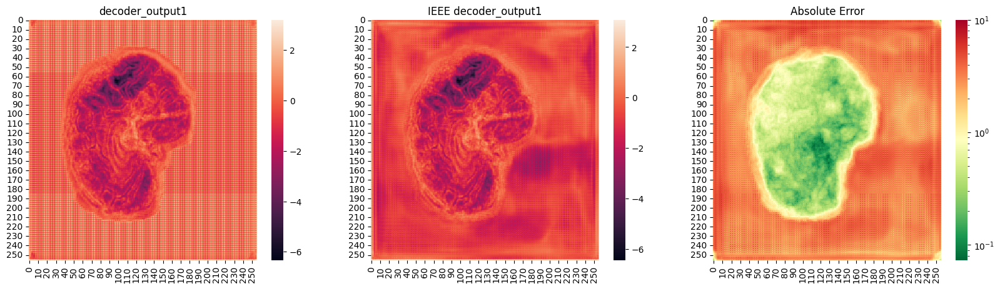

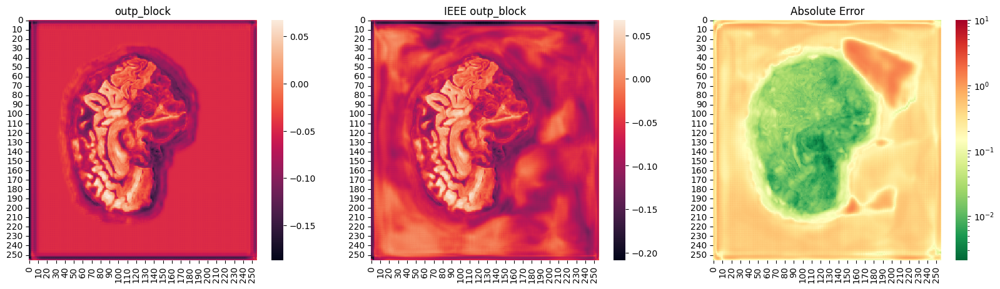

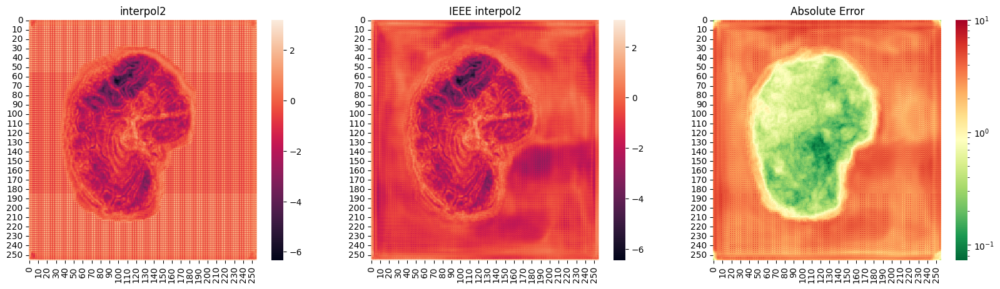

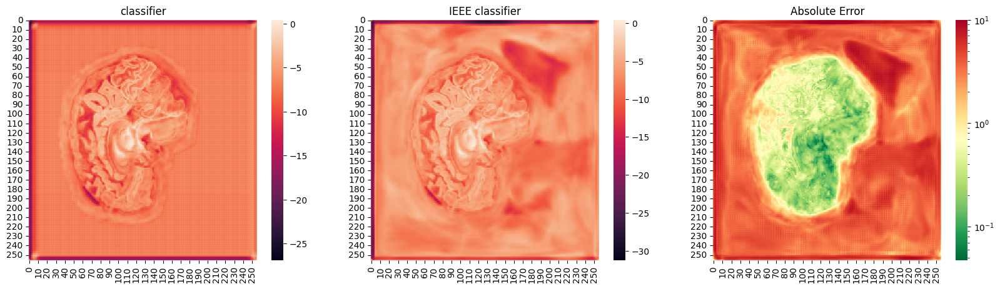

In [ ]:
for i in ['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'interpol2', 'classifier']:
# for i in ['encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4']:

#input block/encode1
# for i in ['bn0', 'conv0', 'bn1', 'prelu0', 'conv1', 'bn2', 'maxout0', 'prelu1', 'conv2', 'bn3', 'maxout1', 'prelu2', 'conv3', 'bn4', "pool"]:
#encode2
# for i in ['conv0', 'bn1', 'maxadd0',  'conv1', 'bn2', 'maxadd1', 'conv2', 'bn3', 'maxadd2', 'conv3', 'bn4']:

# for i in ['prelu0', 'conv0', 'bn1', 'maxadd0', 'prelu1', 'conv1', 'bn2', 'maxadd1', 'prelu2', 'conv2', 'bn3', 'maxadd2', 'prelu3', 'conv3', 'bn4']:
    if "pool" == i:
         a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/1_encode2_4.pkl', 'rb'))
         ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/ieee_encode2_1.pkl', 'rb'))
    else:
        a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/0.5_{i}_3.pkl', 'rb'))
        ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/ieee_{i}_1.pkl', 'rb'))
    # diff = torch.std(torch.cat((a, ieee), dim=0), dim=0)
    diff = torch.abs(a - ieee)

    fig, axes = plt.subplots(1, 3, figsize=(20,5))
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
    gc.set_title(i)
    gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
    gc.set_title(f'IEEE {i}')
    gc = sns.heatmap(np.mean(diff.detach().numpy().squeeze(), axis=0), norm=LogNorm(vmin=None, vmax=10), cmap='RdYlGn_r', ax=axes[2])
    gc.set_title(f'Absolute Error')

    # break
    # plt.figure()


##### Threshold 0.2

/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin =

/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)
/home/ine5/jupyter_nb/lib/python3.10/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin =

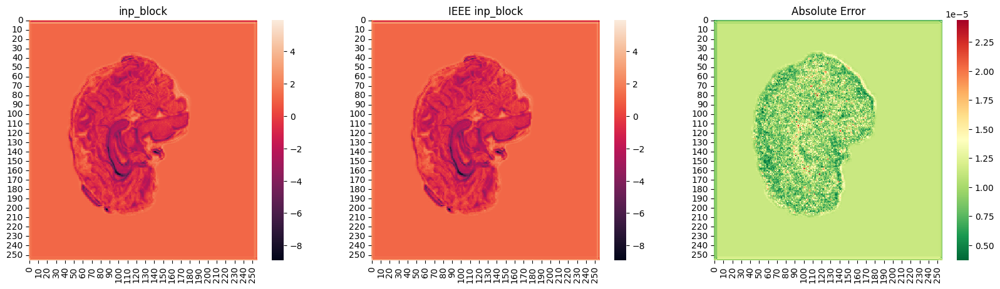

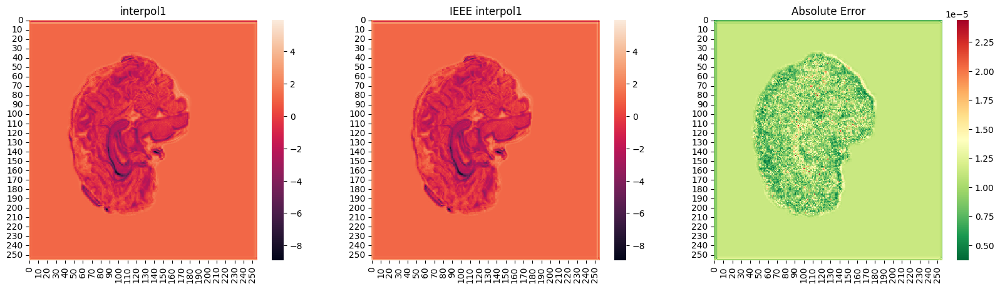

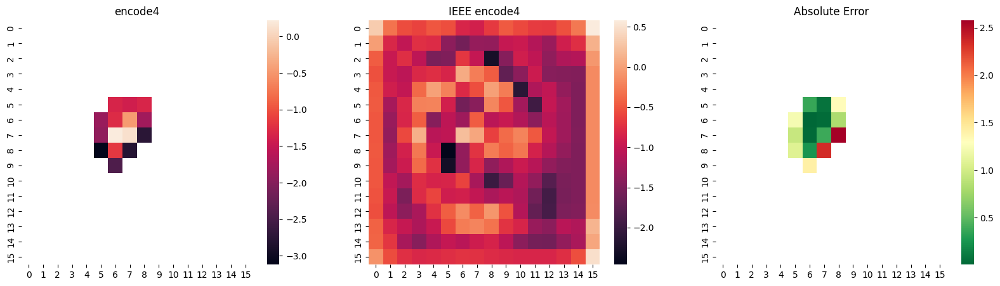

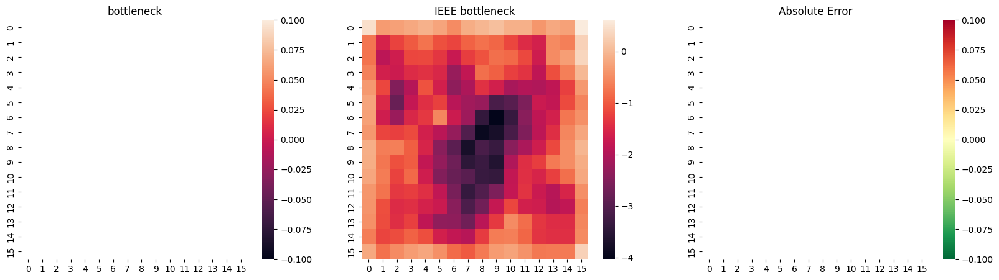

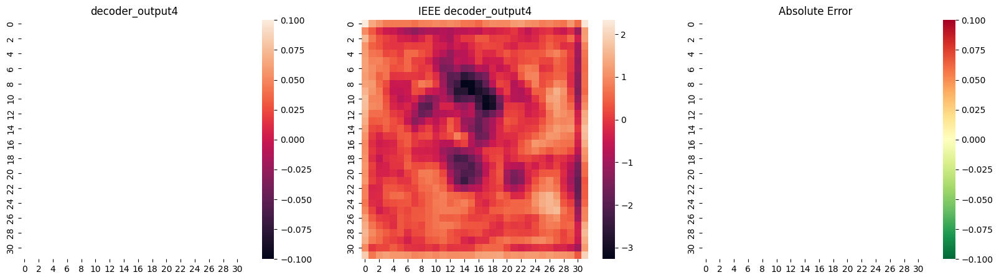

...

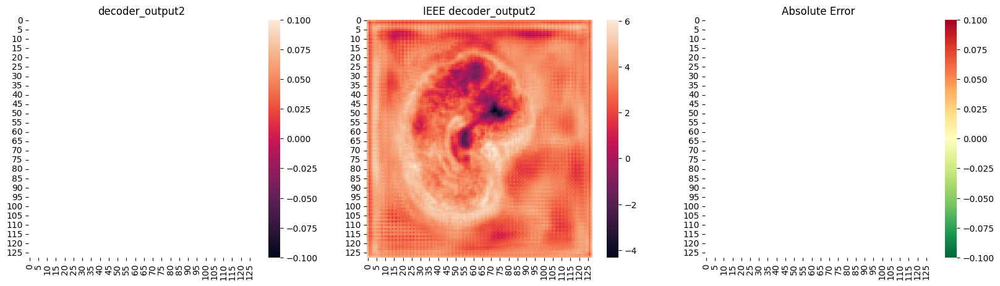

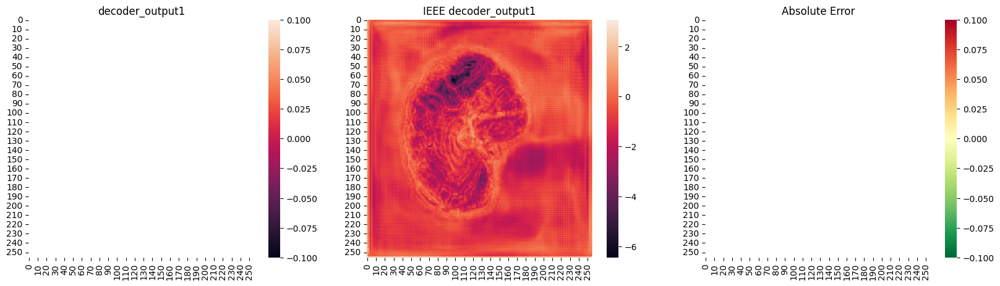

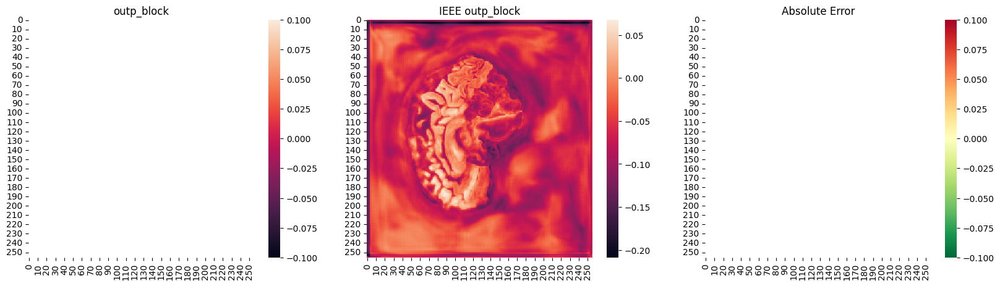

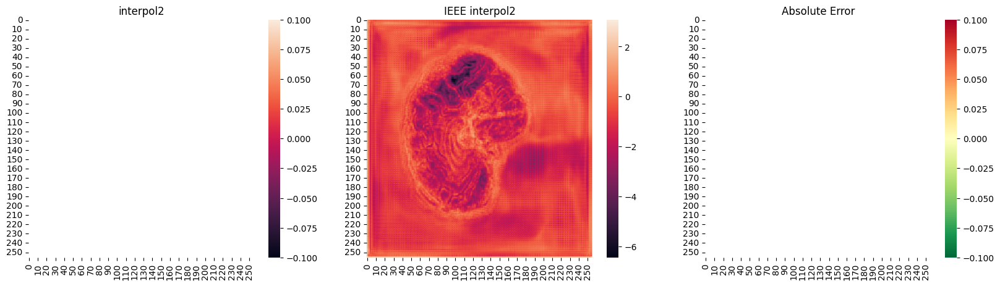

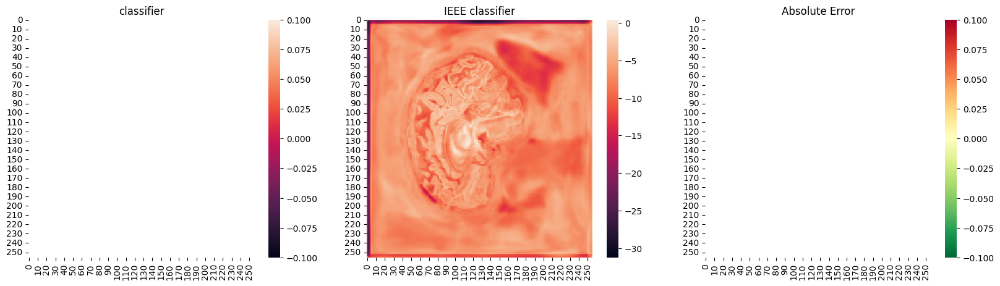

In [ ]:
for i in ['inp_block', 'interpol1', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'interpol2', 'classifier']:
# for i in ['encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4']:

#input block/encode1
# for i in ['bn0', 'conv0', 'bn1', 'prelu0', 'conv1', 'bn2', 'maxout0', 'prelu1', 'conv2', 'bn3', 'maxout1', 'prelu2', 'conv3', 'bn4', "pool"]:
#encode2
# for i in ['conv0', 'bn1', 'maxadd0',  'conv1', 'bn2', 'maxadd1', 'conv2', 'bn3', 'maxadd2', 'conv3', 'bn4']:

# for i in ['prelu0', 'conv0', 'bn1', 'maxadd0', 'prelu1', 'conv1', 'bn2', 'maxadd1', 'prelu2', 'conv2', 'bn3', 'maxadd2', 'prelu3', 'conv3', 'bn4']:
    if "pool" == i:
         a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/1_encode2_4.pkl', 'rb'))
         ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/ieee_encode2_1.pkl', 'rb'))
    else:
        a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/0.2_{i}_2.pkl', 'rb'))
        ieee=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_comparison/ieee_{i}_1.pkl', 'rb'))
    # diff = torch.std(torch.cat((a, ieee), dim=0), dim=0)
    diff = torch.abs(a - ieee)

    fig, axes = plt.subplots(1, 3, figsize=(20,5))
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
    gc.set_title(i)
    gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
    gc.set_title(f'IEEE {i}')
    gc = sns.heatmap(np.mean(diff.detach().numpy().squeeze(), axis=0), cmap='RdYlGn_r', ax=axes[2])

    gc.set_title(f'Absolute Error')

    # break
    # plt.figure()


## NaN BatchNorm -- Abandoned for now
* Batch norm is a learnable layer -- model has learned mean/variance that are no longer applicable
* Current implementation is calculating mean/var for each run of the model -- find good values and simply replace old batch norm with them OR replace them with manual batch norm which also does NaN thresholding (else NaNs disappear) ?

/tmp/ipykernel_4134789/1759020250.py:22: RuntimeWarning: Mean of empty slice
  gc = sns.heatmap(np.nanmean(a2.detach().numpy().squeeze(), axis=0), ax=axes[0])
/tmp/ipykernel_4134789/1759020250.py:24: RuntimeWarning: Mean of empty slice
  gc = sns.heatmap(np.nanmean(a3.detach().numpy().squeeze(), axis=0), ax=axes[1])
/tmp/ipykernel_4134789/1759020250.py:26: RuntimeWarning: Mean of empty slice
  gc = sns.heatmap(np.nanmean(b2.detach().numpy().squeeze(), axis=0), ax=axes[2])


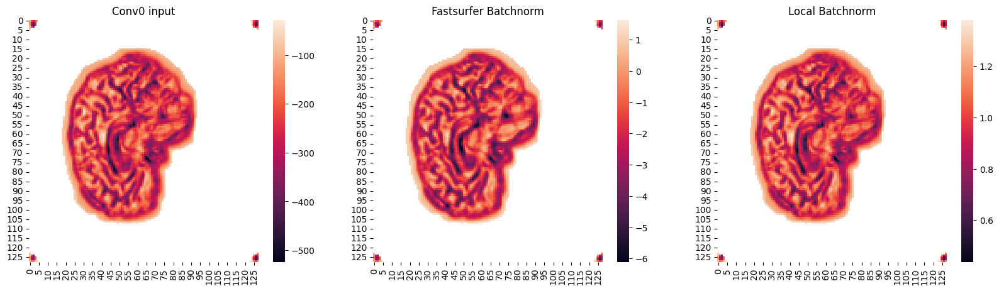

In [ ]:
a1=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanpool_ieee/outp_prelu0_1.pkl', 'rb'))
a2=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanconv_threshold/outp_conv0_1.pkl', 'rb'))
a3=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanconv_threshold/outp_bn0_1.pkl', 'rb'))

m = torch.nn.BatchNorm2d(71, momentum=0)
# self.bn1 = nn.BatchNorm2d(num_features=conv1_in_size)

m.weight = torch.nn.Parameter(torch.full_like(m.weight, 1))
m.bias = torch.nn.Parameter(torch.full_like(m.bias, 1)
)
m.running_mean = torch.full_like(m.running_mean, torch.nanmean(a2))
# print(m.running_mean)
m.running_var = torch.full_like(m.running_var, np.nanvar(a2.numpy()))
# print(m.running_var)
m.eval()
# b1=m(a1)
b2=m(a2)
# b2=m(torch.randn(a2.shape))

fig, axes = plt.subplots(1, 3, figsize=(20,5))

gc = sns.heatmap(np.nanmean(a2.detach().numpy().squeeze(), axis=0), ax=axes[0])
gc.set_title('Conv0 input')
gc = sns.heatmap(np.nanmean(a3.detach().numpy().squeeze(), axis=0), ax=axes[1])
gc.set_title('Fastsurfer Batchnorm');
gc = sns.heatmap(np.nanmean(b2.detach().numpy().squeeze(), axis=0), ax=axes[2])
gc.set_title('Local Batchnorm');
#CAUSE: Running mean/var/stats are different

### Model Lookover -- Ignoring NaN

#### Threshold 1

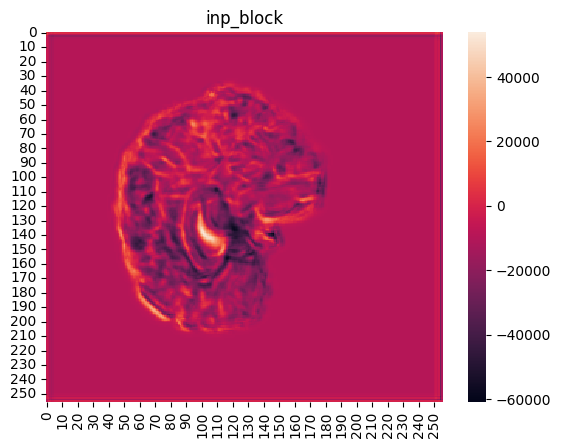

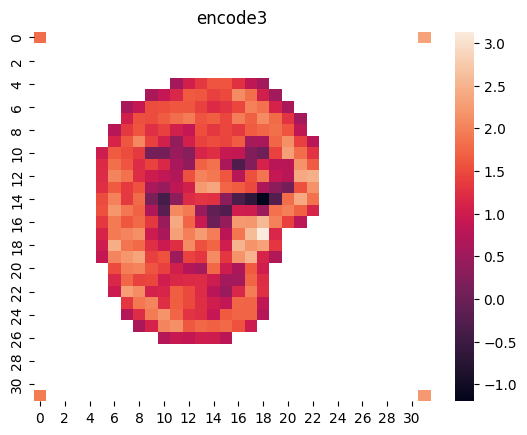

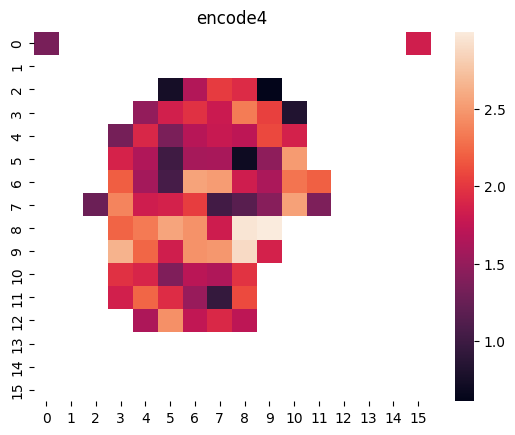

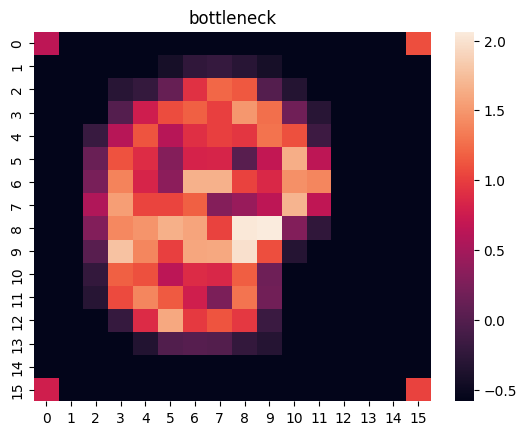

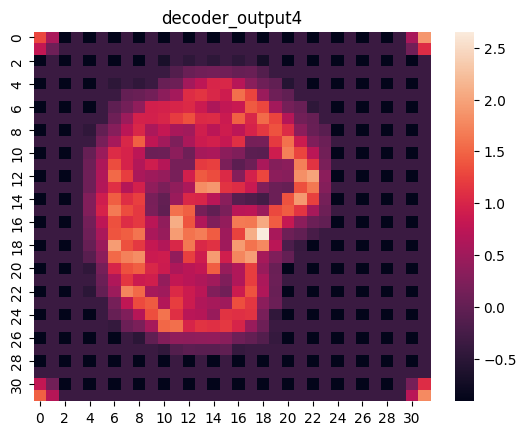

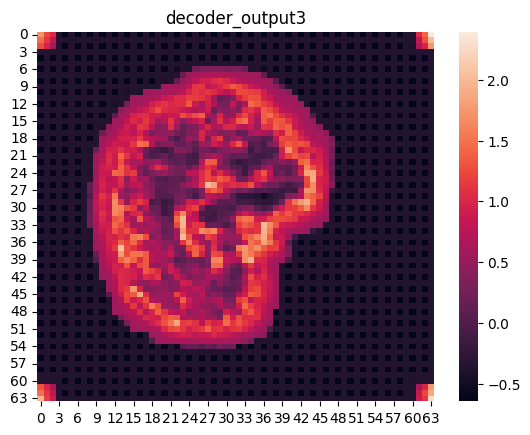

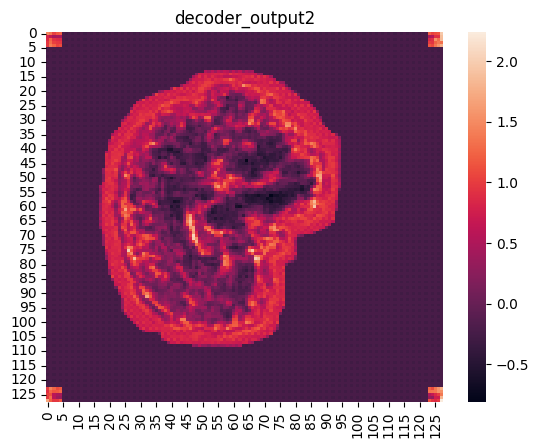

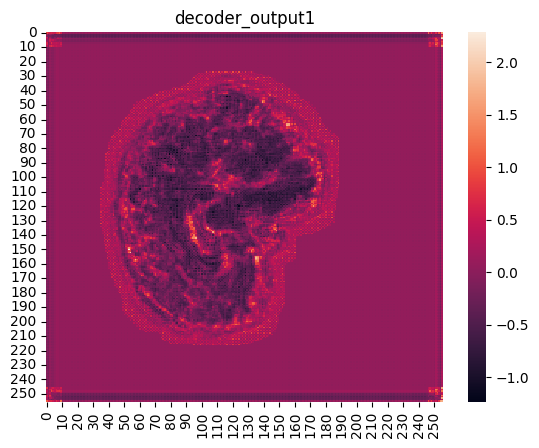

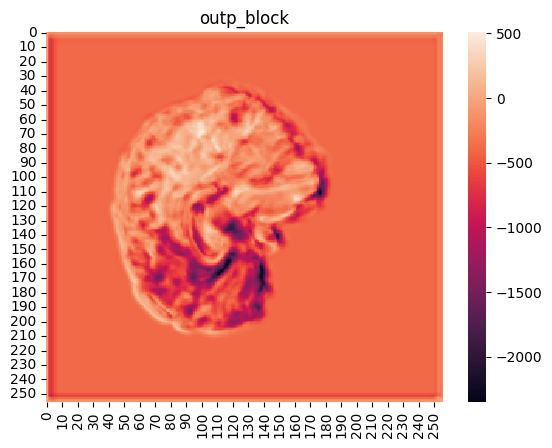

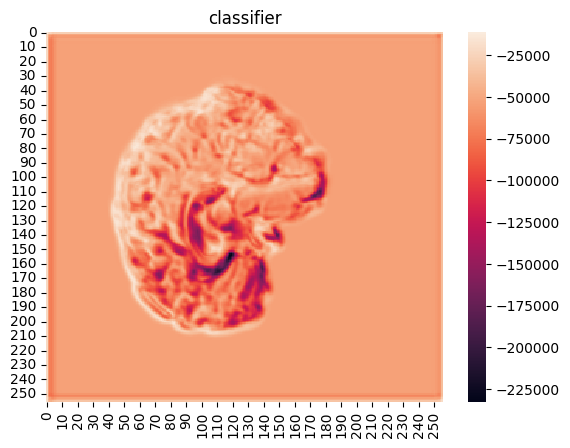

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in ['inp_block', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'classifier']:
    # a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanbatch_sagittal/1_{i}_4.pkl', 'rb'))
    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanbatch_sagittal/1_{i}_4.pkl', 'rb'))

    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0))
    gc.set_title(i)
    plt.figure()


## Preliminary Segmentation Differences

### Segmentation Entropy and Binarized Difference Maps

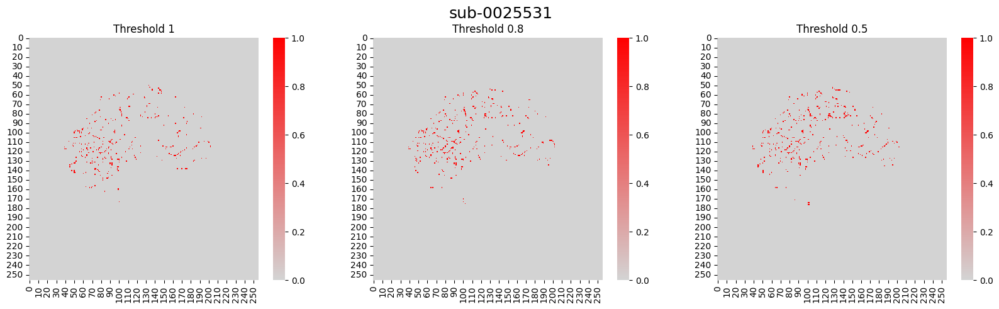

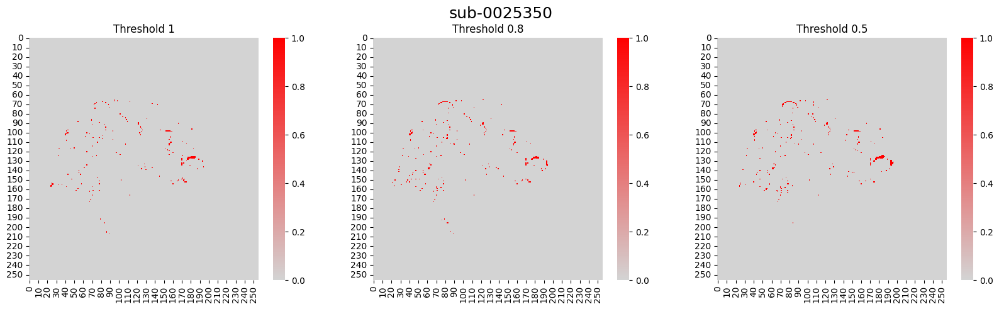

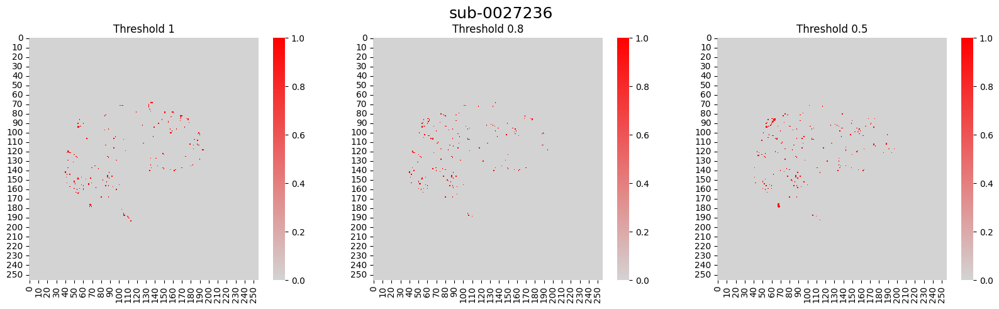

In [ ]:
def visualize_map(subject, maptype='entropy', file_len=4):
    # files = glob.glob(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/maps/{subject}/{maptype}_map_thresh*')

    if file_len == 4:
        entropy_02 = np.load(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/maps/{subject}/{maptype}_map_thresh02.npy')
        
    entropy_1 = np.load(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/maps/{subject}/{maptype}_map_thresh1.npy')
    entropy_05 = np.load(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/maps/{subject}/{maptype}_map_thresh05.npy')
    entropy_08 = np.load(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/maps/{subject}/{maptype}_map_thresh08.npy')


    cmap0 = LinearSegmentedColormap.from_list('', ['lightgray', 'red'])
    
    if file_len == 4:
        fig, axes = plt.subplots(2, 2, figsize=(15,10))
        gc = sns.heatmap(entropy_1[0,:, :], cmap=cmap0, ax=axes[0,0])
        gc.set_title('Threshold 1')
        gc = sns.heatmap(entropy_08[0,:, :], cmap=cmap0, ax=axes[0,1])
        gc.set_title('Threshold 0.8')
        gc = sns.heatmap(entropy_05[0,:, :], cmap=cmap0, ax=axes[1,0])
        gc.set_title('Threshold 0.5');
        gc = sns.heatmap(entropy_02[0,:, :], cmap=cmap0, ax=axes[1,1])
        gc.set_title('Threshold 0.2')
        
        plt.suptitle(f'sub-{subject}', fontsize=18, y=0.95);

    else:
        fig, axes = plt.subplots(1, 3, figsize=(20,5))
        gc = sns.heatmap(entropy_1[0,:, :], cmap=cmap0, ax=axes[0])
        gc.set_title('Threshold 1')
        gc = sns.heatmap(entropy_08[0,:, :], cmap=cmap0, ax=axes[1])
        gc.set_title('Threshold 0.8')
        gc = sns.heatmap(entropy_05[0,:, :], cmap=cmap0, ax=axes[2])
        gc.set_title('Threshold 0.5');

        plt.suptitle(f'sub-{subject}', fontsize=18);

for sub in ['0025531', '0025350', '0027236']:
    visualize_map(sub, 'binary', file_len=3)
    # break


In [5]:
def visualize_fullbrain(seg_dir, map_dir, view='sagittal', subject='0025531'):
    # seg_thresh1 = nib.load(f'{seg_dir}/sub-{subject}/thresh1/{view}/sub-{subject}.nii.gz/mri/aparc.DKTatlas+aseg.deep_1_test.mgz')
    # seg_thresh05 = nib.load(f'{seg_dir}/sub-{subject}/thresh05/{view}/sub-{subject}.nii.gz/mri/aparc.DKTatlas+aseg.deep_0.5_test.mgz')

    # seg_thresh1 = nib.load(f'{seg_dir}/sub-{subject}/thresh1/{view}/sub-{subject}.nii.gz/mri/aseg.auto_noCCseg.mgz')
    seg_thresh1 = nib.load(f'{seg_dir}/sub-{subject}/thresh1/{view}/sub-{subject}.nii.gz/mri/aseg.auto_noCCseg.mgz')
    # seg_thresh05 = nib.load(f'{seg_dir}/sub-{subject}/thresh1/{view}/sub-{subject}.nii.gz/mri/aseg.auto_noCCseg.mgz')

    entropy_1 = np.load(f'{map_dir}/{subject}/fullbrain/binary_map_thresh1_aseg3.npy')
    # entropy_05 = np.load(f'{map_dir}/{subject}/fullbrain/binary_map_thresh1_aseg3.npy')

    header = nib.Nifti1Header().set_data_dtype(np.int64)  # Set data type to int64

    img_thresh1 = nib.nifti1.Nifti1Image(entropy_1, seg_thresh1.affine, dtype=np.int64) 
    # img_thresh05 = nib.nifti1.Nifti1Image(entropy_05, seg_thresh05.affine, dtype=np.int64) 


    cmap0 = LinearSegmentedColormap.from_list('', ['lightgray', 'red'])

    fig, axes = plt.subplots(1, 1, figsize=(20,5))

    # display = plotting.plot_img(img_thresh1, annotate=False, cut_coords=(0,0,100), 
    #                             draw_cross=False, bg_img=None,cmap=cmap0, colorbar=True, 
    #                             title='Threshold 1', axes=axes[0])
    display = plotting.plot_img(img_thresh1, annotate=False, cut_coords=(0,0,100), 
                                draw_cross=False, bg_img=None,cmap=cmap0, colorbar=True, 
                                title='Threshold 1', axes=axes)

**Full Brain View** 

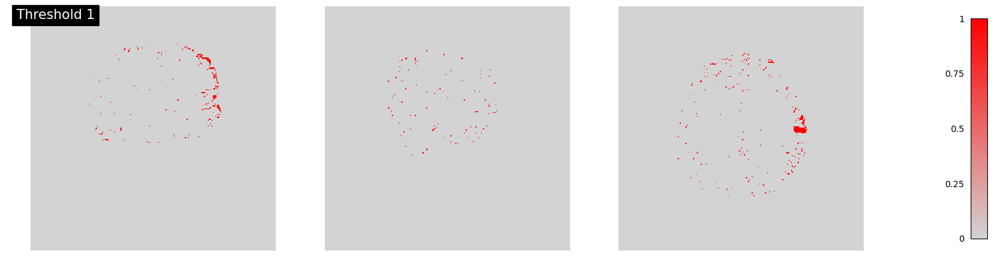

In [6]:
visualize_fullbrain(seg_dir='/scratch/ine5/fastsurfer_embeddings/results/fullbrain', view='', map_dir='/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/maps', subject='0025531')

### FastSurfer Custom Losses
**FastSurfer uses aparc_aseg as ground truth**

#### Tentative Exploration of FastSurfer data loader in order to locate and confirm aparc_aseg is ground truth

In [276]:
from FastSurferCNN.data_loader import loader
from yacs.config import CfgNode as CN
from FastSurferCNN.config.defaults import get_cfg_defaults


cfg = get_cfg_defaults()
cfg.merge_from_file("/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/FastSurferCNN/config/FastSurferVINN.yaml")

# with open("/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/FastSurferCNN/config/FastSurferVINN_sagittal.yaml", 'r') as stream:
#     cfg = yaml.safe_load(stream)

train_loader = loader.get_dataloader(cfg, "train")

# python3 ../FastSurferCNN/generate_hdf5.py \
# --hdf5_name hdf5_sets/training_set.hdf5 \
# --data_dir ~/projects/def-glatard/ine5/fs_seg/1 \
# --pattern "sub-0025531" \
# --plane sagittal \
# --image_name mri/orig.mgz \
# --gt_name mri/aparc.DKTatlas+aseg.mgz \
# --gt_nocc mri/aseg.auto_noCCseg.mgz

KeyError: Unable to open object (object 311 does not exist)
KeyError: Unable to open object (object 320 does not exist)


#### Calculate Loss between FS vs Fast, FS vs NaN and both FastSurfer implementations

In [18]:
os.chdir('..')
from FastSurferCNN.data_loader.data_utils import get_labels_from_lut, unify_lateralized_labels, read_classes_from_lut, map_aparc_aseg2label

sag_mask = ("Left-", "ctx-rh")
combi = ["Left-", "Right-"]
lut = read_classes_from_lut("/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/FastSurferCNN/config/FastSurfer_ColorLUT.tsv")
labels, labels_sag = get_labels_from_lut(lut, sag_mask)
lateralization = unify_lateralized_labels(lut, combi)

# Following loading procedure as done in FastSurfer generate_hdf5 (_load_volumes function) training data loader
#switch out for FreeSurfer subject -- rerun FS?
# aseg = np.asarray(
#     nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/ieee/sub-0025531.nii.gz/mri/aparc.DKTatlas+aseg.deep_v1.mgz').get_fdata(), dtype=np.int16
# )
aseg = np.asarray(
    nib.load('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/aparc.DKTatlas+aseg.mgz').get_fdata(), dtype=np.int16
)

# aseg_nocc = np.asarray(
#     nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/ieee/sub-0025531.nii.gz/mri/aseg.auto_noCCseg_v1.mgz').get_fdata(), dtype=np.int16
# )
aseg_nocc = np.asarray(
    nib.load('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/aseg.auto_noCCseg.mgz').get_fdata(), dtype=np.int16
)
processing= 'aparc'

#Use mapped_aseg_sag for sagittal only
mapped_aseg, mapped_aseg_sag = map_aparc_aseg2label(
                    aseg,
                    labels,
                    labels_sag,
                    lateralization,
                    aseg_nocc,
                    processing=processing,
                )



Text(0.5, 0.98, 'Axial')

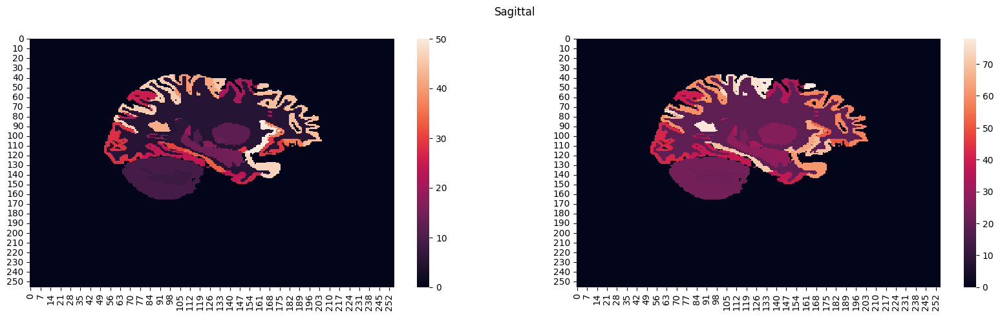

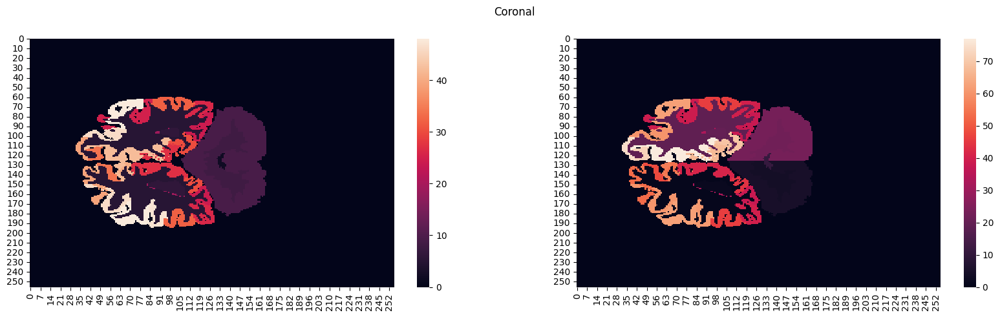

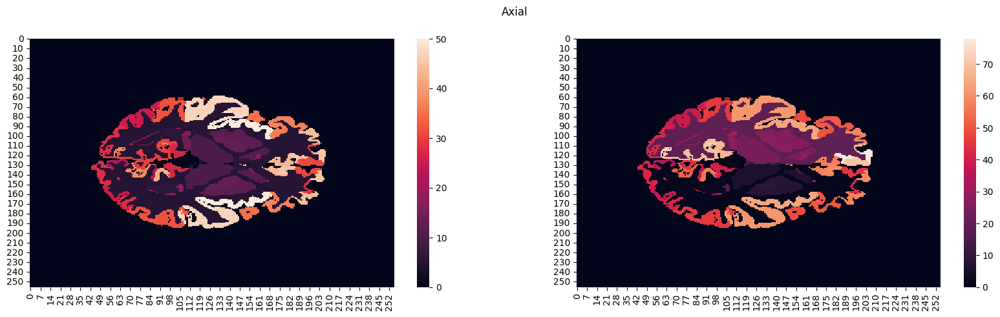

In [14]:
## Visualize segmentations + differences per view especially sagittal
fig, axes = plt.subplots(1,2, figsize=(20,5))
sns.heatmap(mapped_aseg_sag[100], ax=axes[0])
sns.heatmap(mapped_aseg[100], ax=axes[1])
plt.suptitle('Sagittal')

fig, axes = plt.subplots(1,2, figsize=(20,5))
sns.heatmap(mapped_aseg_sag[:, :,100], ax=axes[0])
sns.heatmap(mapped_aseg[:, :, 100], ax=axes[1])
plt.suptitle('Coronal')

fig, axes = plt.subplots(1,2, figsize=(20,5))
sns.heatmap(mapped_aseg_sag[:, 100, :], ax=axes[0])
sns.heatmap(mapped_aseg[:, 100, :], ax=axes[1])
plt.suptitle('Axial')


<Axes: >

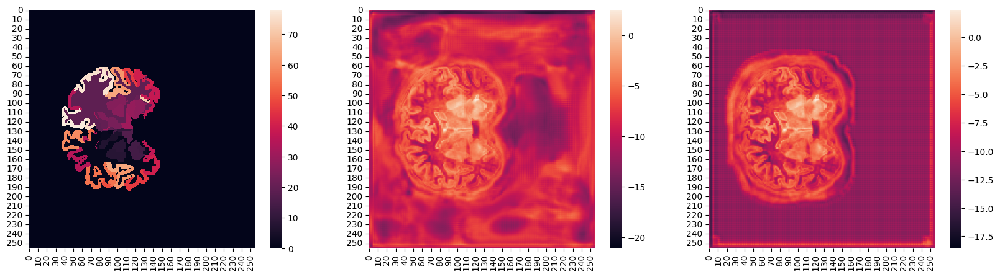

In [40]:
fig, axes = plt.subplots(1,3, figsize=(20,5))

sns.heatmap(mapped_aseg[:, :, 140], ax=axes[0])
classifier_ieee = pickle.load(open(f"/scratch/ine5/fastsurfer_embeddings/results/fullbrain/ieee/sub-0025531.nii.gz/coronal/ieee_classifier_140.pkl", 'rb'))
sns.heatmap(np.mean(classifier_ieee.squeeze().detach().numpy(), axis=0), ax=axes[1])
classifier_thresh1 = pickle.load(open(f"/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/coronal/1_classifier_140.pkl", 'rb'))
sns.heatmap(np.mean(classifier_thresh1.squeeze().detach().numpy(), axis=0), ax=axes[2])


##### Explore Dice loss per class
lower dice loss is better – it is 1 - dice score therefore larger dice score → smaller loss \
Note: Dice loss is weighted down by missing classes that are still considered present for each slice – could be removed with some manipulation

In [ ]:
from torch.nn.modules.loss import _Loss

class DiceLoss(_Loss):
    """
    Dice Loss
    """

    def forward(self, output, target, weights=None, ignore_index=None):
        """
        :param output: N x C x H x W Variable
        :param target: N x C x W LongTensor with starting class at 0
        :param weights: C FloatTensor with class wise weights
        :param int ignore_index: ignore label with index x in the loss calculation
        :return:
        """
        eps = 0.001

        encoded_target = output.detach() * 0

        if ignore_index is not None:
            mask = target == ignore_index
            target = target.clone()
            target[mask] = 0
            encoded_target.scatter_(1, target.unsqueeze(1), 1)
            mask = mask.unsqueeze(1).expand_as(encoded_target)
            encoded_target[mask] = 0

        else:
            encoded_target.scatter_(1, target.unsqueeze(1), 1)

        if weights is None:
            weights = 1

        intersection = output * encoded_target
        numerator = 2 * intersection.sum(0).sum(1).sum(1)
        denominator = output + encoded_target

        if ignore_index is not None:
            denominator[mask] = 0

        denominator = denominator.sum(0).sum(1).sum(1) + eps
        
        df = pd.DataFrame({'keys': np.arange(len((numerator / denominator)) ), 'Prob Dice scores': (numerator / denominator) })

        # print((numerator / denominator))
        loss_per_channel = weights * (
            1 - (numerator / denominator)
        )  # Channel-wise weights
        print(loss_per_channel, output.size(1))

        # return loss_per_channel.sum() / output.size(1)
        return loss_per_channel, df 


class CrossEntropy2D(nn.Module):
    """
    2D Cross-entropy loss implemented as negative log likelihood
    """

    def __init__(self, weight=None, reduction="none"):
        super(CrossEntropy2D, self).__init__()
        self.nll_loss = nn.CrossEntropyLoss(weight=weight, reduction=reduction)
        print(
            f"Initialized {self.__class__.__name__} with weight: {weight} and reduction: {reduction}"
        )

    def forward(self, inputs, targets):
        return self.nll_loss(inputs, targets)


class CombinedLoss(nn.Module):
    """
    For CrossEntropy the input has to be a long tensor
    Args:
        -- inputx N x C x H x W
        -- target - N x H x W - int type
        -- weight - N x H x W - float
    """

    def __init__(self, weight_dice=1, weight_ce=1):
        super(CombinedLoss, self).__init__()
        self.cross_entropy_loss = CrossEntropy2D()
        self.dice_loss = DiceLoss()
        self.weight_dice = weight_dice
        self.weight_ce = weight_ce

    def forward(self, inputx, target, weight):
        # Typecast to long tensor --> labels are bytes initially (uint8),
        # index operations require LongTensor in pytorch
        target = target.type(torch.LongTensor)
        # Due to typecasting above, target needs to be shifted to gpu again
        if inputx.is_cuda:
            target = target.cuda()

        input_soft = F.softmax(inputx, dim=1)  # Along Class Dimension
        # dice_val = torch.mean(self.dice_loss(input_soft, target))
        dice_val, df= self.dice_loss(input_soft, target)
        dice_val = torch.mean(dice_val)
        ce_val = torch.mean(
            torch.mul(self.cross_entropy_loss.forward(inputx, target), weight)
        )
        total_loss = torch.add(
            torch.mul(dice_val, self.weight_dice), torch.mul(ce_val, self.weight_ce)
        )

        return total_loss, dice_val, ce_val, df
    

loss = CombinedLoss()

aseg_slice = torch.tensor(mapped_aseg[:, :, 140]).unsqueeze(0)
# mask = mapped_aseg[:, :, 140] * (mapped_aseg[:, :, 140] == 1)
# masked_output = np.where(mask, mapped_aseg[:, :, 140], 70)

# aseg_slice = torch.tensor( masked_output ).unsqueeze(0)

#calculate loss between model prediction slices and FreeSurfer
classifier_thresh1 = pickle.load(open(f"/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/coronal/1_classifier_{140}.pkl", 'rb'))
# classifier_ieee = pickle.load(open(f"/scratch/ine5/fastsurfer_embeddings/results/fullbrain/ieee/sub-0025531.nii.gz/coronal/ieee_classifier_{140}.pkl", 'rb'))
total_loss, dice_val, ce_val, df = loss( classifier_thresh1, aseg_slice, weight=1) #, loss( classifier_ieee, aseg_slice, weight=1)

Initialized CrossEntropy2D with weight: None and reduction: none
tensor([0.0031, 0.0426, 0.0459, 0.2189, 1.0000, 1.0000, 0.1408, 0.0935, 0.0534,
        0.0741, 0.1284, 1.0000, 1.0000, 0.4199, 0.1315, 0.2237, 1.0000, 0.0856,
        0.1341, 0.0460, 0.0372, 0.2042, 1.0000, 1.0000, 0.0942, 0.0704, 0.0767,
        0.0680, 0.2240, 0.1940, 1.0000, 0.1185, 0.3286, 0.3403, 0.4653, 0.1146,
        1.0000, 0.1856, 0.7853, 1.0000, 0.2935, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.1023, 1.0000, 1.0000, 0.9931, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9085, 0.1206, 1.0000, 1.0000, 1.0000, 0.0871, 1.0000, 0.0679, 1.0000,
        0.2283, 0.0606, 0.9592, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9961,
        1.0000, 1.0000, 0.4918, 0.7555, 0.1923, 1.0000, 0.1071]) 79


In [ ]:
for k in  df['keys']:
    if k in list(set(mapped_aseg[:, :, 140].ravel())): 
        continue

    i = df[((df['keys'] == k) &( df['Prob Dice scores'] == 0.))].index
    df = df.drop(i)
print(f"Corrected Average Dice Score Excluding Classes: {df.mean()['Prob Dice scores']:.2f}, Original Average Dice Score: {dice_val:.2f}")

Corrected Average Dice Score Excluding Classes: 0.74, Original Average Dice Score: 0.58


##### Calculate Losses

In [19]:
os.chdir('..')
from FastSurferCNN.models.losses import CombinedLoss

fs_thresh1 = {'coronal': np.zeros((256,3)), 'axial': np.zeros((256,3)), 'sagittal': np.zeros((256,3))}
fs_ieee = {'coronal': np.zeros((256,3)), 'axial': np.zeros((256,3)), 'sagittal': np.zeros((256,3))}
loss = CombinedLoss()

# aseg_nocc = torch.tensor(
#     nib.load('/home/ine5/projects/def-glatard/ine5/fs_seg/1/sub-0025531/mri/aseg.auto_noCCseg.mgz').get_fdata(), dtype=torch.int16
# ).unsqueeze(0)

for plane in fs_thresh1.keys():
#     print(plane)
# for plane in ['sagittal']:
    for i in range(256):
        if plane == 'coronal': aseg_slice = torch.tensor(mapped_aseg[:, :, i]).unsqueeze(0)
        elif plane == 'axial': 
            aseg_slice = torch.tensor(mapped_aseg[:, i, :]).T.unsqueeze(0)
        elif plane == 'sagittal': aseg_slice = torch.tensor(mapped_aseg_sag[i].T).unsqueeze(0)

        #calculate loss between model prediction slices and FreeSurfer
        classifier_thresh1 = pickle.load(open(f"/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/{plane}/1_classifier_{i}.pkl", 'rb'))
        classifier_ieee = pickle.load(open(f"/scratch/ine5/fastsurfer_embeddings/results/fullbrain/ieee/sub-0025531.nii.gz/{plane}/ieee_classifier_{i}.pkl", 'rb'))
        if plane == 'sagittal':
            fs_thresh1[plane][i, :] = list(loss( classifier_thresh1, aseg_slice, weight=1))
        else: fs_thresh1[plane][i, :] = list(loss( classifier_thresh1, aseg_slice, weight=1))
        fs_ieee[plane][i, :] = list(loss( classifier_ieee, aseg_slice, weight=1))
        print(i)


Initialized CrossEntropy2D with weight: None and reduction: none
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
0
1
2
3
4
5
6
7
8
9
1

**Average Across Views**

(Text(0.5, 0, 'Brain Slices'), Text(0, 0.5, 'Loss'))

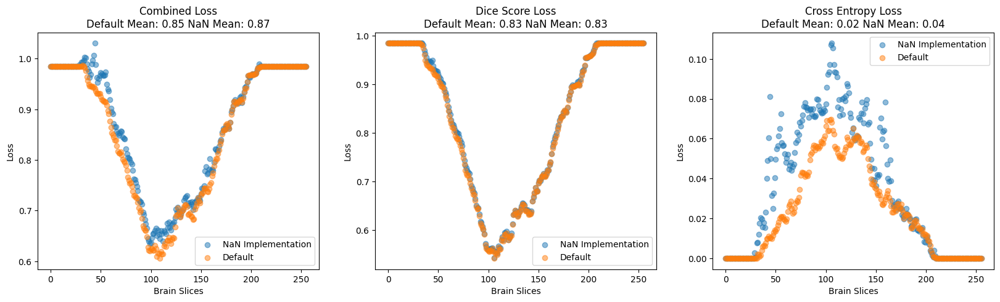

In [5]:
fig, axes = plt.subplots(1,3, figsize=(20,5))

combo_ieee = np.array(list(fs_ieee.values()))[:,:, 0].mean(axis=0)
dice_ieee = np.array(list(fs_ieee.values()))[:,:, 1].mean(axis=0)
ce_ieee = np.array(list(fs_ieee.values()))[:,:, 2].mean(axis=0)

combo_thresh1 = np.array(list(fs_thresh1.values()))[:,:, 0].mean(axis=0)
dice_thresh1 = np.array(list(fs_thresh1.values()))[:,:, 1].mean(axis=0)
ce_thresh1 = np.array(list(fs_thresh1.values()))[:,:, 2].mean(axis=0)

axes[0].scatter(np.arange(len(combo_thresh1)), combo_thresh1, label='NaN Implementation', alpha=0.5)
axes[0].scatter(np.arange(len(combo_ieee)), combo_ieee, label='Default', alpha=0.5)
axes[0].set_title(f'Combined Loss\nDefault Mean: {np.mean(combo_ieee):.2f} NaN Mean: {np.mean(combo_thresh1):.2f}'), axes[0].legend()
axes[0].set_xlabel('Brain Slices'), axes[0].set_ylabel('Loss')

axes[1].scatter(np.arange(len(dice_thresh1)), dice_thresh1, label='NaN Implementation', alpha=0.5)
axes[1].scatter(np.arange(len(dice_ieee)), dice_ieee, label='Default', alpha=0.5)
axes[1].set_title(f'Dice Score Loss\nDefault Mean: {np.mean(dice_ieee):.2f} NaN Mean: {np.mean(dice_thresh1):.2f}'), axes[1].legend()
axes[1].set_xlabel('Brain Slices'), axes[1].set_ylabel('Loss')

axes[2].scatter(np.arange(len(ce_thresh1)), ce_thresh1, label='NaN Implementation', alpha=0.5)
axes[2].scatter(np.arange(len(ce_ieee)), ce_ieee, label='Default', alpha=0.5)
axes[2].set_title(f'Cross Entropy Loss\nDefault Mean: {np.mean(ce_ieee):.2f} NaN Mean: {np.mean(ce_thresh1):.2f}'), axes[2].legend();
axes[2].set_xlabel('Brain Slices'), axes[2].set_ylabel('Loss')

# plt.suptitle('Average Across Views', fontsize=15);


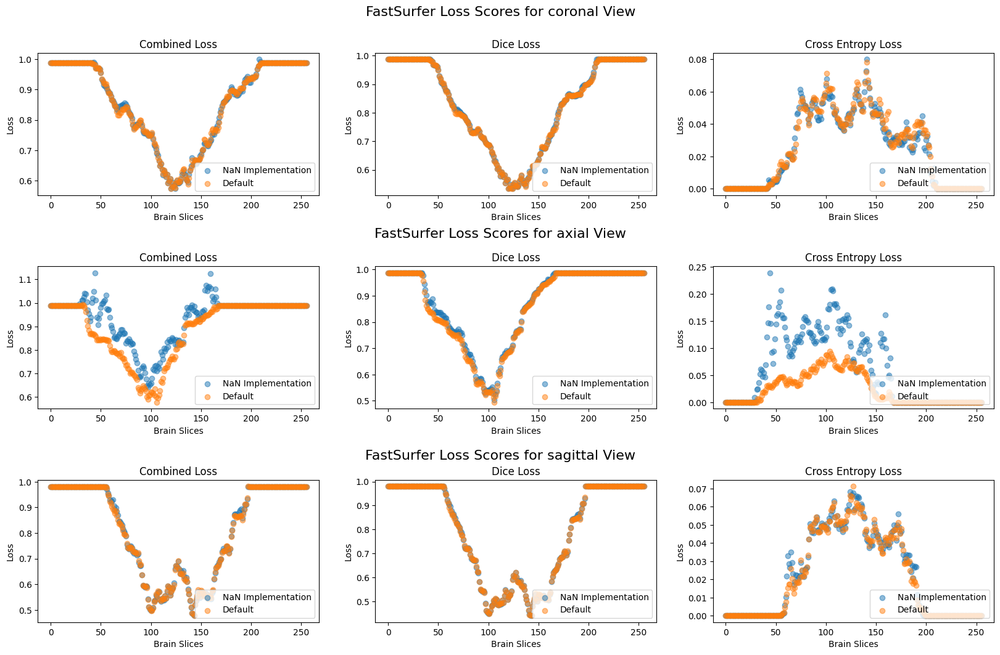

In [20]:
fig, axes = plt.subplots(3,3, figsize=(20,12), gridspec_kw={'height_ratios': [1, 1, 1], 'hspace': 0.5} )

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):

    axes[num, 0].scatter(np.arange(len(fs_thresh1[plane][:, 0])), fs_thresh1[plane][:, 0], label='NaN Implementation', alpha=0.5)
    axes[num, 0].scatter(np.arange(len(fs_ieee[plane][:, 0])), fs_ieee[plane][:, 0], label='Default', alpha=0.5)
    axes[num, 0].set_title('Combined Loss'), axes[num, 0].legend(loc='lower right')
    axes[num, 0].set_xlabel('Brain Slices'), axes[num, 0].set_ylabel('Loss')

    axes[num, 1].scatter(np.arange(len(fs_thresh1[plane][:, 1])), fs_thresh1[plane][:, 1], label='NaN Implementation', alpha=0.5)
    axes[num, 1].scatter(np.arange(len(fs_ieee[plane][:, 1])), fs_ieee[plane][:, 1], label='Default', alpha=0.5)
    axes[num, 1].set_title('Dice Loss'), axes[num, 1].legend(loc='lower right')
    axes[num, 1].set_xlabel('Brain Slices'), axes[num, 1].set_ylabel('Loss')

    axes[num, 2].scatter(np.arange(len(fs_thresh1[plane][:, 2])), fs_thresh1[plane][:, 2], label='NaN Implementation', alpha=0.5)
    axes[num, 2].scatter(np.arange(len(fs_ieee[plane][:, 2])), fs_ieee[plane][:, 2], label='Default', alpha=0.5)
    axes[num, 2].set_title('Cross Entropy Loss'), axes[num, 2].legend(loc='lower right')
    axes[num, 2].set_xlabel('Brain Slices'), axes[num, 2].set_ylabel('Loss')

    # fig.suptitle(f'FastSurfer Loss Scores for {plane} View');
    fig.text(0.5, 0.93 - num*0.3, f'FastSurfer Loss Scores for {plane} View', ha='center', fontsize=16);
    # fig.tight_layout(rect=[4, 4, 4, 8]);



#### Dice Score Compared to FreeSurfer distribution

**Use FastSurfer Dice or FreeSurfer mri_seg_overlap (as in MICCAI paper)?**

*To run mri_seg_overlap* \
apptainer exec -B /scratch/ine5/fastsurfer_embeddings/results/fullbrain:/data -B /home/ine5/projects/def-glatard/ine5/fs_seg/1/sub-0025531/mri/:/ref  \
-B /scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores:/root \
~/projects/def-glatard/ine5/freesurfer2.sif \
mri_seg_overlap /ref/aseg.auto_noCCseg.mgz /data/sub-0025531/thresh1/sub-0025531/mri/aseg.auto_noCCseg.mgz \
-o /root/dice_full_fs_nan_mca.json
\
\
**To run mri_seg overlap with IEEE reference value** \
`
apptainer exec -B /scratch/ine5/fastsurfer_embeddings/results/fullbrain:/data -B /scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/:/ref  \
-B /scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores:/root \
~/projects/def-glatard/ine5/freesurfer2.sif \
mri_seg_overlap /ref/aseg.auto_noCCseg.mgz /data/sub-0025531/thresh1/sub-0025531/mri/aseg.auto_noCCseg.mgz \
-o /root/dice_full_fs_nan_ieee.json
`
\
\
**To move between NaN and normal FastSurfer files switch out** \
`/data/sub-0025531/thresh1/sub-0025531/mri/aseg.auto_noCCseg.mgz` for \
`/data/sub-0025531/ieee4/norm/mri/aseg.auto_noCCseg.mgz`

In [9]:
ref = nib.load('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/aseg.auto_noCCseg.mgz').get_fdata()
ref_labels = set(ref.ravel())

fast = nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/norm.mgz/mri/aseg.auto_noCCseg.mgz').get_fdata()
fast_labels = set(fast.ravel())

ref_labels - fast_labels
# 30 = Left vessel
# 62 = Right vessel
# 85 = Optic chiasm


{30.0, 62.0, 85.0}

,Stats,Fast vs NaN Dice,FS vs NaN Dice,FS vs Fast Dice
0,mean,0.988984,0.802767,0.802502
1,std,0.011892,0.246223,0.246183
2,weighted-mean,0.982538,0.884356,0.888531


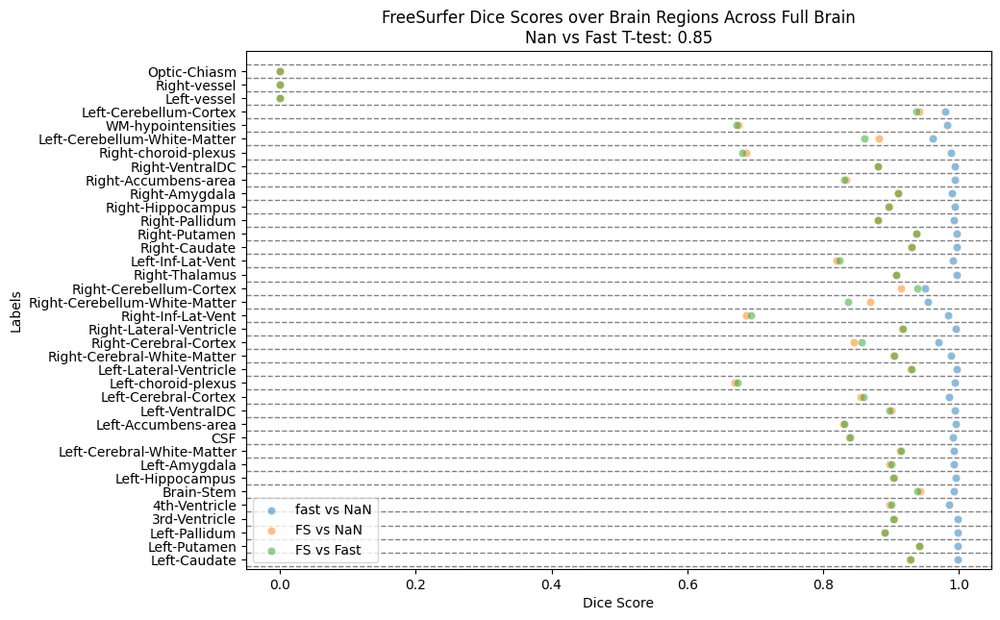

In [28]:
def process_fs_dice(filename):
    df = {}
    df_stats = {}
    names = {}

    file = json.load(open(filename))

    for name, scores in file['measures']['dice'].items():
        if name == 'labels':
            for label, score in scores.items():
                df[int(label)] = [score]
        else:
            df_stats[name] = [scores]

    for code, label in file['names'].items():
        names[int(code)] = [label]

    names = pd.DataFrame(names).T.reset_index().rename(columns={'index':'Code', 0:'Labels'})
    df = pd.DataFrame(df).T.reset_index().rename(columns={'index':'Code', 0:'Dice Score'})
    df = pd.merge(df, names, on="Code")

    df_stats = pd.DataFrame(df_stats).T.reset_index().rename(columns={'index':'Stats', 0:'Dice Score'})

    return df, df_stats


#Ref = MCA sample
# full_fast_vs_nan = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/dice_full_fast_nan_mca.json')
# full_fs_vs_nan = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/dice_full_fs_nan_mca.json')
# full_fs_vs_fast = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/dice_full_fs_fast_mca.json')

#Ref = IEEE sample
full_fast_vs_nan = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/aseg/dice_full_fast_nan_ieee.json')
full_fs_vs_nan = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/aseg/dice_full_fs_nan_ieee.json')
full_fs_vs_fast = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/aseg/dice_full_fs_fast_ieee.json')

tmp = pd.merge(full_fs_vs_nan[0], full_fs_vs_fast[0], on='Labels', suffixes=['_nan', '_fast'])

fig, axes = plt.subplots(1,1, figsize=(10,7))
gc = sns.scatterplot(data=full_fast_vs_nan[0], x='Dice Score', y='Labels', alpha=0.5, ax=axes, label='fast vs NaN')
gc = sns.scatterplot(data=full_fs_vs_nan[0], x='Dice Score', y='Labels', alpha=0.5, ax=axes, label='FS vs NaN')
gc = sns.scatterplot(data=full_fs_vs_fast[0], x='Dice Score', y='Labels', alpha=0.5, ax=axes, label='FS vs Fast')

gc.set_title(f"FreeSurfer Dice Scores over Brain Regions Across Full Brain\nNan vs Fast T-test: {ttest_rel(tmp['Dice Score_fast'], tmp['Dice Score_nan'])[1]:.2f}");

axes.set_ylim(0.3, 38.5)

for i in range(38):
    gc.axhline(y = i+0.5,xmin = 0, xmax = 1, linestyle = "dashed", color ='grey', linewidth=1) 


# Display table of stats of dice scores 
df = pd.merge( full_fast_vs_nan[1].rename(columns={'Dice Score': 'Fast vs NaN Dice'}), 
         full_fs_vs_nan[1].rename(columns={'Dice Score': 'FS vs NaN Dice'}), 
         on='Stats')

df = pd.merge(df, 
              full_fs_vs_fast[1].rename(columns={'Dice Score': 'FS vs Fast Dice'}),
              on='Stats')
df


In [34]:
tmp=pd.merge(full_fs_vs_nan[0], full_fs_vs_fast[0], on='Labels', suffixes=['_nan', '_fast'])
ttest_rel(tmp['Dice Score_fast'], tmp['Dice Score_nan'])

TtestResult(statistic=2.999074581551593, pvalue=0.0034026761106253204, df=102)

,Stats,Fast vs NaN Dice,FS vs NaN Dice,FS vs Fast Dice
0,mean,0.968272,0.796936,0.803488
1,std,0.033400,0.241894,0.242879
2,weighted-mean,0.969865,0.911553,0.920852


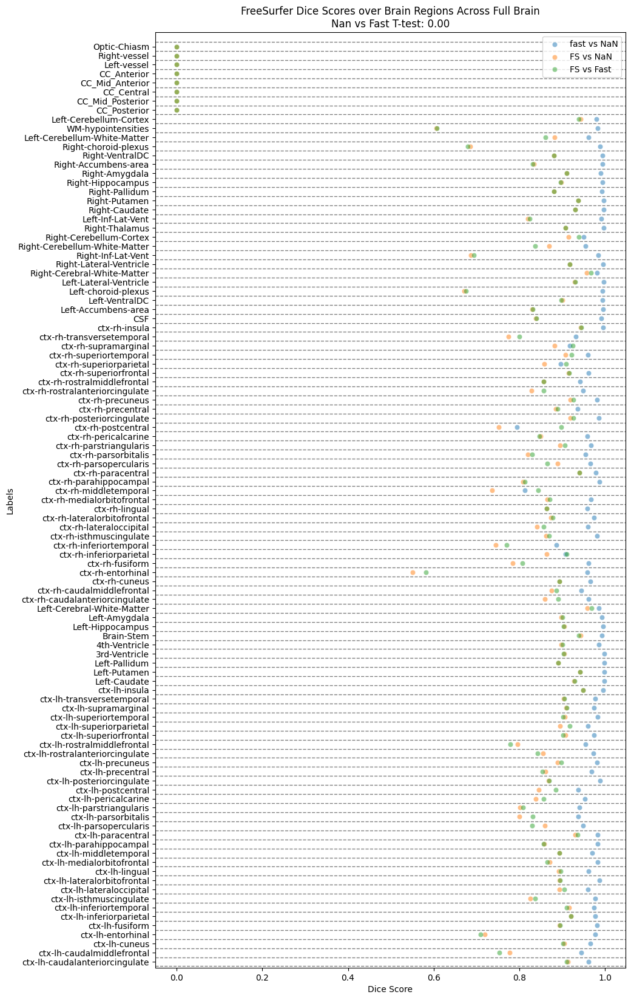

In [35]:
#Ref = IEEE sample
full_fast_vs_nan = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/aparc/dice_full_fast_nan_ieee.json')
full_fs_vs_nan = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/aparc/dice_full_fs_nan_ieee.json')
full_fs_vs_fast = process_fs_dice('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/dice_scores/aparc/dice_full_fs_fast_ieee.json')

tmp = pd.merge(full_fs_vs_nan[0], full_fs_vs_fast[0], on='Labels', suffixes=['_nan', '_fast'])

fig, axes = plt.subplots(1,1, figsize=(10,20))
gc = sns.scatterplot(data=full_fast_vs_nan[0], x='Dice Score', y='Labels', alpha=0.5, ax=axes, label='fast vs NaN')
gc = sns.scatterplot(data=full_fs_vs_nan[0], x='Dice Score', y='Labels', alpha=0.5, ax=axes, label='FS vs NaN')
gc = sns.scatterplot(data=full_fs_vs_fast[0], x='Dice Score', y='Labels', alpha=0.5, ax=axes, label='FS vs Fast')

gc.set_title(f"FreeSurfer Dice Scores over Brain Regions Across Full Brain\nNan vs Fast T-test: {ttest_rel(tmp['Dice Score_fast'], tmp['Dice Score_nan'])[1]:.2f}");

axes.set_ylim(0.35, 103.6)

for i in range(103):
    gc.axhline(y = i+0.5,xmin = 0, xmax = 1, linestyle = "dashed", color ='grey', linewidth=1) 


df = pd.merge( full_fast_vs_nan[1].rename(columns={'Dice Score': 'Fast vs NaN Dice'}), 
         full_fs_vs_nan[1].rename(columns={'Dice Score': 'FS vs NaN Dice'}), 
         on='Stats')

df = pd.merge(df, 
              full_fs_vs_fast[1].rename(columns={'Dice Score': 'FS vs Fast Dice'}),
              on='Stats')
df


##### FastSurfer Dice Score
FastSurfer Dice score is calculated between model prediction and ground truth (aparc segmentation). Therefore this dice score is not comparable to FreeSurfer dice score or dice loss. Below is the dice confusion matrix computed for a single slice. \
Fastsurfer functions were modified in order to account for division by 0 errors resulting in NaN and to add in labelling of different brain regions/classes. 

**Extract from Paper** \
*Dice Similarity Coefficient (DSC) and Average Surface Distance (ASD) to compare different network architectures and modifications against each other, and estimate similarity of the predictions to a number of previously unseen scans with respect to FreeSurfer and manual labels as a reference. Both are standard metrics to evaluate segmentation performance.*
*Here, the DSC Dice (1945); Sørensen (1948) is defined as twice the intersection of ground truth and prediction divided by the sum of their cardinalities and multiplied by 100. A larger DSC represents better overlap between the segmentations with a maximum value of 100 for perfect agreement.*

In [81]:
os.chdir('..')
from FastSurferCNN.utils.metrics import DiceScore
from FastSurferCNN.data_loader.data_utils import get_labels_from_lut, unify_lateralized_labels, read_classes_from_lut, map_aparc_aseg2label

# aseg_ = nib.load('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/aseg.auto_noCCseg.mgz').get_fdata()
# fast = nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/norm.mgz/mri/aseg.auto_noCCseg.mgz').get_fdata()

sag_mask = ("Left-", "ctx-rh")
combi = ["Left-", "Right-"]
lut = read_classes_from_lut("/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/FastSurferCNN/config/FastSurfer_ColorLUT.tsv")
labels, labels_sag = get_labels_from_lut(lut, sag_mask)
lateralization = unify_lateralized_labels(lut, combi)

aseg = np.asarray(
    nib.load('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/aparc.DKTatlas+aseg.mgz').get_fdata(), dtype=np.int16
)

aseg_nocc = np.asarray(
    nib.load('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/aseg.auto_noCCseg.mgz').get_fdata(), dtype=np.int16
)
processing= 'aparc'

#Use mapped_aseg_sag for sagittal only
mapped_aseg, mapped_aseg_sag = map_aparc_aseg2label(
                    aseg,
                    labels,
                    labels_sag,
                    lateralization,
                    aseg_nocc,
                    processing=processing,
                )

# if plane == 'coronal': aseg_slice = torch.tensor(mapped_aseg[:, :, i]).unsqueeze(0)
# elif plane == 'axial': 
#     aseg_slice = torch.tensor(mapped_aseg[:, i, :]).T.unsqueeze(0)
# elif plane == 'sagittal': aseg_slice = torch.tensor(mapped_aseg_sag[i].T).unsqueeze(0)

   

classifier_thresh1 = pickle.load(open(f"/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/coronal/1_classifier_{140}.pkl", 'rb'))
classifier_ieee = pickle.load(open(f"/scratch/ine5/fastsurfer_embeddings/results/fullbrain/ieee/sub-0025531.nii.gz/coronal/ieee_classifier_{140}.pkl", 'rb'))


dice = DiceScore(num_classes=79) #num of classes found for coronal is 36?

In [82]:
aseg_slice = torch.tensor(mapped_aseg[:, :, 140]).unsqueeze(0)

In [83]:
output_transform=lambda y_pred, y: (y_pred.data.max(1)[1], y)
ypred, y = output_transform(classifier_ieee, aseg_slice)

In [87]:
# n_classes=79
# n_classes = set(aseg_slice.detach().numpy().ravel())
n_classes = list(df['ID'])

intersection = torch.zeros(len(n_classes), len(n_classes))
union = torch.zeros(len(n_classes), len(n_classes))

for i in range(len(n_classes)):
    gt = (aseg_slice == i).float()
    for j in range(len(n_classes)):
        pred = (ypred == j).float()
        # print('INTERSECTION', torch.sum(torch.mul(gt, pred)))
        intersection[i, j] += torch.sum(torch.mul(gt, pred))
        # print('UNION', torch.sum(gt) + torch.sum(pred))
        union[i, j] += torch.sum(gt) + torch.sum(pred)
    #     break
    # break

In [88]:
#OBTAINED WITH N_CLASSES=FASTSURFER LABEL LOOKUP TABLE
eps = 1e-5
intersectiond = intersection.diagonal()
print(intersectiond)
uniond = union.diagonal()
print(uniond)
dsc = 2 * torch.div(intersectiond, uniond+eps)
dsc


tensor([5.4812e+04, 1.9410e+03, 1.1600e+02, 1.4000e+01, 0.0000e+00, 0.0000e+00,
        9.2000e+01, 6.8000e+01, 1.8900e+02, 1.3900e+02, 4.2000e+01, 0.0000e+00,
        0.0000e+00, 2.6000e+01, 1.9300e+02, 1.3000e+01, 0.0000e+00, 1.0900e+02,
        4.0000e+00, 2.3120e+03, 9.6000e+01, 2.2000e+01, 0.0000e+00, 0.0000e+00,
        1.3700e+02, 6.7000e+01, 1.8700e+02, 1.4400e+02, 1.2300e+02, 1.2500e+02,
        0.0000e+00, 1.0600e+02, 7.0000e+00, 1.4000e+01, 3.4000e+01, 3.8300e+02,
        0.0000e+00, 1.6700e+02, 3.1000e+01, 0.0000e+00, 3.5900e+02, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4900e+02, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 3.5400e+02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.7300e+02,
        0.0000e+00, 3.7000e+02, 0.0000e+00, 2.3000e+01, 2.9400e+02, 1.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 4.8000e+

tensor([0.9976, 0.9666, 0.9587, 0.8235, 0.0000, 0.0000, 0.8679, 0.9128, 0.9545,
        0.9360, 0.8842, 0.0000, 0.0000, 0.5591, 0.8753, 0.7879, 0.0000, 0.9237,
        0.8000, 0.9615, 0.9697, 0.8000, 0.0000, 0.0000, 0.9133, 0.9178, 0.9373,
        0.9474, 0.7859, 0.8197, 0.0000, 0.8833, 0.7368, 0.6829, 0.5312, 0.9087,
        0.0000, 0.8371, 0.2348, 0.0000, 0.7479, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.9369, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.8962, 0.0000, 0.0000, 0.0000, 0.9254, 0.0000, 0.9524, 0.0000,
        0.8364, 0.9515, 0.0667, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.4898, 0.6452, 0.7793, 0.0000, 0.9271])

In [93]:
dice_intersection = intersection
dice_union = union
if not (dice_union > 0).all():
    print("Union of some classes are all zero")
dice_cnf_matrix = 2 * np.divide(dice_intersection, dice_union+eps)

Union of some classes are all zero


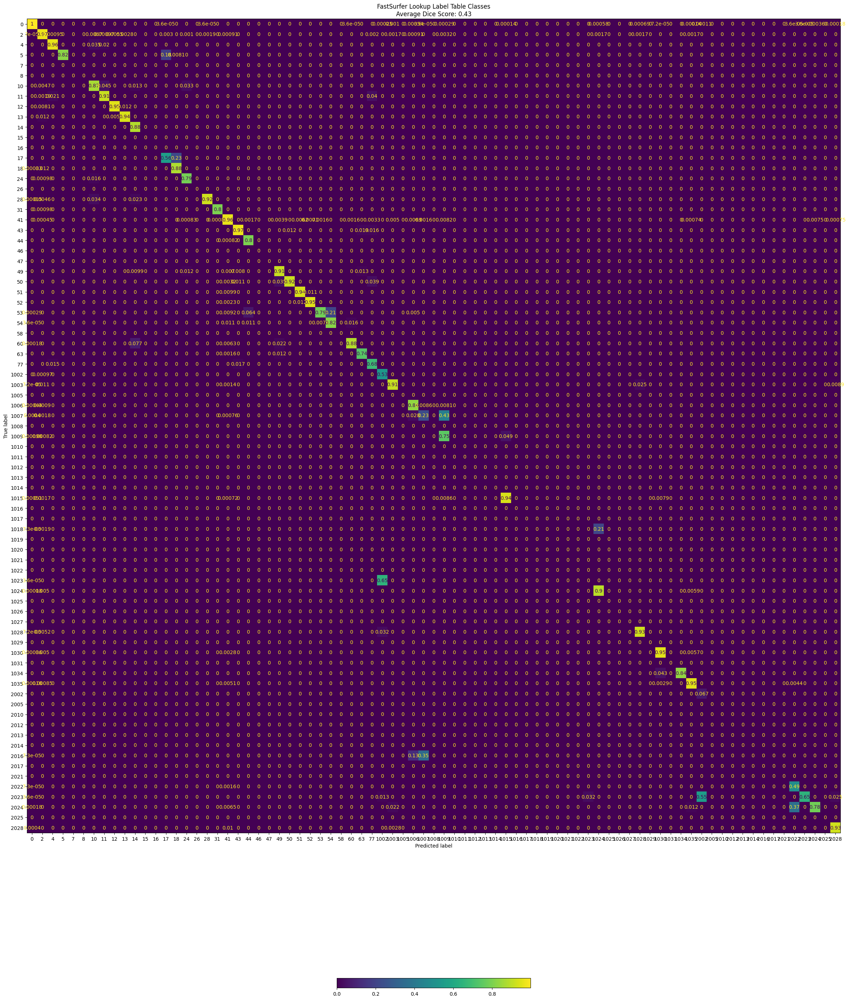

In [94]:
disp = ConfusionMatrixDisplay(confusion_matrix=dice_cnf_matrix.numpy(),
                              display_labels=n_classes)

# Create a new figure with the desired size (width, height)
fig, ax = plt.subplots(figsize=(30, 35))

# Plot the confusion matrix
im = disp.plot(ax=ax, colorbar=False);
fig.colorbar(im.im_, ax=ax, orientation='horizontal', fraction=.01)
ax.set_title(f'FastSurfer Lookup Label Table Classes\nAverage Dice Score: {dsc.mean():.2f}');
plt.savefig('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/custom_fast_dicescore.png');

#### Hausdorff and Average Surface Distance Exploration

In [11]:
from scipy.spatial.distance import directed_hausdorff
from skimage import measure


# Load the 3D brain segmentation images

# fs_aseg = nib.load('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/aseg.auto_noCCseg.mgz').get_fdata()
# # nan_aseg = nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/norm.mgz/mri/aseg.auto_noCCseg.mgz').get_fdata()
# nan_aseg = nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/sub-0025531/mri/aseg.auto_noCCseg.mgz').get_fdata()
# fast_aseg = nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/ieee4/norm/mri/aseg.auto_noCCseg.mgz').get_fdata()

fs_aseg = nib.load('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/0025531_fs/sub-0025531/mri/aparc.DKTatlas+aseg.mgz').get_fdata()
nan_aseg = nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/thresh1/sub-0025531/mri/aparc.DKTatlas+aseg.deep_1_test.mgz').get_fdata()
fast_aseg = nib.load('/scratch/ine5/fastsurfer_embeddings/results/fullbrain/sub-0025531/ieee4/norm/mri/aparc.DKTatlas+aseg.deep.mgz').get_fdata()

# Extract boundaries
def get_boundaries(segmentation):
    try:
        boundaries = measure.find_contours(segmentation, level=0.5)
        boundary_points = np.concatenate(boundaries, axis=0)
    except:
        boundary_points = [0]
    return boundary_points


# Extract 3D surfaces
def get_surfaces(segmentation):
    # Assuming segmentation is a binary mask, use marching cubes to get the surface
    verts, faces, _, _ = measure.marching_cubes(segmentation, level=0.5)
    return verts

nan_boundary = get_surfaces(nan_aseg)
fast_boundary = get_surfaces(fast_aseg)
fs_boundary = get_surfaces(fs_aseg)



# Calculate Hausdorff Distance
def hausdorff_distance(surface1, surface2):
    d_forward = directed_hausdorff(surface1, surface2)[0]
    d_reverse = directed_hausdorff(surface2, surface1)[0]
    return max(d_forward, d_reverse)


fast_hd = []
nan_hd = []
comp_hd = []
for i in range(256):
    nan_boundary = get_boundaries(nan_aseg[i])
    fast_boundary = get_boundaries(fast_aseg[i])
    fs_boundary = get_boundaries(fs_aseg[i])  

    try:
        fast_hd.append( hausdorff_distance(fs_boundary, fast_boundary) )
        nan_hd.append( hausdorff_distance(fs_boundary, nan_boundary) )
        comp_hd.append( hausdorff_distance(fast_boundary, nan_boundary) )
    except:
        fast_hd.append( np.nan )
        nan_hd.append( np.nan )
        comp_hd.append( np.nan )


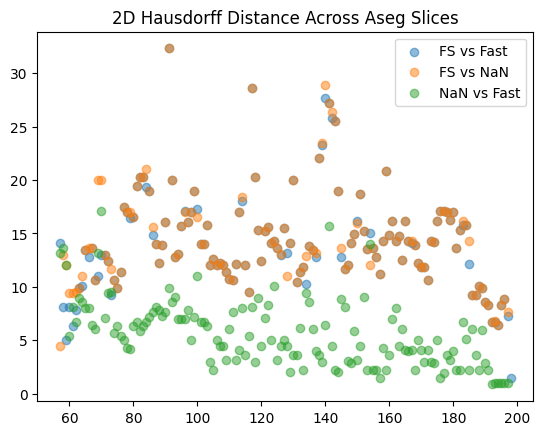

In [9]:
plt.scatter(np.arange(len(fast_hd)), fast_hd, alpha=0.5, label='FS vs Fast')
plt.scatter(np.arange(len(nan_hd)), nan_hd, alpha=0.5, label='FS vs NaN')
plt.scatter(np.arange(len(comp_hd)), comp_hd, alpha=0.5, label='NaN vs Fast')
plt.legend(), plt.title('2D Hausdorff Distance Across Aseg Slices');

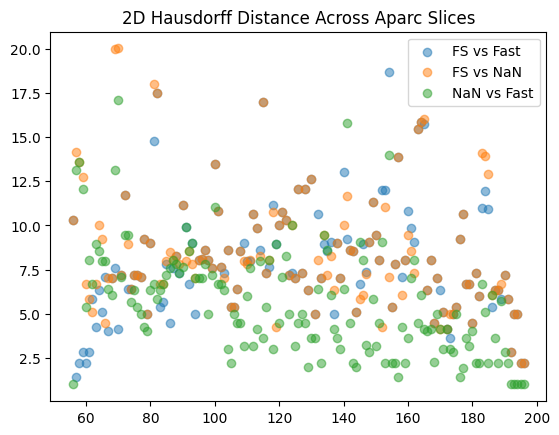

In [12]:
plt.scatter(np.arange(len(fast_hd)), fast_hd, alpha=0.5, label='FS vs Fast')
plt.scatter(np.arange(len(nan_hd)), nan_hd, alpha=0.5, label='FS vs NaN')
plt.scatter(np.arange(len(comp_hd)), comp_hd, alpha=0.5, label='NaN vs Fast')
plt.legend(), plt.title('2D Hausdorff Distance Across Aparc Slices');

## Preliminary Skip Counts

### Observe Across Thresholds

In [8]:
def count_skipped_ops(filename):
    f = open(filename, 'r')

    skip_count = {}
    start_printing = False
    conv_counter = 0

    for line in f: 
        line = line.strip()
        if 'Input' in line:
            start_printing = True
        if start_printing:
            if 'Input' in line or 'Encode' in line or 'Bottle' in line or 'Decode' in line or 'Output block' in line or 'Classifier' in line: 
                block = line.split(': ')[-1]
                skip_count[block] = {}
                conv_counter = 0

            if 'SKIP' in line:
                tmp = line.split('count ')[-1].strip('()').split(', ')
                skip_count[block][conv_counter] = {'Count': int(tmp[0]), 'Total': int(tmp[1]), 'Ratio': float(int(tmp[0])/int(tmp[1])) }
                conv_counter += 1

    block_counter = {}
    for block in ['Input', 'Encode1', 'Encode2', 'Encode3', 'Encode4', 'Bottleneck', 'Decode4', 'Decode3', 'Decode2', 'Decode1', 'Output block', 'Classifier']:
        block_counter[block] = {"Labels": [], "Ratio": []}
        for num, r in skip_count[block].items():
            # print(r)
            block_counter[block]["Labels"].append(f"Conv {num}")
            block_counter[block]["Ratio"].append(float(r['Ratio']))

    return block_counter


def aggregate_mean_ratios(dictionaries):
    # Initialize a dictionary to store aggregated ratio values for each convolutional layer
    aggregated_ratios = {}
    
    # Iterate through each dictionary
    for dictionary in dictionaries:
        # print(dictionary)

        for layer in dictionary:
            # Extract labels and ratio values
            labels = dictionary[layer].get('Labels', [])
            ratios = dictionary[layer].get('Ratio', [])

            if layer not in aggregated_ratios.keys(): 
                aggregated_ratios[layer] = {}
            
            # Iterate through labels and corresponding ratio values
            for label, ratio in zip(labels, ratios):
                # If label already exists in aggregated_ratios, add ratio value to list
                if label in aggregated_ratios[layer]:
                    aggregated_ratios[layer][label].append(ratio)
                # If label is new, initialize list with ratio value
                else:
                    aggregated_ratios[layer][label] = [ratio]
    
    # Calculate mean ratio for each convolutional layer
    mean_ratios = {}
    for layer in aggregated_ratios:
        mean_ratios[layer] = {}
        for label, ratios in aggregated_ratios[layer].items():
            mean_ratios[layer][label] = [sum(ratios) / len(ratios)]
    
    return aggregated_ratios, mean_ratios

def ratio_distribution(thresh1, thresh08, thresh05, thresh02):
    for block in ['Input', 'Encode1', 'Encode2', 'Encode3', 'Encode4', 'Bottleneck', 'Decode4', 'Decode3', 'Decode2', 'Decode1', 'Output block', 'Classifier']:
        fig, axes = plt.subplots(1, 4, figsize=(20,4))

        for conv in thresh1[block]:
            axes[0].scatter(np.arange(len(thresh1[block][conv])), thresh1[block][conv], alpha=0.5, label=conv)
            axes[1].scatter(np.arange(len(thresh08[block][conv])), thresh08[block][conv], alpha=0.5, label=conv)
            axes[2].scatter(np.arange(len(thresh05[block][conv])), thresh05[block][conv], alpha=0.5, label=conv)
            axes[3].scatter(np.arange(len(thresh02[block][conv])), thresh02[block][conv], alpha=0.5, label=conv)
            
        axes[0].legend(), axes[1].legend(), axes[2].legend(), axes[3].legend()
        axes[0].set_ylabel('NaN Ratio') #, axes[1].set_ylabel('NaN Ratio')
        axes[0].set_title('Threshold 1'); axes[1].set_title('Threshold 0.8'), axes[2].set_title('Threshold 0.5'); axes[3].set_title('Threshold 0.2')
        plt.suptitle(f"{block} Mean NaN Ratio Distribution Across Sagittal View")
        # break


def average_block_ratio(mean_ratios_thresh1, mean_ratios_thresh08, mean_ratios_thresh05, mean_ratios_thresh02):
    # avg_thresh = {'0': [], '0.2': [], '0.5': [], '0.8': [], '1': []}
    avg_thresh = {'0.2': [], '0.5': [], '0.8': [], '1': []}
    # avg_thresh = {'0.5': [], '1': []}

    for block in ['Input', 'Encode1', 'Encode2', 'Encode3', 'Encode4', 'Bottleneck', 'Decode4', 'Decode3', 'Decode2', 'Decode1', 'Output block', 'Classifier']:

        fig, axes = plt.subplots(1, 1, figsize=(10,5))
        # df1 = pd.DataFrame(thresh_0[block])
        # df1['Threshold'] = 0
        df2 = pd.DataFrame(mean_ratios_thresh02[block])
        df2 = df2.T.reset_index().rename(columns={'index':'Labels', 0:'Ratio'})
        df2['Threshold'] = 0.2
        df3 = pd.DataFrame(mean_ratios_thresh05[block])
        df3 = df3.T.reset_index().rename(columns={'index':'Labels', 0:'Ratio'})
        df3['Threshold'] = 0.5
        df4 = pd.DataFrame(mean_ratios_thresh08[block])
        df4 = df4.T.reset_index().rename(columns={'index':'Labels', 0:'Ratio'})
        df4['Threshold'] = 0.8
        df5 = pd.DataFrame(mean_ratios_thresh1[block])
        df5 = df5.T.reset_index().rename(columns={'index':'Labels', 0:'Ratio'})
        df5['Threshold'] = 1
        # df = pd.concat((df1, df2, df3, df4, df5))
        df = pd.concat((df2, df3, df4, df5))

        # avg_thresh['0'].append(np.mean(df1['Ratio']))
        avg_thresh['0.2'].append(np.mean(df2['Ratio']))
        avg_thresh['0.5'].append(np.mean(df3['Ratio']))
        avg_thresh['0.8'].append(np.mean(df4['Ratio']))
        avg_thresh['1'].append(np.mean(df5['Ratio']))


        gc = sns.barplot(x='Labels', y='Ratio', data=df, hue='Threshold', ax=axes)
        gc.set_title(block), sns.move_legend(axes, "upper left", bbox_to_anchor=(1, 1));

    fig, axes = plt.subplots(1, 1, figsize=(10,5))


    avg_thresh = pd.DataFrame(avg_thresh)
    # axes.plot(avg_thresh['0'], marker='o', alpha=0.5, label = 'Threshold 0')
    axes.plot(avg_thresh['0.2'], marker='o', alpha=0.5, label = 'Threshold 0.2')
    axes.plot(avg_thresh['0.5'], marker='o', alpha=0.5, label = 'Threshold 0.5')
    axes.plot(avg_thresh['0.8'], marker='o', alpha=0.5, label = 'Threshold 0.8')
    axes.plot(avg_thresh['1'], marker='o', alpha=0.5, label = 'Threshold 1')
    axes.set_title('Mean Skipped Count Operations Across Model'), axes.legend(loc="upper left", bbox_to_anchor=(1, 1));
    axes.set_xticks(np.arange(len(mean_ratios_thresh1.keys())), list(mean_ratios_thresh1.keys()), rotation=30);



#### sub-0025531

In [4]:
dictionaries_thresh1 = [count_skipped_ops(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/0025531_thresh1_{i}.out') for i in range(256)]  
dictionaries_thresh02 = [count_skipped_ops(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/0025531_thresh02_{i}.out') for i in range(256)]  
dictionaries_thresh05 = [count_skipped_ops(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/0025531_thresh05_{i}.out') for i in range(256)]  
dictionaries_thresh08 = [count_skipped_ops(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/0025531_thresh08_{i}.out') for i in range(256)]  


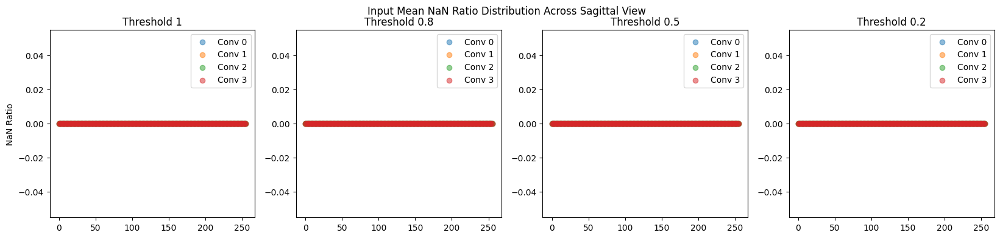

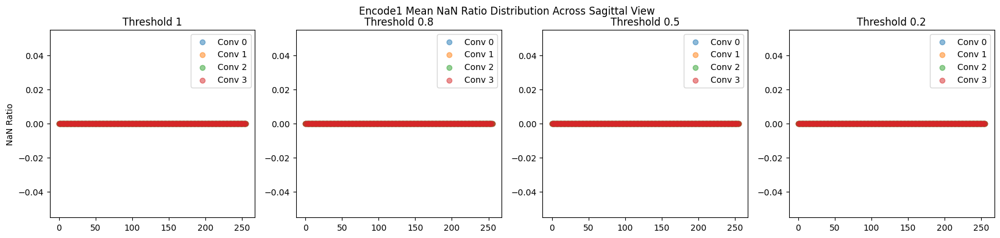

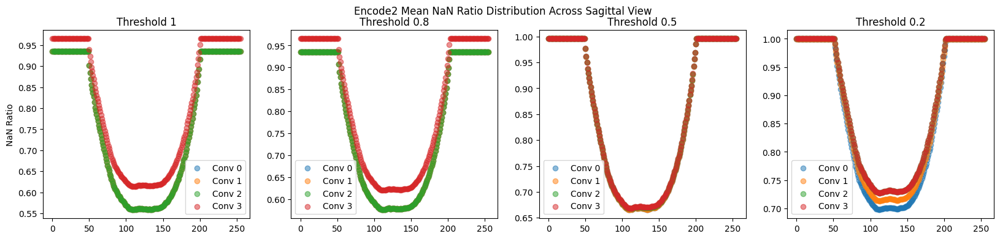

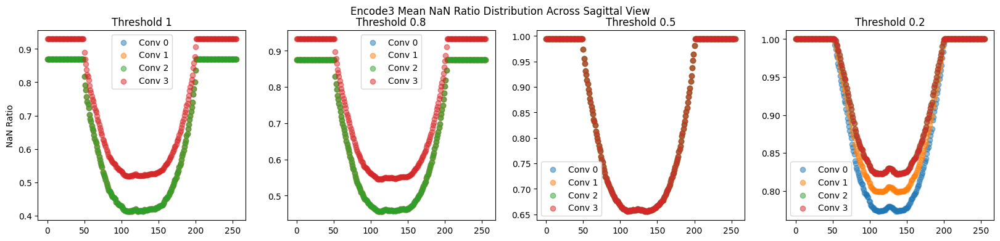

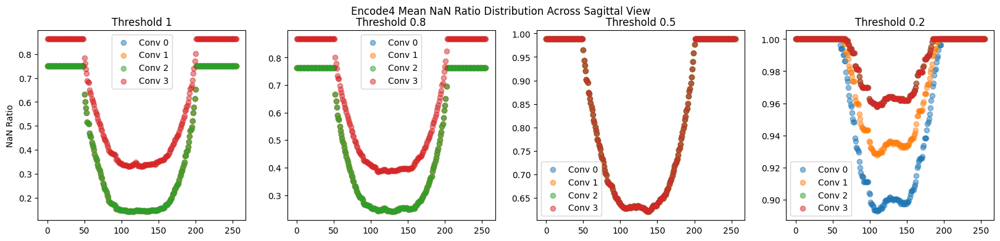

...

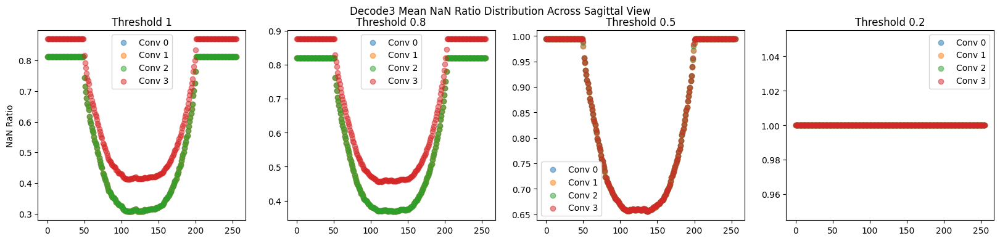

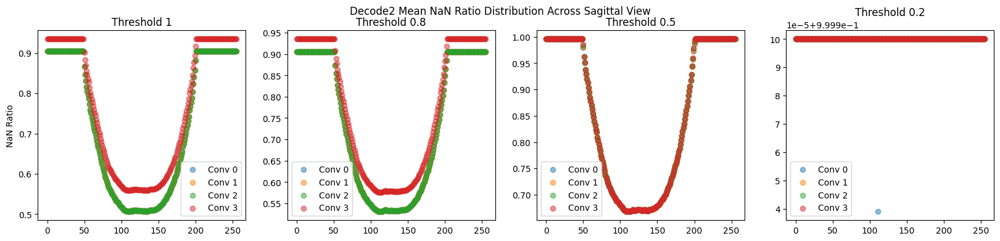

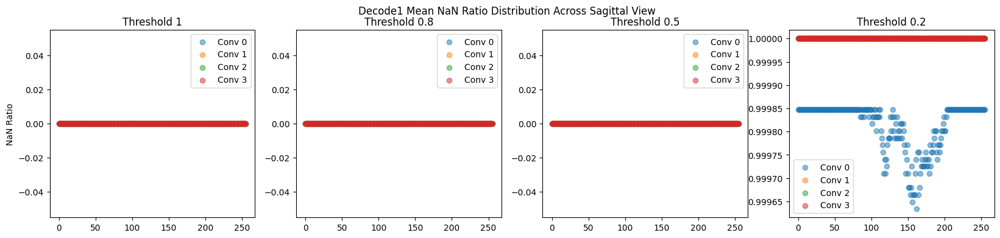

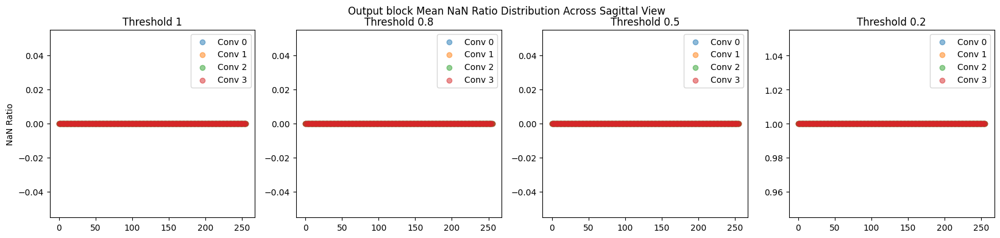

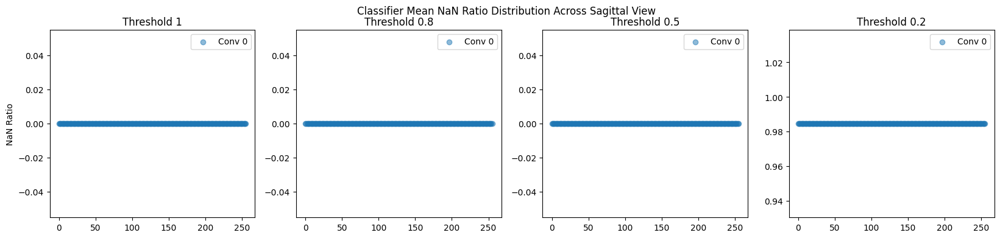

In [6]:
aggregated_ratios_thresh1, mean_ratios_thresh1 = aggregate_mean_ratios(dictionaries_thresh1)
aggregated_ratios_thresh08, mean_ratios_thresh08 = aggregate_mean_ratios(dictionaries_thresh08)
aggregated_ratios_thresh05, mean_ratios_thresh05 = aggregate_mean_ratios(dictionaries_thresh05)
aggregated_ratios_thresh02, mean_ratios_thresh02 = aggregate_mean_ratios(dictionaries_thresh02)

ratio_distribution(aggregated_ratios_thresh1, aggregated_ratios_thresh08, aggregated_ratios_thresh05, aggregated_ratios_thresh02)    

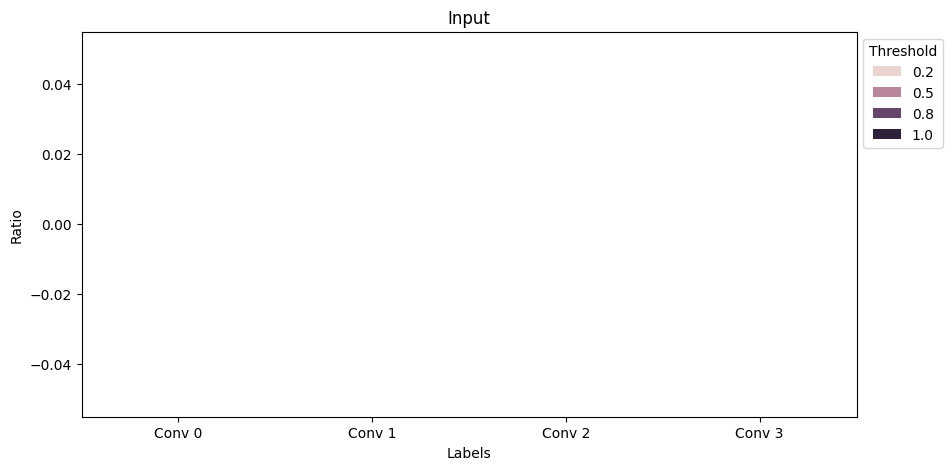

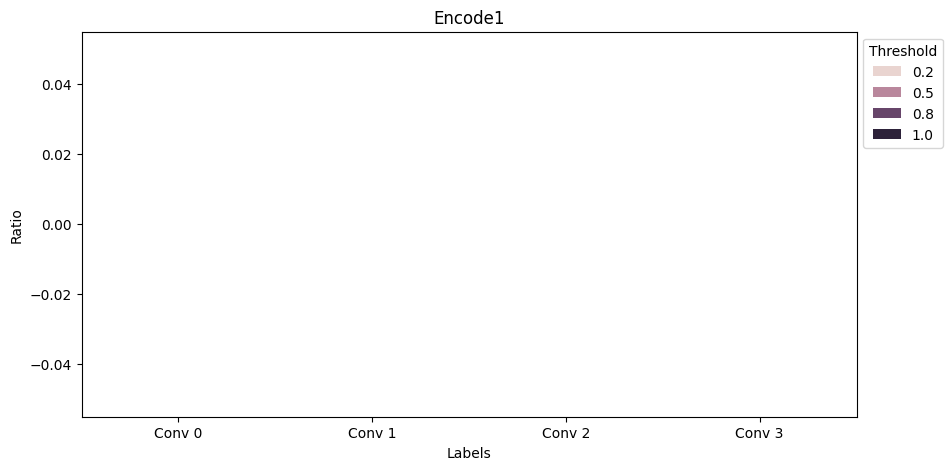

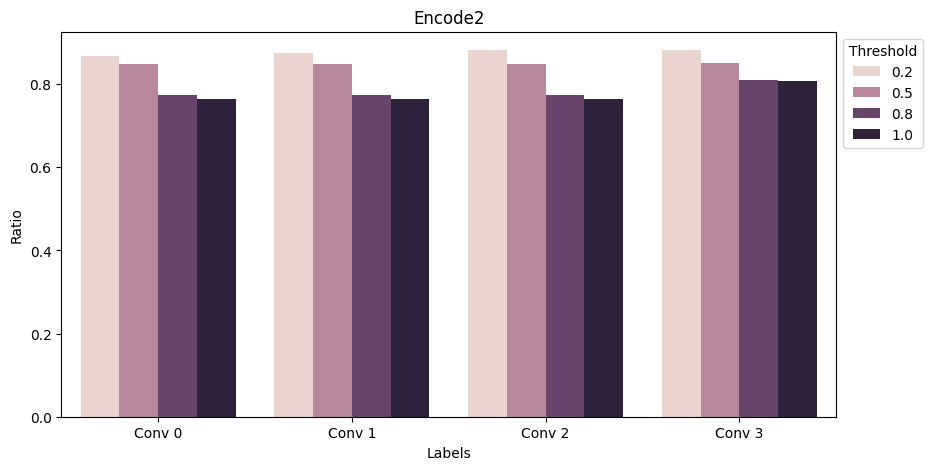

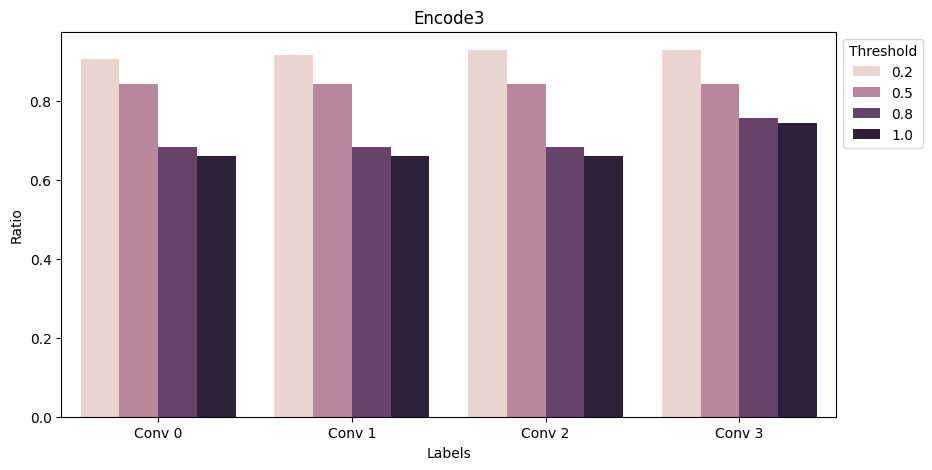

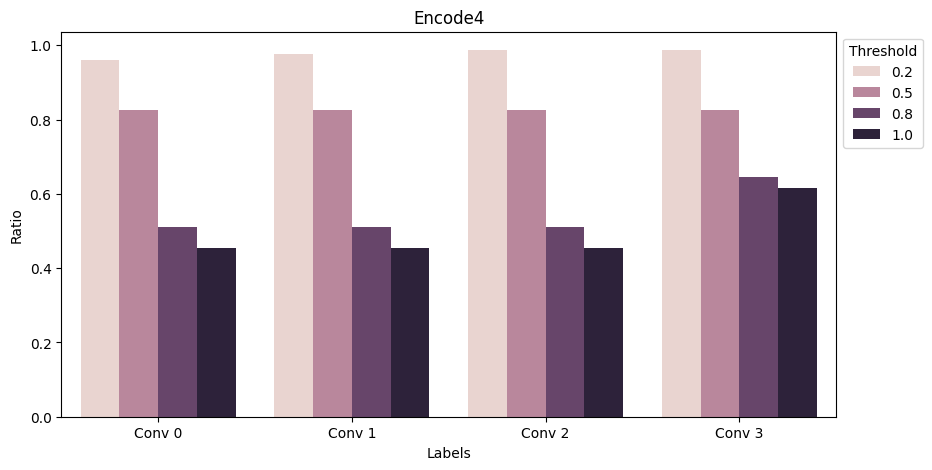

...

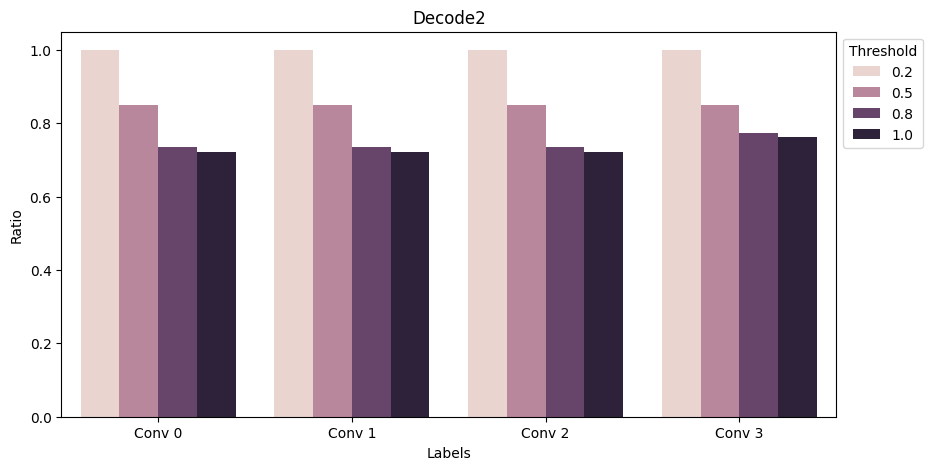

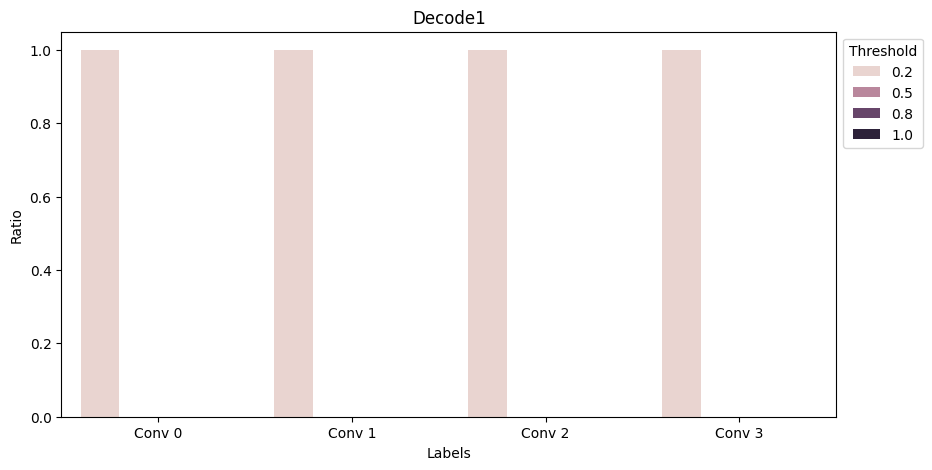

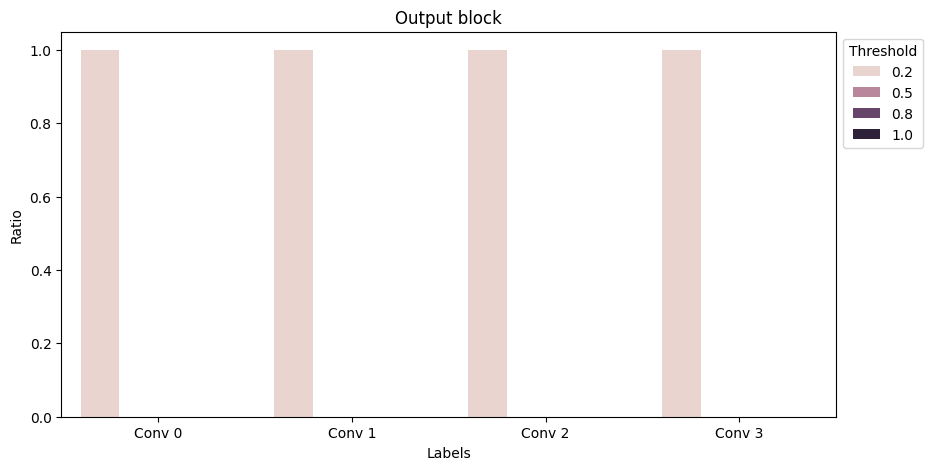

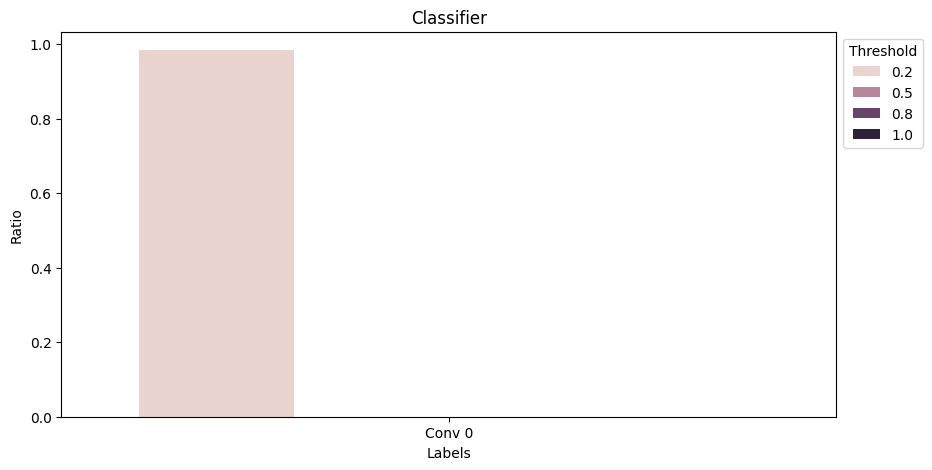

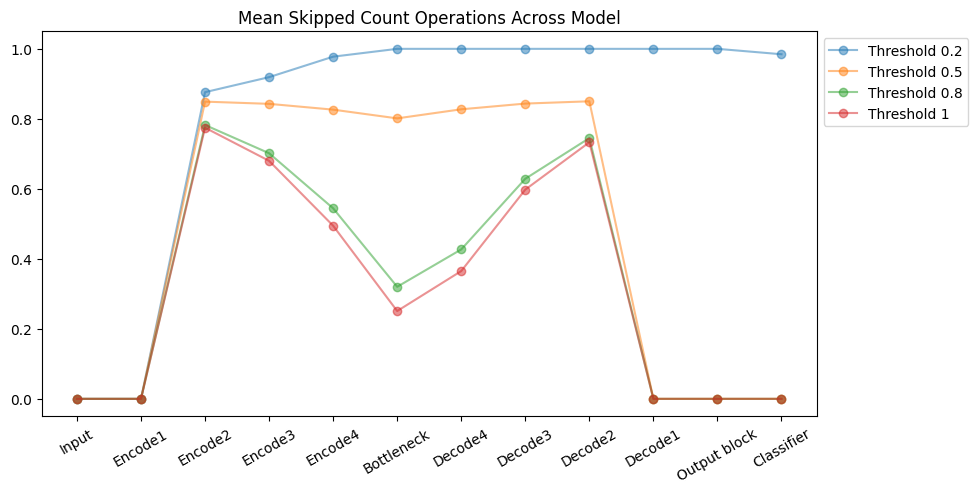

In [9]:
average_block_ratio(mean_ratios_thresh1, mean_ratios_thresh08, mean_ratios_thresh05, mean_ratios_thresh02)

#### sub-0025350

In [ ]:
dictionaries_thresh1 = [count_skipped_ops(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/0025350_thresh1_{i}.out') for i in range(256)]  
dictionaries_thresh05 = [count_skipped_ops(f'/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/0025350_thresh05_{i}.out') for i in range(256)]  


In [ ]:
aggregated_ratios_thresh1, mean_ratios_thresh1 = aggregate_mean_ratios(dictionaries_thresh1)
aggregated_ratios_thresh05, mean_ratios_thresh05 = aggregate_mean_ratios(dictionaries_thresh05)

ratio_distribution(aggregated_ratios_thresh1, aggregated_ratios_thresh05)    

In [ ]:
average_block_ratio(mean_ratios_thresh1, mean_ratios_thresh05)

#### Single slice -- 0025531

In [ ]:
def count_skipped_ops(filename):
    f = open(filename, 'r')

    skip_count = {}
    start_printing = False
    conv_counter = 0

    for line in f: 
        line = line.strip()
        if 'Encode1' in line:
            start_printing = True
        if start_printing:
            if 'Encode' in line or 'Bottle' in line or 'Decode' in line or 'Output block' in line or 'Classifier' in line: 
                block = line.split(': ')[-1]
                skip_count[block] = {}
                conv_counter = 0

            if 'SKIP' in line:
                tmp = line.split('count ')[-1].strip('()').split(', ')
                skip_count[block][conv_counter] = {'Count': int(tmp[0]), 'Total': int(tmp[1]), 'Ratio': float(int(tmp[0])/int(tmp[1])) }
                conv_counter += 1

    block_counter = {}
    for block in ['Encode1', 'Encode2', 'Encode3', 'Encode4', 'Bottleneck', 'Decode4', 'Decode3', 'Decode2', 'Decode1', 'Output block', 'Classifier']:
        block_counter[block] = {"Labels": [], "Ratio": []}
        for num, r in skip_count[block].items():
            # print(r)
            block_counter[block]["Labels"].append(f"Conv {num}")
            block_counter[block]["Ratio"].append(float(r['Ratio']))

    return block_counter


# thresh_0 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/nanconv_skipcount_1.out')
# thresh_02 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/nanconv_skipcount_2.out')
# thresh_05 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/nanconv_skipcount_3.out')
# thresh_08 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/nanconv_skipcount_5.out')
# thresh_1 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/slurm/nanconv_skipcount_4.out')

thresh_02 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/count_skip_2.out')
thresh_05 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/count_skip_3.out')
thresh_08 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/count_skip_5.out')
thresh_1 = count_skipped_ops('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/count_skip_4.out')


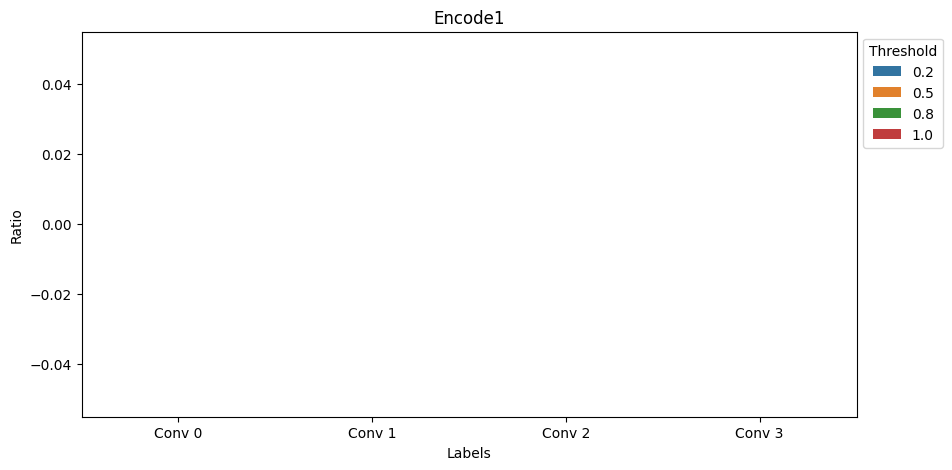

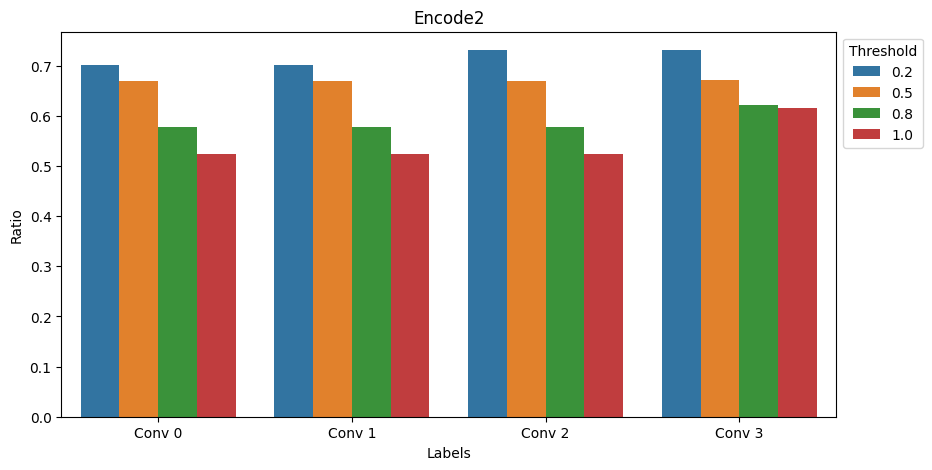

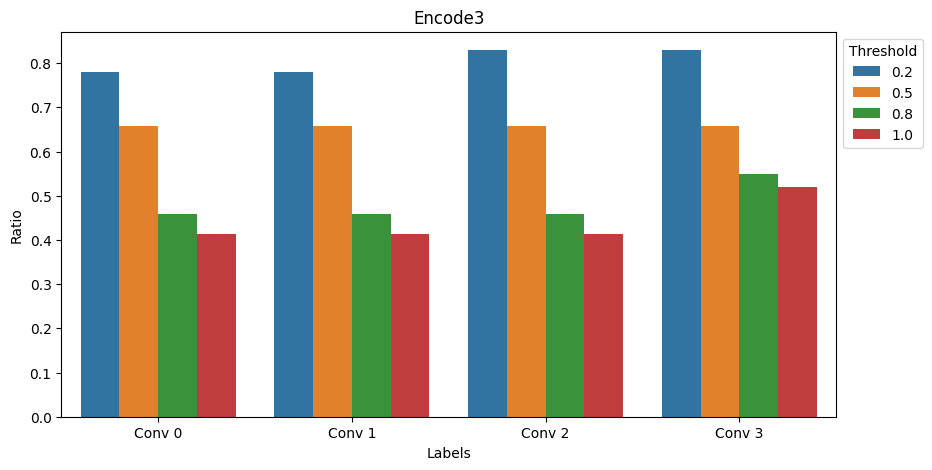

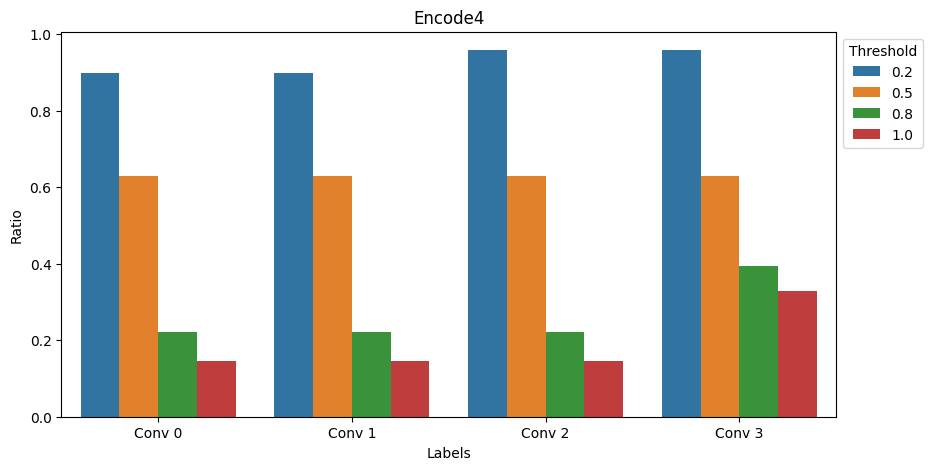

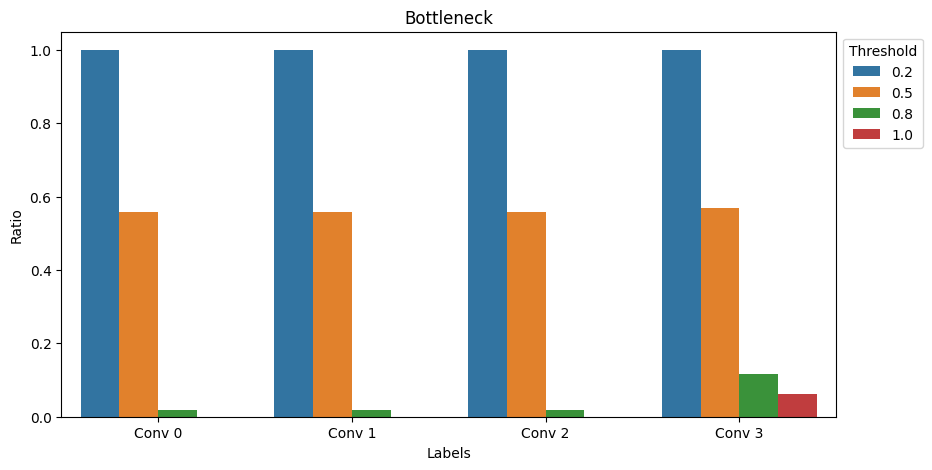

...

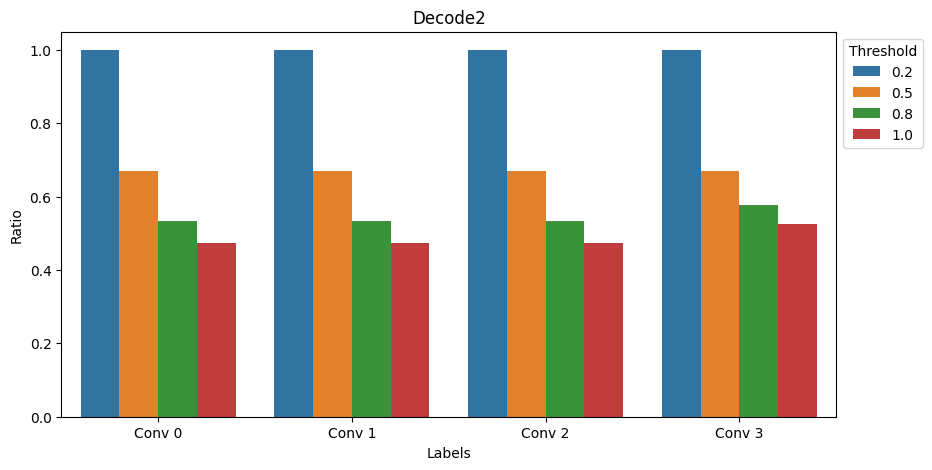

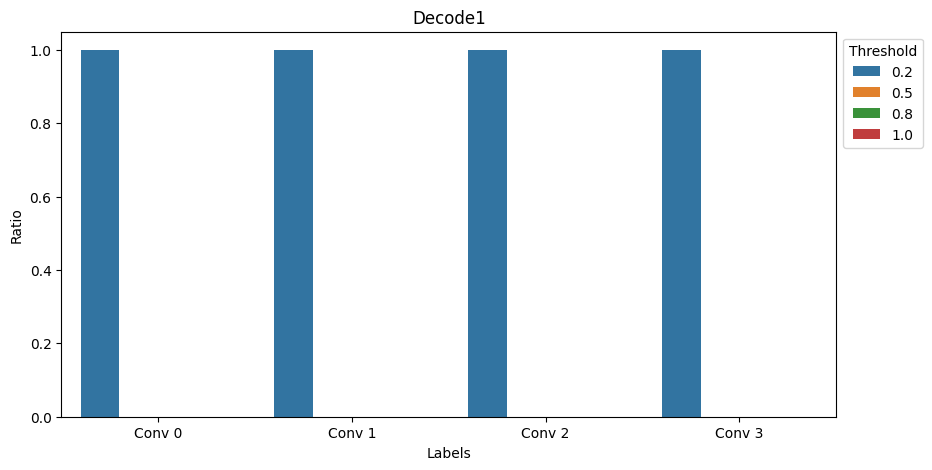

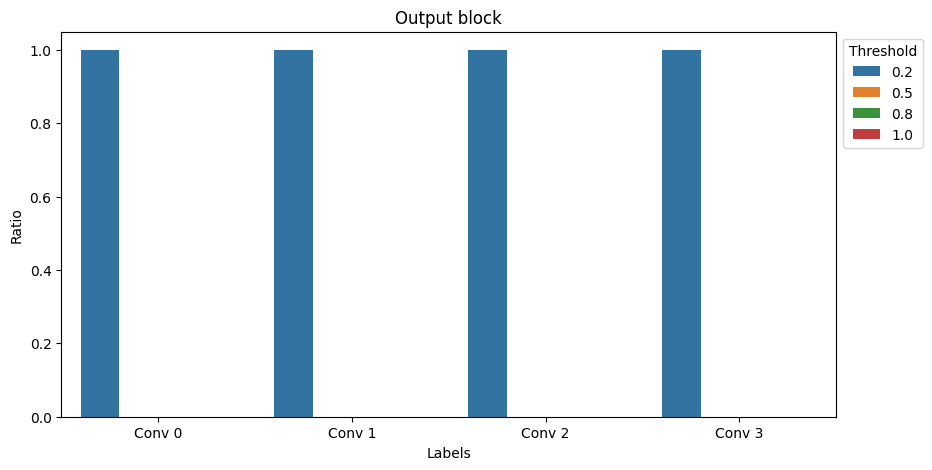

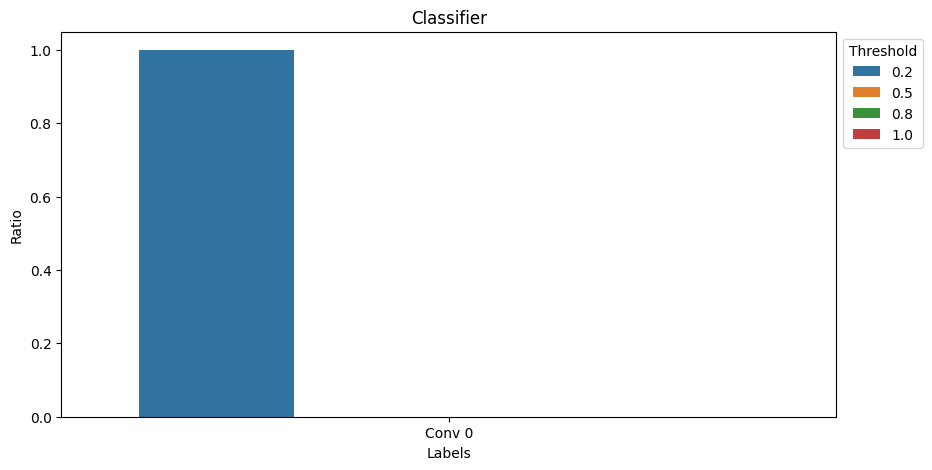

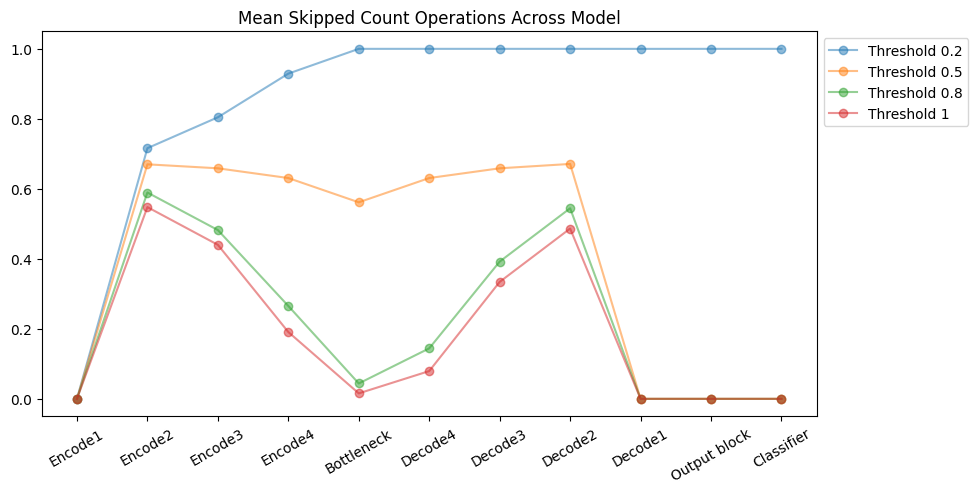

In [ ]:
warnings.filterwarnings("ignore")

# avg_thresh = {'0': [], '0.2': [], '0.5': [], '0.8': [], '1': []}
avg_thresh = {'0.2': [], '0.5': [], '0.8': [], '1': []}
for block in ['Encode1', 'Encode2', 'Encode3', 'Encode4', 'Bottleneck', 'Decode4', 'Decode3', 'Decode2', 'Decode1', 'Output block', 'Classifier']:

    fig, axes = plt.subplots(1, 1, figsize=(10,5))
    # df1 = pd.DataFrame(thresh_0[block])
    # df1['Threshold'] = 0
    df2 = pd.DataFrame(thresh_02[block])
    df2['Threshold'] = 0.2
    df3 = pd.DataFrame(thresh_05[block])
    df3['Threshold'] = 0.5
    df4 = pd.DataFrame(thresh_08[block])
    df4['Threshold'] = 0.8
    df5 = pd.DataFrame(thresh_1[block])
    df5['Threshold'] = 1
    # df = pd.concat((df1, df2, df3, df4, df5))
    df = pd.concat((df2, df3, df4, df5))

    # avg_thresh['0'].append(np.mean(df1['Ratio']))
    avg_thresh['0.2'].append(np.mean(df2['Ratio']))
    avg_thresh['0.5'].append(np.mean(df3['Ratio']))
    avg_thresh['0.8'].append(np.mean(df4['Ratio']))
    avg_thresh['1'].append(np.mean(df5['Ratio']))


    gc = sns.barplot(x='Labels', y='Ratio', data=df, hue='Threshold', ax=axes)
    gc.set_title(block), sns.move_legend(axes, "upper left", bbox_to_anchor=(1, 1));

fig, axes = plt.subplots(1, 1, figsize=(10,5))


avg_thresh = pd.DataFrame(avg_thresh)
# axes.plot(avg_thresh['0'], marker='o', alpha=0.5, label = 'Threshold 0')
axes.plot(avg_thresh['0.2'], marker='o', alpha=0.5, label = 'Threshold 0.2')
axes.plot(avg_thresh['0.5'], marker='o', alpha=0.5, label = 'Threshold 0.5')
axes.plot(avg_thresh['0.8'], marker='o', alpha=0.5, label = 'Threshold 0.8')
axes.plot(avg_thresh['1'], marker='o', alpha=0.5, label = 'Threshold 1')
axes.set_title('Mean Skipped Count Operations Across Model'), axes.legend(loc="upper left", bbox_to_anchor=(1, 1));
axes.set_xticks(np.arange(len(thresh_1.keys())), list(thresh_1.keys()), rotation=30);

#### IEEE

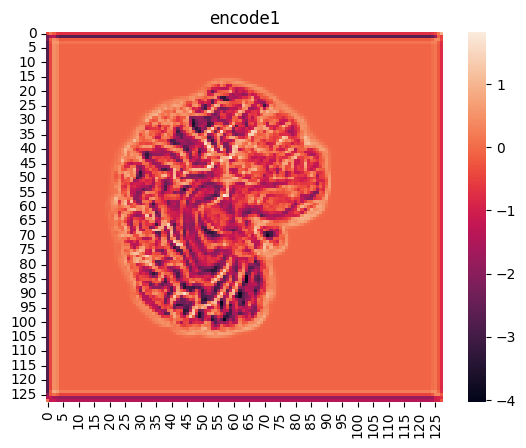

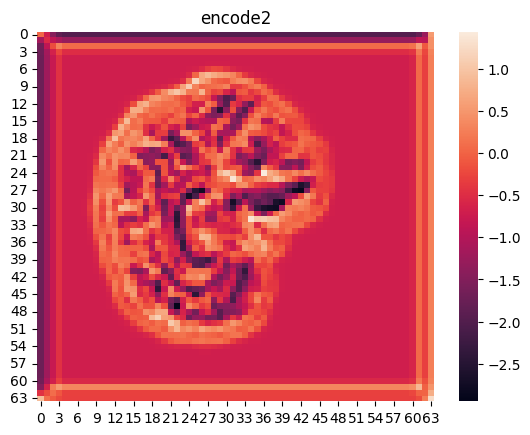

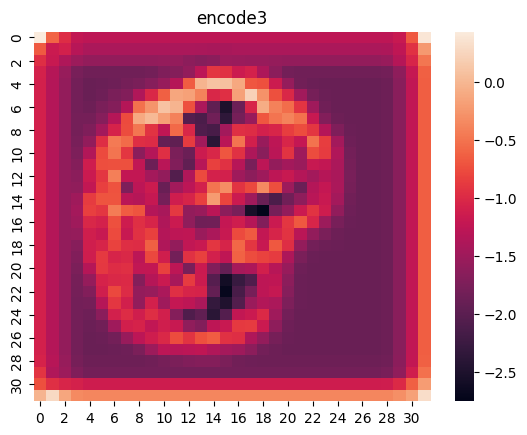

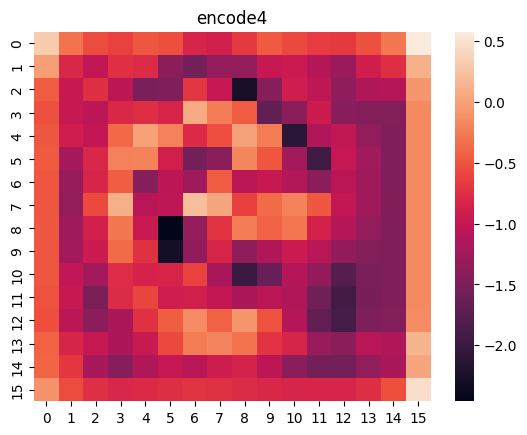

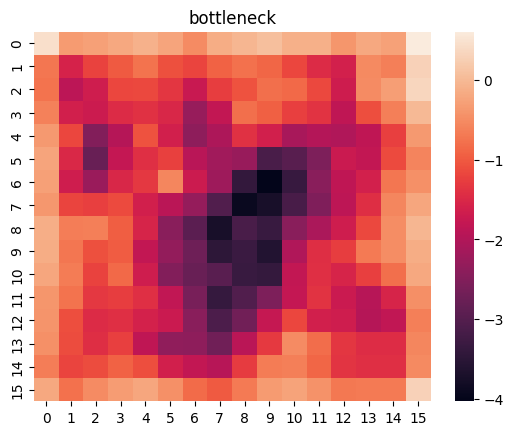

...

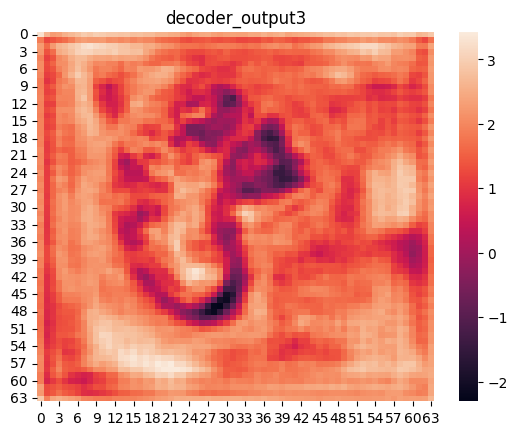

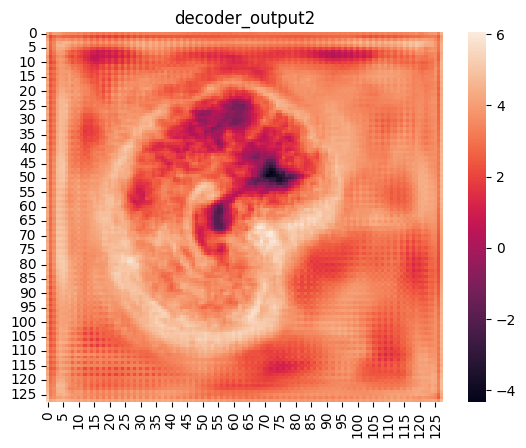

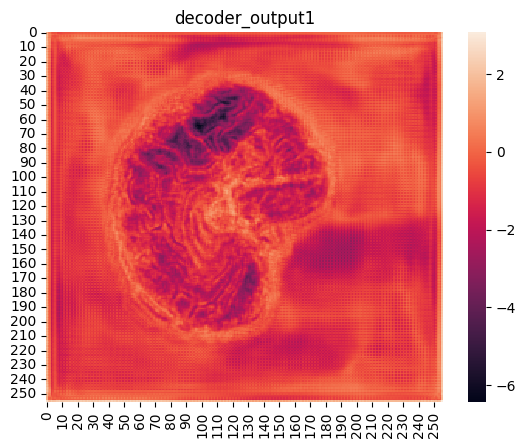

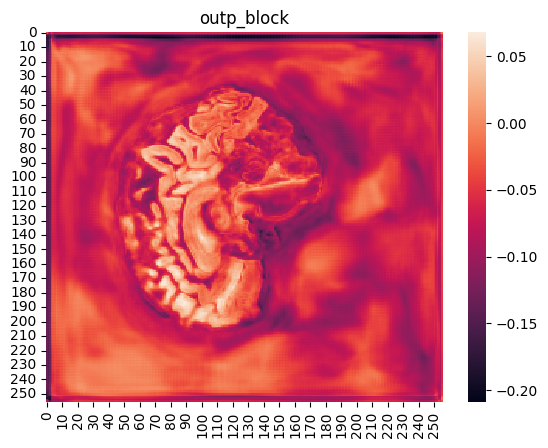

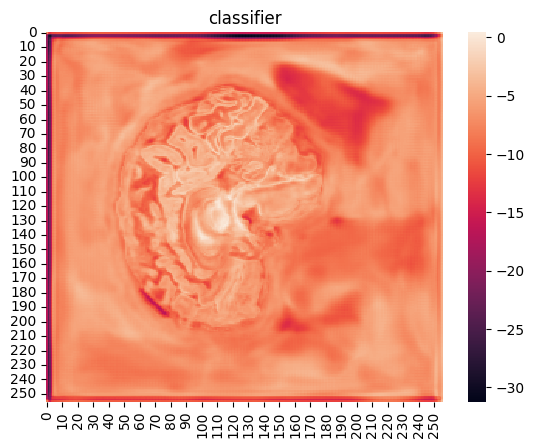

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in ['encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'classifier']:
    
    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanconv_threshold/ieee_{i}_6.pkl', 'rb'))

    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0))
    gc.set_title(i)
    plt.figure()


#### Threshold 0.2

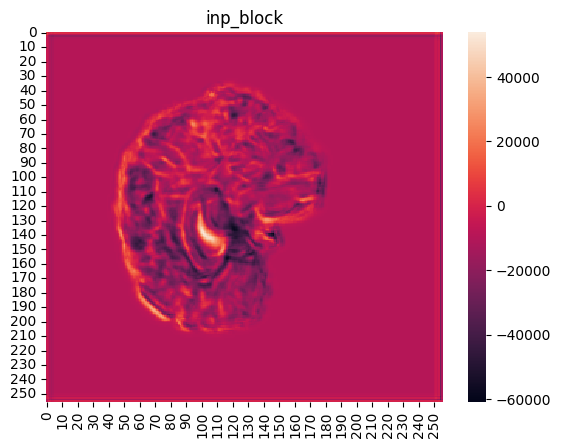

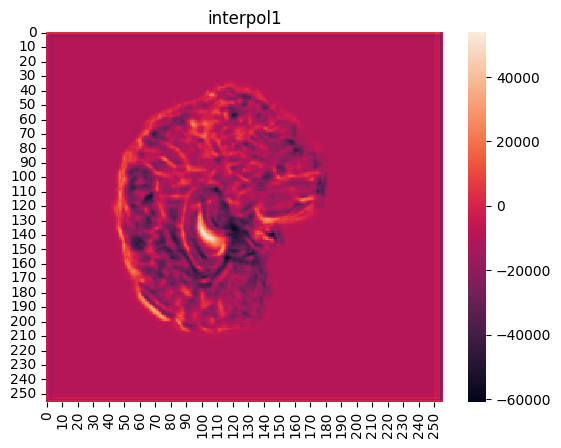

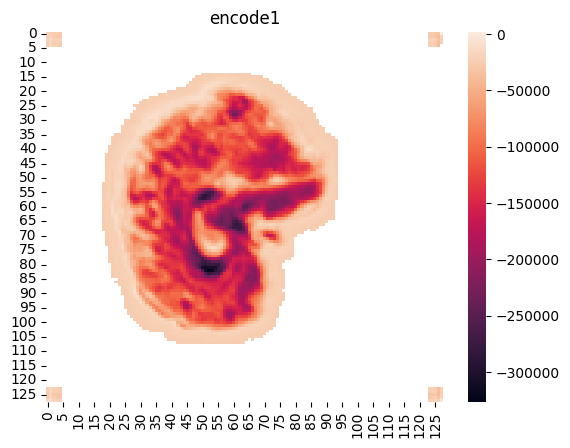

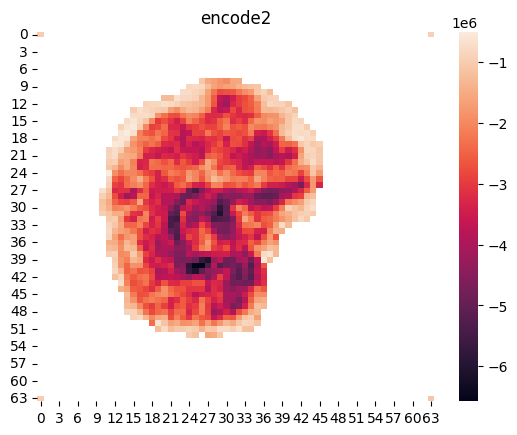

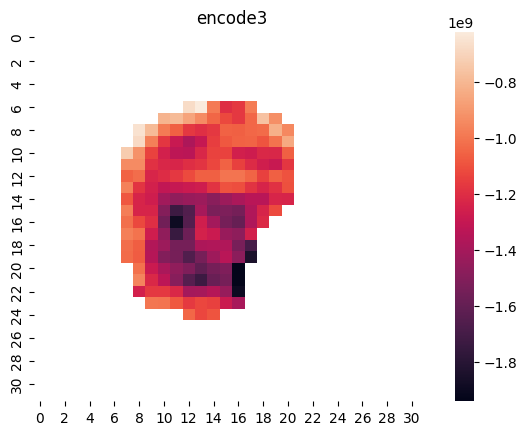

...

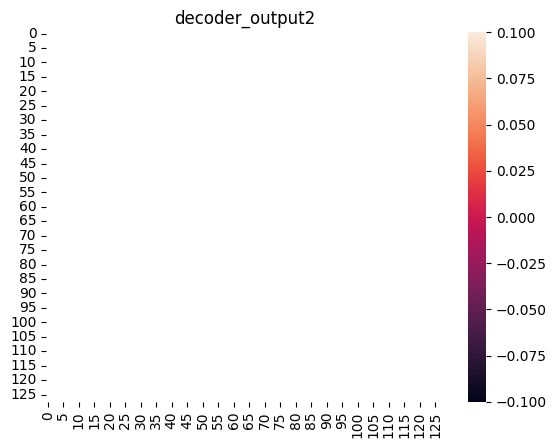

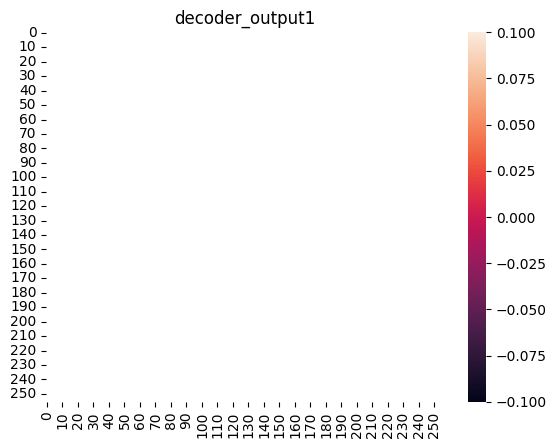

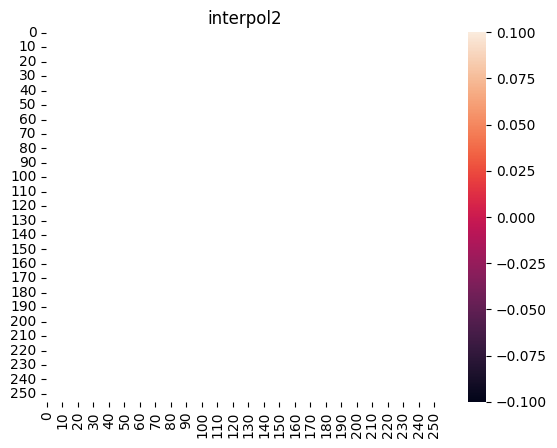

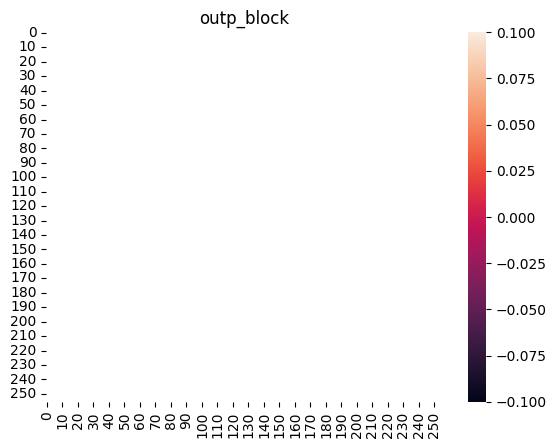

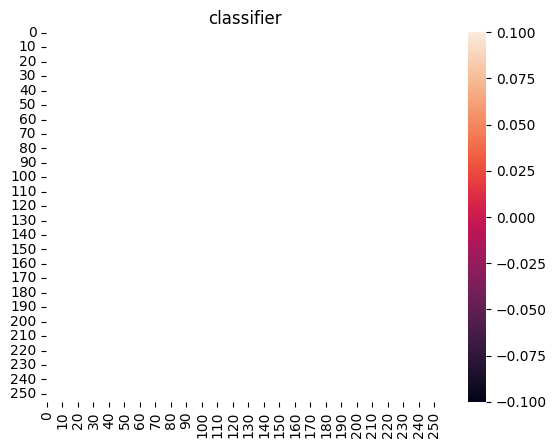

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in ['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'interpol2', 'outp_block', 'classifier']:
    
    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanconv_threshold/0.2_{i}_2.pkl', 'rb'))

    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0))
    gc.set_title(i)
    plt.figure()


#### Threshold 0.5

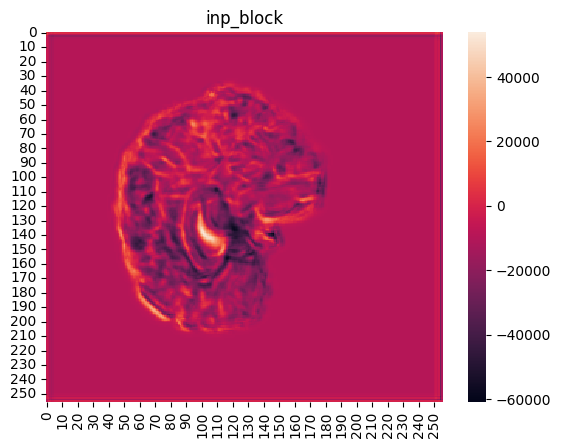

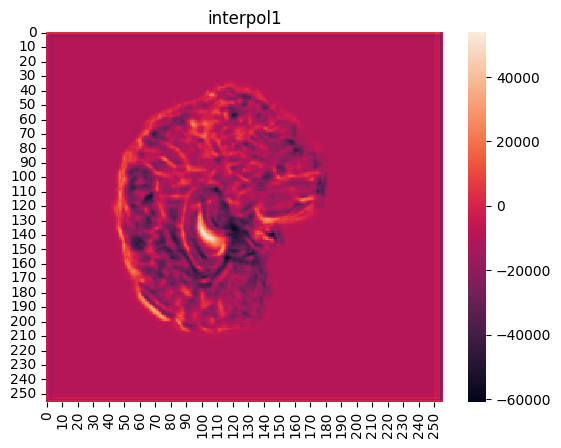

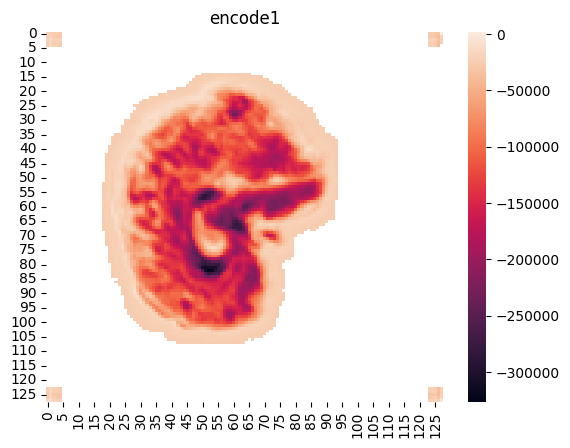

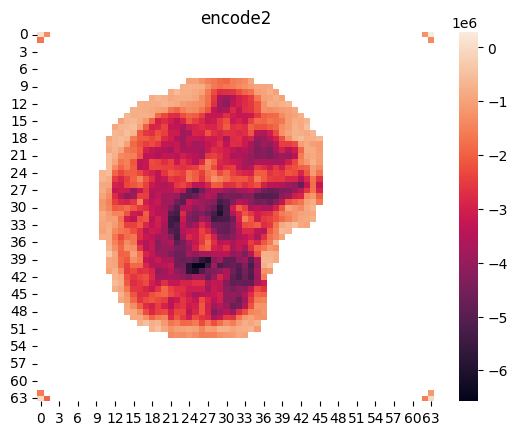

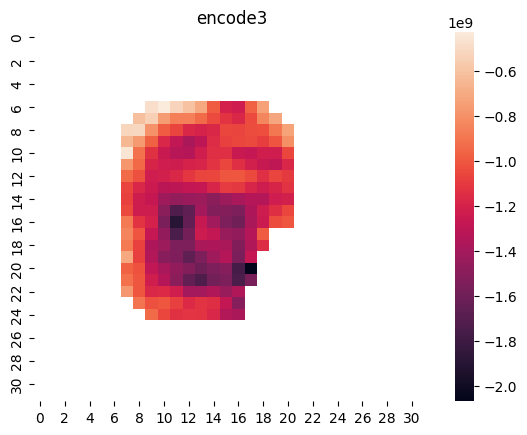

...

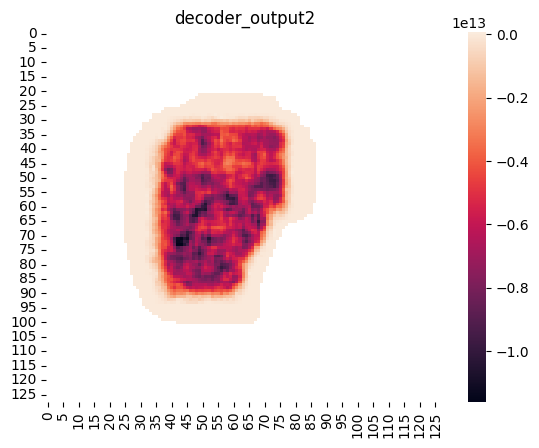

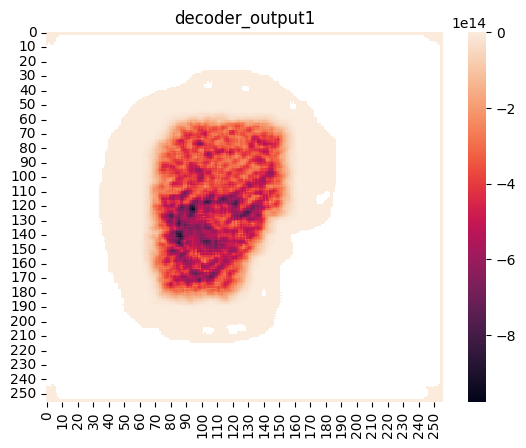

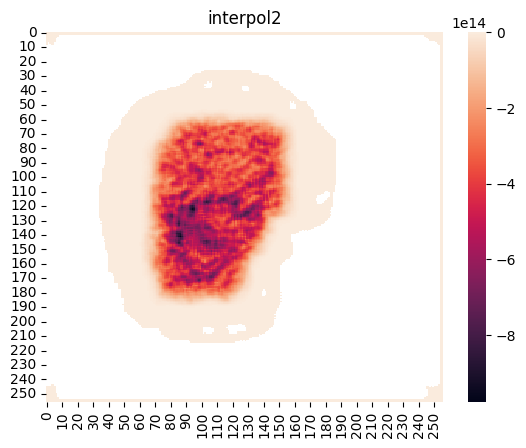

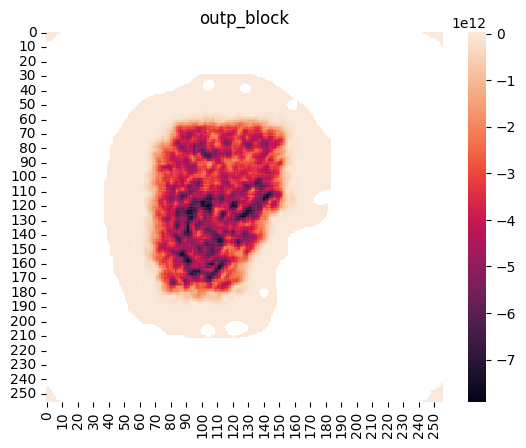

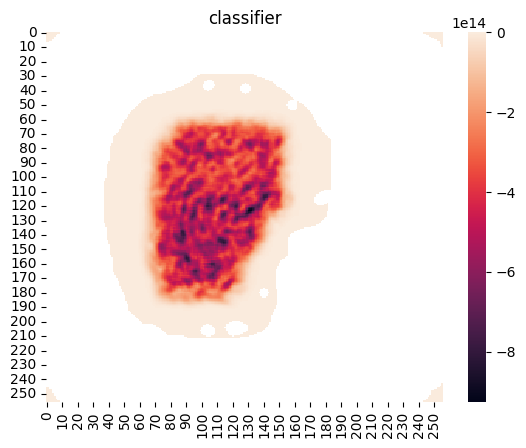

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in ['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'interpol2', 'outp_block', 'classifier']:
    
    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanconv_threshold/0.5_{i}_3.pkl', 'rb'))

    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0))
    gc.set_title(i)
    plt.figure()


#### Threshold 0.8

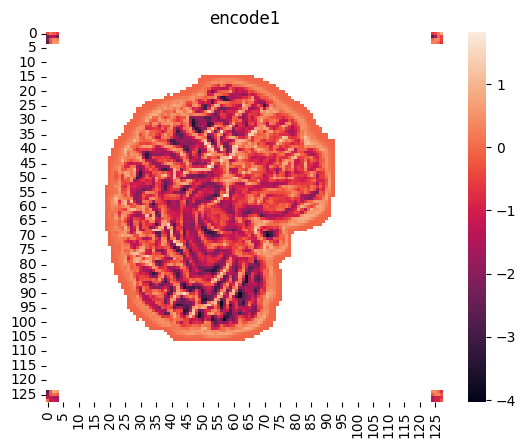

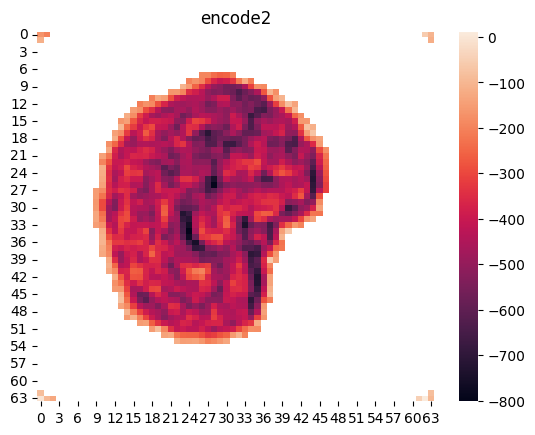

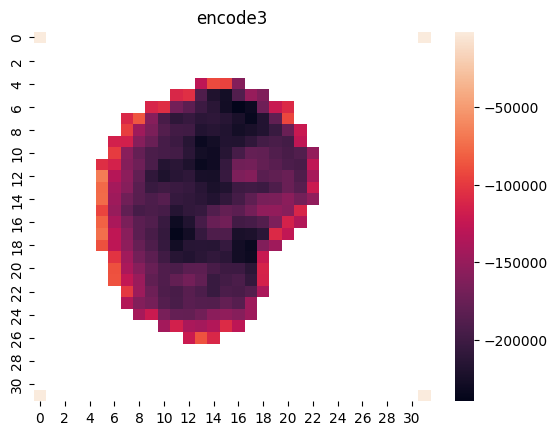

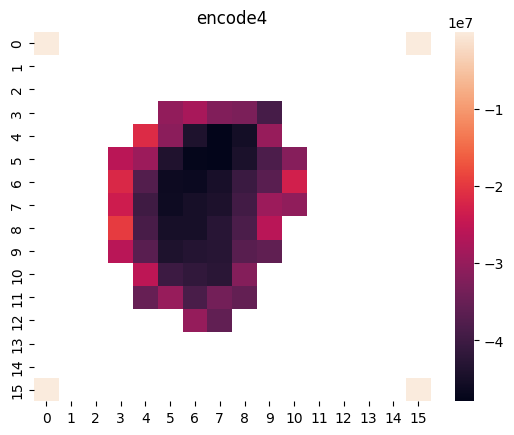

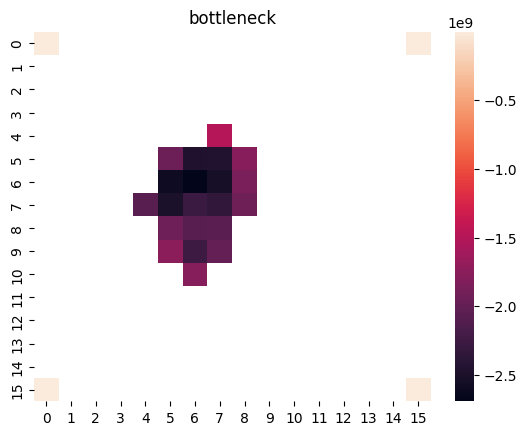

...

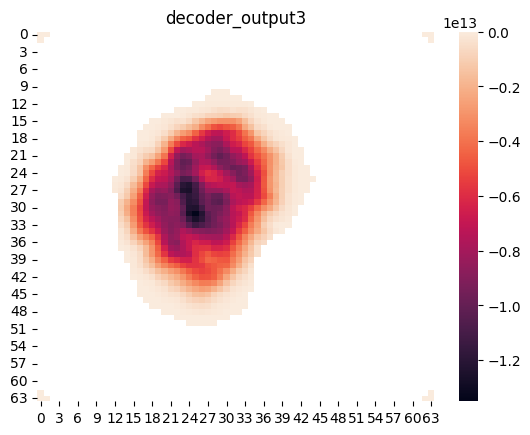

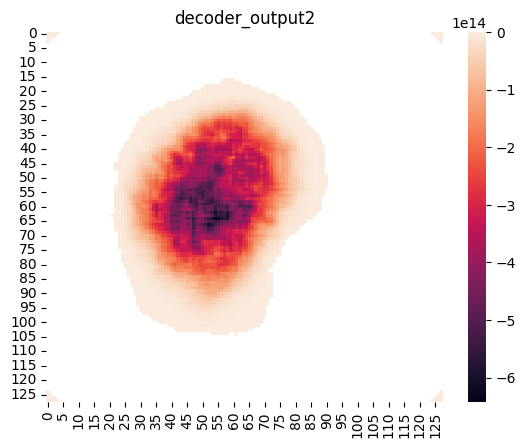

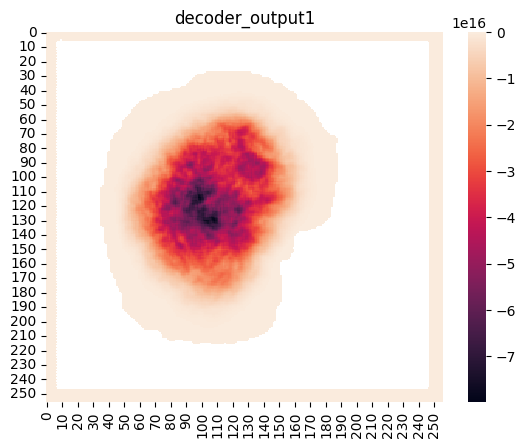

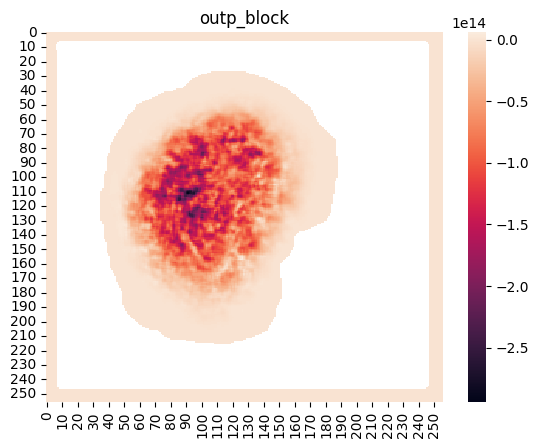

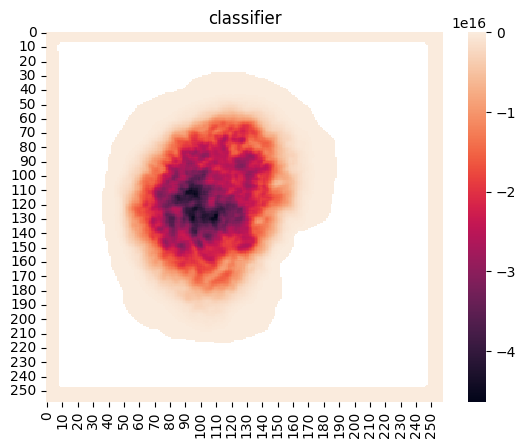

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in ['encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'outp_block', 'classifier']:
    
    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanconv_threshold/0.8_{i}_5.pkl', 'rb'))

    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0))
    gc.set_title(i)
    plt.figure()


#### Threshold 1

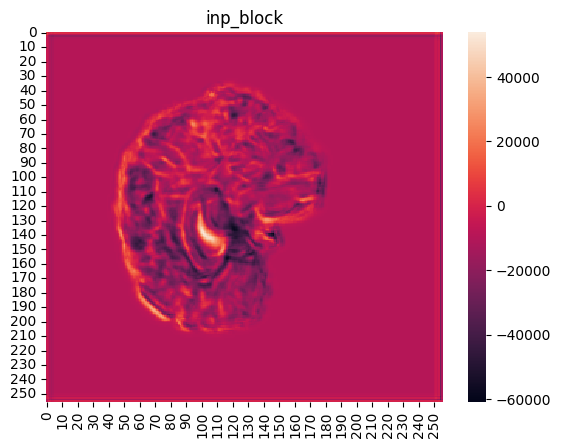

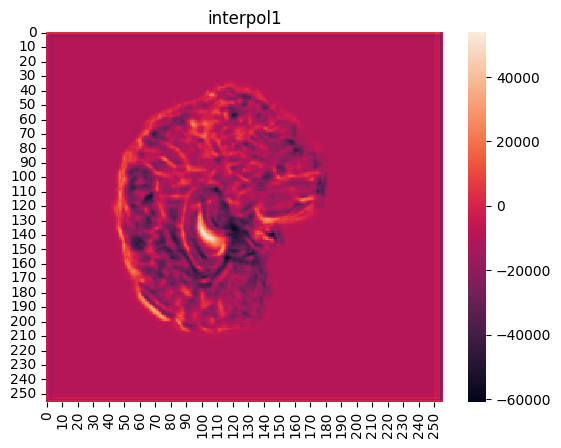

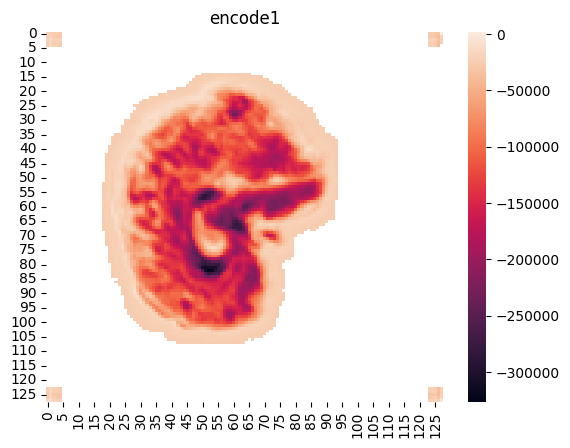

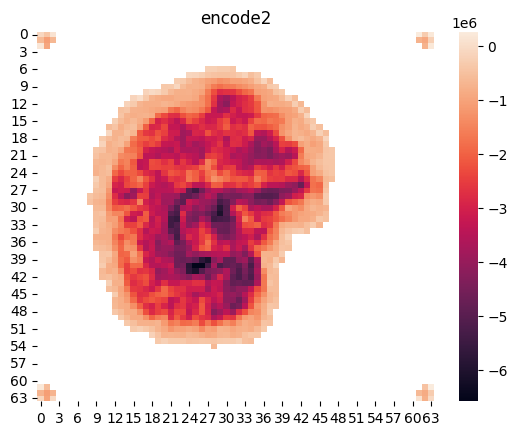

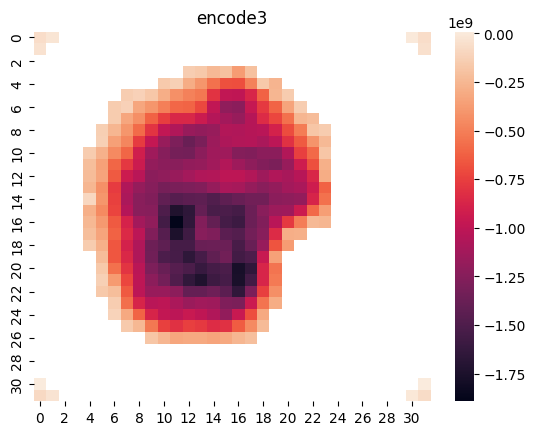

...

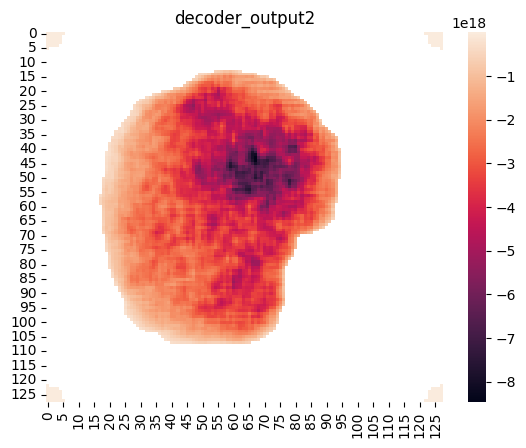

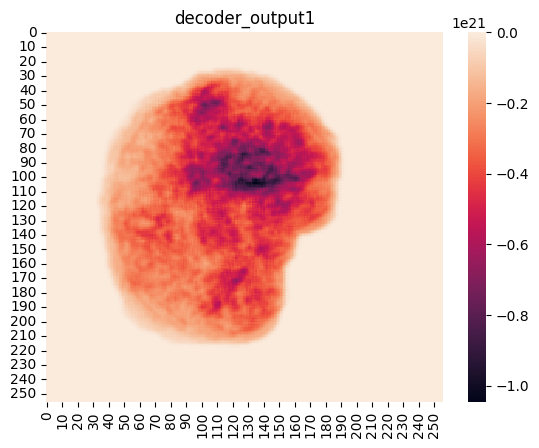

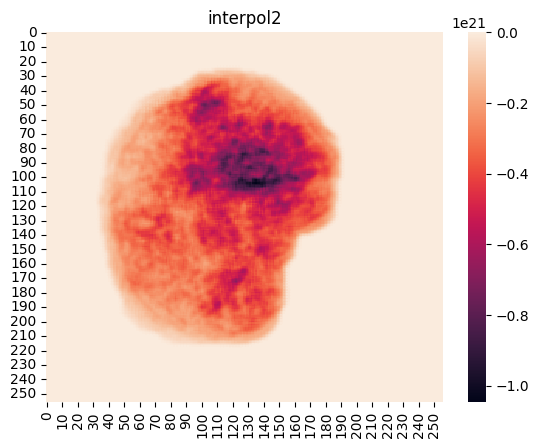

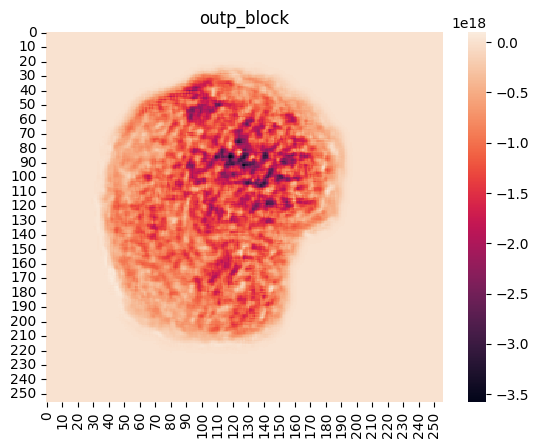

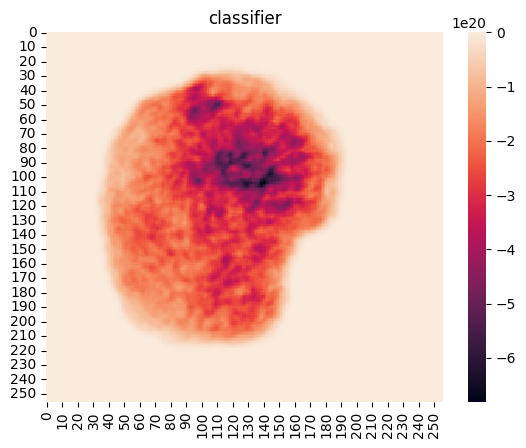

<Figure size 640x480 with 0 Axes>

In [ ]:
for i in ['inp_block', 'interpol1', 'encode1', 'encode2', 'encode3', 'encode4', 'bottleneck', 'decoder_output4', 'decoder_output3', 'decoder_output2', 'decoder_output1', 'interpol2', 'outp_block', 'classifier']:
    
    # a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanconv_threshold/1_{i}_4.pkl', 'rb'))
    a=pickle.load(open(f'/scratch/ine5/fastsurfer_embeddings/results/sub-0025531_nanconv_threshold1/1_{i}_1.pkl', 'rb'))

    # print(a.shape)
    # break
    # gc = sns.heatmap(a.detach().numpy().squeeze()[0, :,:])
    gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0))
    gc.set_title(i)
    plt.figure()
